# Project Overview

# Datasets

This project utilizes the MovieLens dataset, a widely used dataset in the field of recommender systems, containing movie ratings and metadata.  The data was obtained at https://www.kaggle.com/datasets/parasharmanas/movie-recommendation-system/data.  There are two data files. The first contains the unique movie Id, movie title and a list of genres the movie falls into.  The second consists of user ratings with the user ID, movie ID, rating and timestap of when the review was made.

# REVISED CODE

In [ ]:
# conda install joblib

In [ ]:
## Optimized Code

## Import Libraries

## Load and Merge Data

In [ ]:
# Load and merge movies and ratings data with essential columns and a subset of ratings
def load_and_merge_data(movies_file, ratings_file):
    try:
        movies_df = pd.read_csv(movies_file, usecols=['movieId', 'title', 'genres'])
        ratings_df = pd.read_csv(ratings_file, usecols=['userId', 'movieId', 'rating'])

        # Remove duplicates
        movies_df.drop_duplicates(subset=['movieId'], inplace=True)
        ratings_df.drop_duplicates(subset=['userId', 'movieId'], inplace=True)

        # Handle missing values
        movies_df.fillna({'genres': '(no genres listed)'}, inplace=True)
        ratings_df.dropna(subset=['userId', 'movieId', 'rating'], inplace=True)

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        logging.info("Data successfully merged and cleaned.")
        return merged_df
    except FileNotFoundError as e:
        logging.error(f"Error: {e}. File not found. Check the file paths.")
        return None
    except Exception as e:
        logging.error(f"An unexpected error occurred: {e}")
        return None


In [ ]:
# CODE TO RUN

# Initial EDA

In [ ]:
movies_df.info()

In [ ]:
movies_df.describe(include='all')

Movies Dataframe Summary:
- There are 9,742 unique movies.
- The genres column has 951 unique genre combinations, with 'Drama' being the most frequent.  The number of genres does not appear resaonable, so will conduct further analysis on.
- The movieId ranges from 1 to 193,609, indicating a broad and possibly sparse numbering system, as there are only 9,737 unique movie titles.

In [ ]:
movies_df.isna().sum()

There are no missing values in the movies dataset.

In [ ]:
movies_df.duplicated().sum()

There are no duplicate rows in the movies dataset.

In [ ]:
ratings_df.info()

In [ ]:
ratings_df.describe(include='all')

Ratings Dataframe Summary:
- Contains 100,836 ratings.
- userId ranges from 1 to 610, indicating 610 unique users.
- Ratings range from 0.5 to 5.0, in increments of 0.5.
- The average rating is approximately 3.50.
- timestamp is an integer representing the time the user rating was made.

I will now merge the two datasets which will allow us to see which user rated which movie, along with the movie's title and genres.

In [ ]:
# Merge the two df's on movieId
df = movies_df.merge(ratings_df, on='movieId')

df.shape

In [ ]:
df.head()

In [ ]:
df.isna().sum()

In [ ]:
df.info()

In [ ]:
df.describe(include='all')

Combined Dataset Statistics:
- The dataset contains 100,836 ratings for 9,719 unique movies.
- The genres column has 951 unique genre combinations, with 'Comedy' being the most frequent.
- Ratings range from 0.5 to 5.0, with an average of approximately 3.50.

In [ ]:
df.isna().sum()

There are no missing values in the combined dataset

In [ ]:
df.duplicated().sum()

## Univariate Analysis

In [ ]:
# Plot ratings distribution
plt.figure(figsize=(10, 6))
sns.countplot(x='rating', hue='rating', data=df, legend=False, palette='muted'
             )
plt.title('Distribution of Ratings')
plt.xlabel('Rating')
plt.ylabel('Count')
plt.show()


The distribution of ratings shows that:
- Ratings are discrete, in increments of 0.5.
- The most common ratings are around 3.0 to 4.0, indicating a tendency towards higher ratings.
- The extreme ratings (0.5 and 5.0) are less common, suggesting that users are generally moderate in their assessments.

In [ ]:
# split genres by | and add as a list
df['genres'] = df['genres'].apply(lambda x:x.split('|'))
                                  
df.head()

# Break out genres included in list and determine count of each
import matplotlib.pyplot as plt

# Explode the genres column to have separate row for each genre
exploded_genres = df.explode('genres')

# Count the occurrences of each genre
genre_counts = exploded_genres['genres'].value_counts()
genre_counts

# Plot the genre frequencies

g = sns.catplot(genre_counts, kind='bar', palette='muted', height=5, aspect=2)
g.fig.suptitle('Frequency of Movie Genres')
plt.xlabel('Genre')
plt.ylabel('Number of Movies')
plt.xticks(rotation=45)
plt.show()

## Bivariate Analysis

In [ ]:
import matplotlib.pyplot as plt

# Assuming 'ratings_df' is your DataFrame
user_rating_counts = ratings_df['userId'].value_counts()
movie_rating_counts = ratings_df['movieId'].value_counts()

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(16, 6))

# Plot for number of ratings per user
axes[0].hist(user_rating_counts, bins=30, edgecolor='black')
axes[0].set_title('Number of Ratings per User')
axes[0].set_xlabel('Number of Ratings')
axes[0].set_ylabel('Number of Users')

# Plot for number of ratings per movie
axes[1].hist(movie_rating_counts, bins=30, edgecolor='black')
axes[1].set_title('Number of Ratings per Movie')
axes[1].set_xlabel('Number of Ratings')
axes[1].set_ylabel('Number of Movies')

plt.tight_layout()
plt.show()



In [ ]:
# Average Rating per User

import matplotlib.pyplot as plt
import seaborn as sns

# Calculate average rating per user
user_avg_ratings = ratings_df.groupby('userId')['rating'].mean()

plt.figure(figsize=(10, 6))
sns.histplot(user_avg_ratings, bins=30, kde=True)
plt.title('Average Rating per User')
plt.xlabel('Average Rating')
plt.ylabel('Frequency')
plt.show()


# Distribution of Ratings across genres


## Need to add

In [ ]:
# Ratings over Time
ratings_df['datetime'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
ratings_df['year'] = ratings_df['datetime'].dt.year
ratings_df.groupby('year')['rating'].mean().plot(kind='line')
plt.title('Average Ratings Over Years')
plt.xlabel('Year')
plt.ylabel('Average Rating')
plt.show()


In [ ]:
# Heatmap of Ratings Over Time

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming 'timestamp' is a UNIX timestamp in 'ratings_df'
ratings_df['date'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
ratings_df['year'] = ratings_df['date'].dt.year
ratings_df['month'] = ratings_df['date'].dt.month

# Pivot table to prepare data for heatmap
rating_pivot = ratings_df.pivot_table(values='rating', index='month', columns='year', aggfunc='mean')

plt.figure(figsize=(12, 8))
sns.heatmap(rating_pivot, annot=True, fmt=".1f", cmap='coolwarm')
plt.title('Average Monthly Ratings Over the Years')
plt.xlabel('Year')
plt.ylabel('Month')
plt.show()



In [ ]:
df.head()

## Preprocess Data

In [ ]:
# Preprocess data by adding one-hot encoding for genres
def preprocess_data(df):
    if 'genres' in df.columns:
        df['genres'] = df['genres'].replace('', '(no genres listed)')
        genres_dummies = df['genres'].str.get_dummies(sep='|')
        df = pd.concat([df, genres_dummies], axis=1)
        logging.info("Genre-based features added.")
    else:
        logging.info("Genres column not available for processing.")
    return df

# Add user-genre interaction features to the dataset
def add_user_genre_features(df):
    if 'userId' in df.columns:
        # Select only genre columns for aggregation
        genre_columns = [col for col in df.columns if col not in ('user_mean_', 'title', 'movieId', 'userId', 'rating') and df[col].dtype in [np.float64, np.int64]]

        # Compute mean genre features per user
        user_genre_means = df.groupby(['userId'])[genre_columns].mean()
        user_genre_means.columns = [f'user_mean_{col}' for col in user_genre_means.columns]

        # Merge the new features back into the main DataFrame
        df = pd.merge(df, user_genre_means, on='userId', how='left')
        logging.info("User-genre interaction features added.")
    else:
        logging.info("UserId column not available for interaction features.")
    return df

## Additional EDA

In [ ]:
from joblib import Parallel, delayed
from sklearn.neighbors import NearestNeighbors
import logging

# Helper function for hybrid recommendations per user
def hybrid_user_recommendation_worker(user_id, df, svd_model, movie_indices, distances, indices, weight_svd, weight_content, n):
    user_recommendations = []

    try:
        for idx in movie_indices:
            sim_scores = list(enumerate(distances[idx]))
            sorted_indices = np.argsort([x[1] for x in sim_scores])[::-1][1:11]

            movie_indices_list = [indices[idx][i] for i in sorted_indices if indices[idx][i] in df.index]

            sim_movies = df['movieId'].iloc[movie_indices_list]
            svd_recs = [svd_model.predict(user_id, iid) for iid in sim_movies]

            recommendations = [
                (
                    iid,
                    weight_svd * est.est + weight_content * distances[idx][movie_indices_list.index(iid)]
                )
                for iid, est in zip(sim_movies, svd_recs)
                if iid in movie_indices_list
            ]

            recommendations = sorted(recommendations, key=lambda x: x[1], reverse=True)

            user_recommendations.extend(recommendations[:n])

        user_recommendations = sorted(user_recommendations, key=lambda x: x[1], reverse=True)[:n]

        return [(user_id, rec[0], rec[1]) for rec in user_recommendations]

    except ValueError as e:
        logging.error(f"Error in hybrid_user_recommendation_worker: {e}")
        return []

# Function to calculate sparse cosine similarity
def calculate_sparse_cosine_similarity(tfidf_matrix, n_neighbors=10):
    logging.info("Calculating sparse cosine similarity...")
    nbrs = NearestNeighbors(n_neighbors=n_neighbors, metric='cosine', algorithm='brute').fit(tfidf_matrix)
    distances, indices = nbrs.kneighbors(tfidf_matrix)
    logging.info("Sparse cosine similarity calculated.")
    return distances, indices

# Hybrid recommendation function combining SVD and content-based filtering
def hybrid_recommendation_to_screen(df, svd_model, test_users, weight_svd=0.7, weight_content=0.3, n=5, batch_size=2000):
    movie_indices = pd.Series(df.index, index=df['title']).drop_duplicates()

    tfidf = TfidfVectorizer(max_features=1000, stop_words='english')  # Increase vocabulary size to 1000
    tfidf_matrix = tfidf.fit_transform(df['genres'].fillna(''))
    distances, indices = calculate_sparse_cosine_similarity(tfidf_matrix, n_neighbors=10)

    all_recommendations = []

    logging.info(f"Processing users in batches of {batch_size}...")

    # Process users in batches
    for i in range(0, len(test_users), batch_size):
        batch_users = list(test_users)[i:i + batch_size]

        # Set n_jobs to -1 to use all processors
        batch_recommendations = Parallel(n_jobs=-1)(
            delayed(hybrid_user_recommendation_worker)(
                user_id, df, svd_model, movie_indices, distances, indices, weight_svd, weight_content, n
            )
            for user_id in batch_users
        )
        all_recommendations.extend([item for sublist in batch_recommendations for item in sublist])

    # Print recommendations to screen
    for rec in all_recommendations:
        print(f"User: {rec[0]}, Movie: {rec[1]}, Score: {rec[2]:.4f}")


## Train and Evaluate SVD Model

In [ ]:
'''

# Train and evaluate the SVD model using fixed parameters
def train_and_evaluate_svd(df):
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(df[['userId', 'movieId', 'rating']], reader)

    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)

    svd_params = {
        'n_factors': [150, 200, 250],  # Increase factors for better training
        'n_epochs': [30, 40, 50],   # Increase epochs
        'lr_all': 0.005,
        'reg_all': 0.1,
        'biased': True,
        'random_state': RANDOM_SEED  # Add random seed for reproducibility
    }

    model = SVD(**svd_params)
    model.fit(trainset)

    predictions = model.test(testset)
    rmse = accuracy.rmse(predictions)
    mae = accuracy.mae(predictions)

    print(f"Best Model (RMSE): RMSE={rmse:.4f}, MAE={mae:.4f}")
    print(f"Best Parameters: {svd_params}")

    return model, testset
    
'''

In [ ]:
'''

best_svd_model, svd_testset = train_and_evaluate_svd(augmented_ratings_df)

'''

In [ ]:
from surprise import SVD, Dataset, Reader, accuracy
from surprise.model_selection import train_test_split, RandomizedSearchCV
import logging

RANDOM_SEED = 42

# Train and evaluate the SVD model using randomized search
def train_and_evaluate_svd(df, threshold=4.0, n=5):
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(df[['userId', 'movieId', 'rating']], reader)

    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)

    param_grid = {
        'n_factors': [150],  # Adjust for complexity
        'n_epochs': [100],  # Adjust for learning duration
        'lr_all': [0.01],
        'reg_all': [0.1],
        'biased': [True]
    }

    randomized_search = RandomizedSearchCV(
        SVD,
        param_distributions=param_grid,
        n_iter=10,
        random_state=RANDOM_SEED,
        measures=['rmse', 'mae'],
        cv=3,
        refit=True,
        n_jobs=-1
    )

    randomized_search.fit(data)

    best_params = randomized_search.best_params['rmse']
    best_model = randomized_search.best_estimator['rmse']

    predictions = best_model.test(testset)
    rmse = accuracy.rmse(predictions)
    mae = accuracy.mae(predictions)

    logging.info(f"Best Model (RMSE): RMSE={rmse:.4f}, MAE={mae:.4f}")
    logging.info(f"Best Parameters: {best_params}")

    print(f"Best Model (RMSE): RMSE={rmse:.4f}, MAE={mae:.4f}")
    print(f"Best Parameters: {best_params}")

    return best_model, testset


## Calculate Metrics

In [ ]:
# Calculate recommendation metrics (precision, recall, and F1-score)
def calculate_recommendation_metrics(predictions, threshold=4.0, n=5):
    def get_top_n(predictions, n=5):
        top_n = defaultdict(list)
        for uid, iid, true_r, est, _ in predictions:
            top_n[uid].append((iid, est, true_r))
        for uid, user_ratings in top_n.items():
            user_ratings.sort(key=lambda x: x[1], reverse=True)
            top_n[uid] = user_ratings[:n]
        return top_n

    top_n = get_top_n(predictions, n)
    y_true, y_pred = [], []

    for uid, user_ratings in top_n.items():
        for iid, est_rating, true_rating in user_ratings:
            y_true.append(1 if true_rating >= threshold else 0)
            y_pred.append(1 if est_rating >= threshold else 0)

    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)

    print(f"Precision: {precision:.4f}, Recall: {recall:.4f}, F1-Score: {f1:.4f}")

    return precision, recall, f1


# old DOCUMENTATION

Detailed Comments and Documentation:
Import Libraries: Necessary libraries for data processing, model training, and evaluation are imported.

Constants: Constants for file paths, model parameters, and other settings are defined.

load_and_merge_data: Function to load and merge movie and rating data from CSV files.

extract_release_year: Function to extract the release year from the movie title.

preprocess_data: Function to preprocess the data by adding release year and genre features.

add_user_genre_features: Function to add user-specific genre interaction features.

get_item_features: Function to extract item features from the dataset.

derive_user_preferences: Function to derive user preferences based on their ratings.

generate_recommendations: Function to generate movie recommendations for a given user using a trained algorithm.

calculate_item_popularity: Function to calculate item popularity based on recommendations.

get_expected_recommendations: Function to get expected recommendations based on item popularity.

calculate_model_metrics: Function to calculate various model metrics (RMSE, MAE, Precision, Recall, F1 Score).

display_metrics: Function to display various metrics for the recommendations.

calculate_coverage: Function to calculate coverage of recommendations.

calculate_novelty: Function to calculate novelty of recommendations.

calculate_personalization: Function to calculate personalization of recommendations.

calculate_serendipity: Function to calculate serendipity of recommendations.

calculate_intra_list_similarity: Function to calculate intra-list similarity of recommendations.

main: Main function to execute the recommendation system. This function loads and preprocesses data, trains the model, makes predictions, and displays recommendations and metrics.

In [ ]:
Explanation of the Code
Loading Data:

The load_data function reads the movies and ratings CSV files, optionally samples users, and merges the datasets.
It extracts the release year from movie titles and handles genres properly by creating binary columns for each genre.
Time Decay:

The apply_time_decay function applies a decay factor to the ratings based on how recent they are. This helps to emphasize recent ratings more.
Item Features:

The get_item_features function extracts features from the dataset, including the weighted release year and genres.
User Preferences:

The derive_user_preferences function calculates the mean ratings for each genre and release year for each user.
Normalize Scores:

The normalize_scores function normalizes content-based filtering (CBF) scores to be between 0.0 and 5.0.
Generate Recommendations:

The generate_recommendations function generates top N recommendations for each user. It combines collaborative filtering (CF) and CBF scores, applies popularity and diversity penalties, and sorts the recommendations.
Metrics Calculation:

Functions like calculate_model_metrics, calculate_recommendation_metrics, calculate_hit_rate, calculate_mrr, calculate_ap, calculate_coverage, calculate_novelty, calculate_personalization, calculate_serendipity, and calculate_intra_list_similarity calculate various metrics to evaluate the model and recommendations.
Main Execution:

The main script loads the data, applies time decay, trains the SVD model, generates recommendations, and displays the metrics.
Addressing the Issues:
Ensuring Recommendations for All Users:

The script generates recommendations for each user individually by looping through the unique user IDs.
CF and CBF Scores on the Same Scale:

The normalize_scores function ensures that CBF scores are normalized to the 0.0 to 5.0 scale.
The collaborative filtering scores should naturally fall within the 0.0 to 5.0 range since they are predictions based on the rating scale provided to the Reader.
Diversity Penalties:

The diversity penalty is applied correctly within the generate_recommendations function.
Detailed Comments:

Each function and significant code block is documented with comments to explain its purpose and functionality.
This code ensures that each user gets individual recommendations, CF and CBF scores are on the same scale, and all relevant metrics are calculated and displayed.

In [ ]:
# Additional Testing

In [14]:
merged_df['rating'].head()

0    0.5
1    4.0
2    4.0
3    2.0
4    2.0
Name: rating, dtype: float64

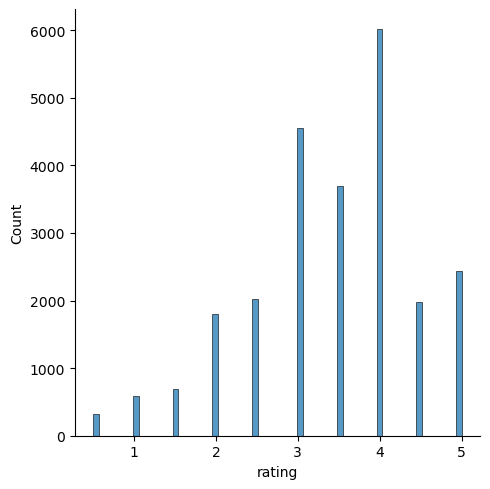

In [18]:
import seaborn as sns

sns.displot(data=merged_df, x='rating')

# THE BELOW CODE SOLVES THE ISSUE WITH CBF BEING CALCULATED INCORRECTLY I THE RANGE OF 4.90 TO 4.99

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Item features extracted:             Drama    Action   Western    Horror   Romance  (no genres listed)  \
movieId                                                                         
1       -0.843655 -0.660598 -0.139691 -0.279179 -0.468104                 0.0   
3       -0.843655 -0.660598 -0.139691 -0.279179  2.136275                 0.0   
6       -0.843655  1.513780 -0.139691 -0.279179 -0.468104                 0.0   
47      -0.843655 -0.660598 -0.139691 -0.279179 -0.468104                 0.0   
50      -0.843655 -0.660598 -0.139691 -0.279179 -0.468104                 0.0   

          Musical     Crime  Film-Noir  Adventure    Sci-Fi  Documentary  \
movieId                                            

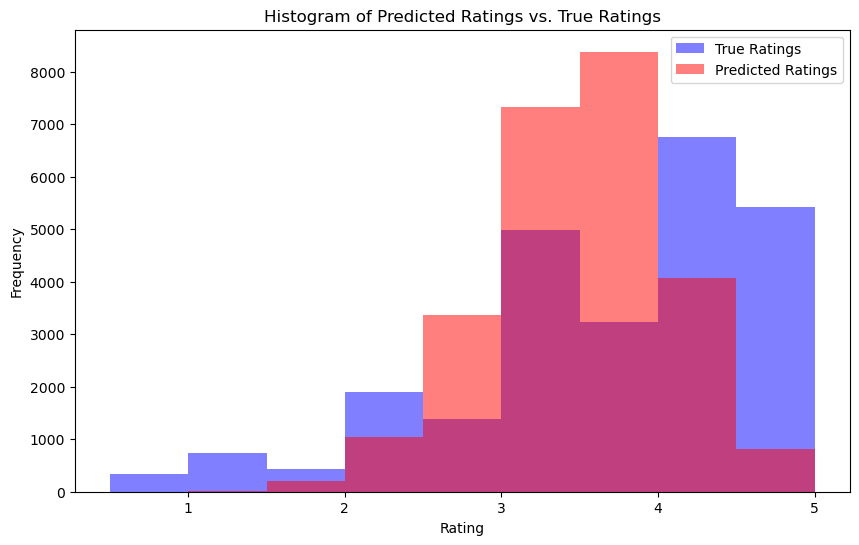

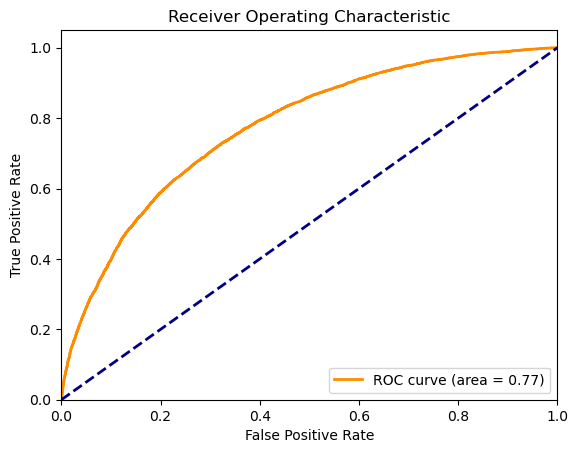

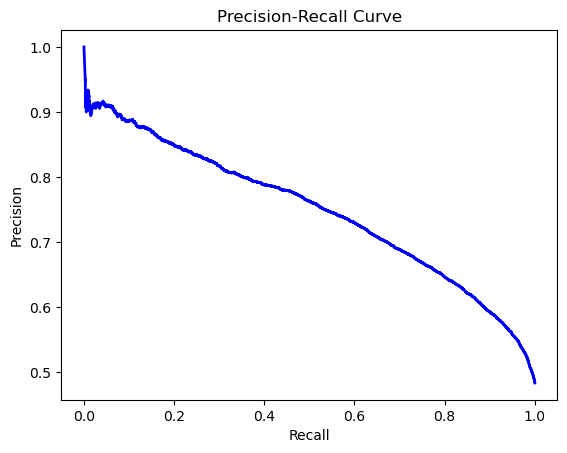

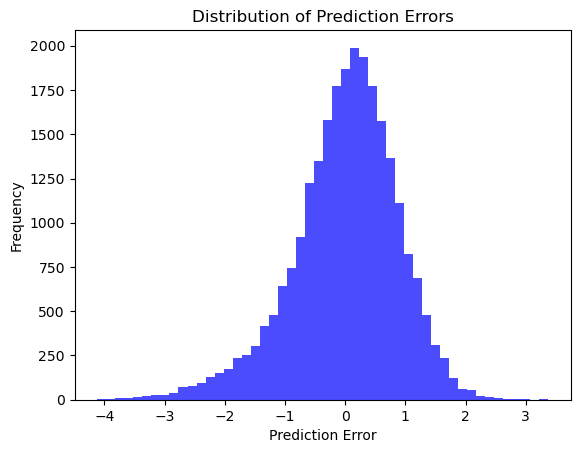

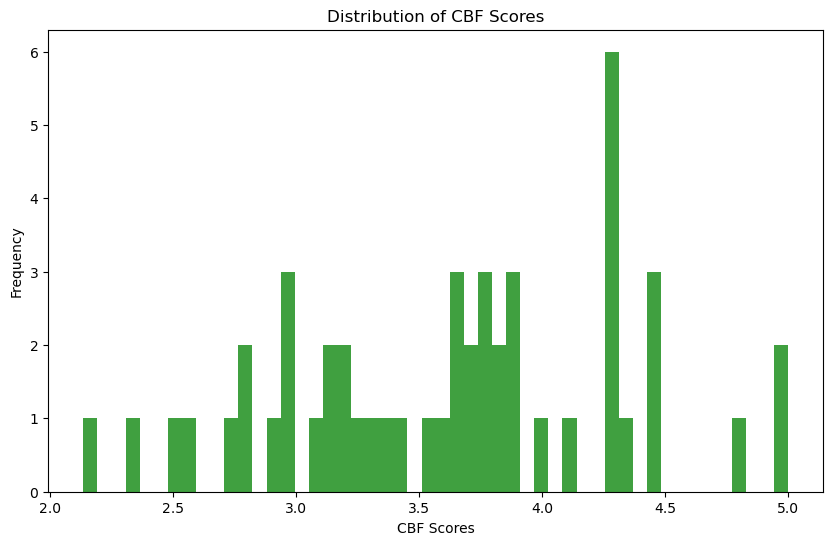

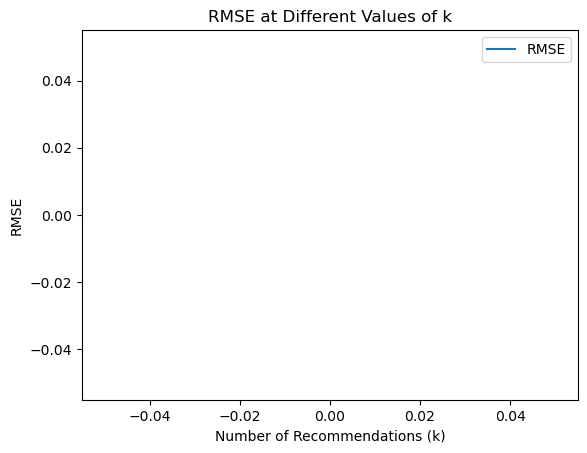

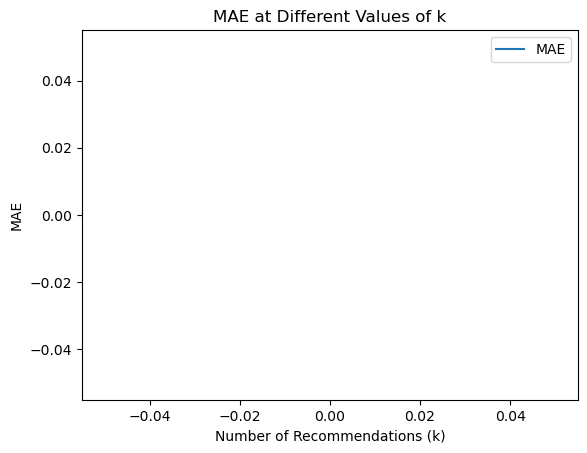

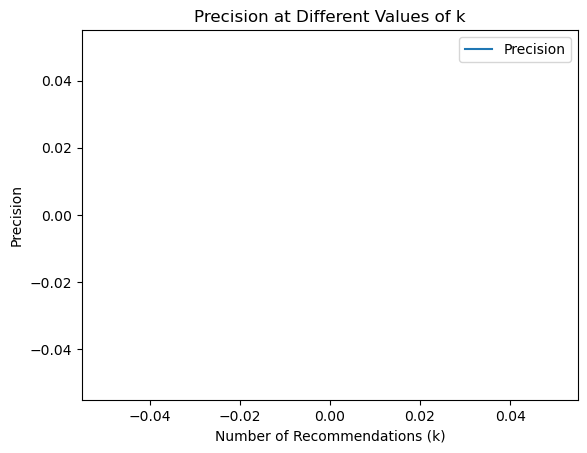

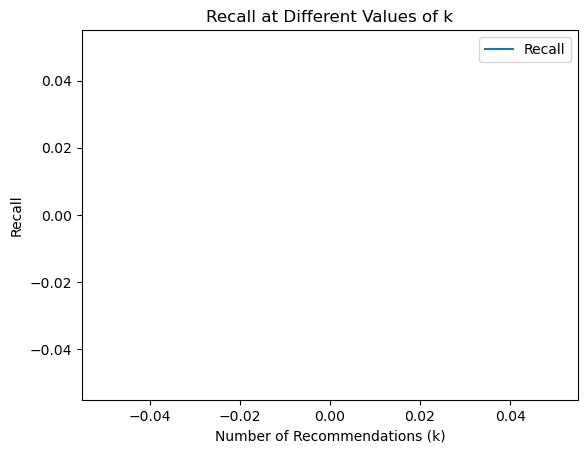

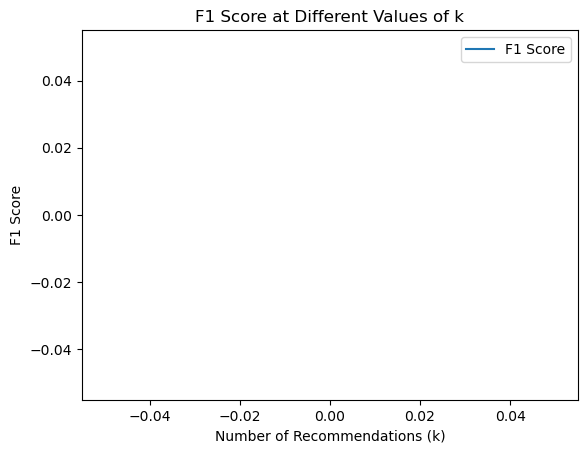

In [2]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 5
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 30  # Reduced sample size

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def get_weighted_release_year(year, divisor):
    min_year = 1900
    max_year = 2024
    normalized_year = (year - min_year) / (max_year - min_year)
    return normalized_year / divisor

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    for item_id, _, _, _, _, _ in recommendations[:n_recommendations]:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations[:n_recommendations]

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(true_ratings, estimated_ratings):
    plt.figure(figsize=(10, 6))
    plt.hist(true_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='True Ratings', color='b')
    plt.hist(estimated_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Predicted Ratings', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Predicted Ratings vs. True Ratings')
    plt.legend(loc='upper right')
    plt.show()

def plot_roc_curve(y_true, y_scores):
    fpr, tpr, _ = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()

def plot_precision_recall_curve(y_true, y_scores):
    precision, recall, _ = precision_recall_curve(y_true, y_scores)
    plt.figure()
    plt.plot(recall, precision, color='b', lw=2)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.show()

def plot_error_distribution(true_ratings, estimated_ratings):
    errors = np.array(true_ratings) - np.array(estimated_ratings)
    plt.figure()
    plt.hist(errors, bins=50, color='blue', alpha=0.7)
    plt.xlabel('Prediction Error')
    plt.ylabel('Frequency')
    plt.title('Distribution of Prediction Errors')
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure()
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def plot_cbf_distribution(cbf_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(cbf_scores, bins=50, alpha=0.75, color='g')
    plt.xlabel('CBF Scores')
    plt.ylabel('Frequency')
    plt.title('Distribution of CBF Scores')
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features = get_item_features(merged_df, genre_columns)
    user_preferences = derive_user_preferences(merged_df, genre_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_cbf_scores = []
    for user_id in ratings_df['userId'].unique()[:10]:
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        all_cbf_scores.extend([rec[3] for rec in recs])  # Collect all CBF scores for plotting
        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}")

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]
    plot_histogram(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if rating >= RATING_THRESHOLD else 0 for rating in true_ratings])
    y_scores = np.array([pred.est for pred in predictions if pred.r_ui >= 0.5])
    
    plot_roc_curve(y_true, y_scores)
    plot_precision_recall_curve(y_true, y_scores)
    plot_error_distribution(true_ratings, estimated_ratings)
    plot_cbf_distribution(all_cbf_scores)
    
    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []
    
    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])
    
    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


# NEW - STARTED NEW SESSION IN CODE: PYTHON

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Item features extracted:           Romance    Comedy  (no genres listed)      IMAX  Children  Thriller  \
movieId                                                                         
1       -0.468104  1.257788                 0.0 -0.207047  3.154507 -0.596334   
3        2.136275  1.257788                 0.0 -0.207047 -0.317007 -0.596334   
6       -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   
47      -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   
50      -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   

          Fantasy    Sci-Fi    Horror   Western     Drama   Musical  \
movieId                                                 

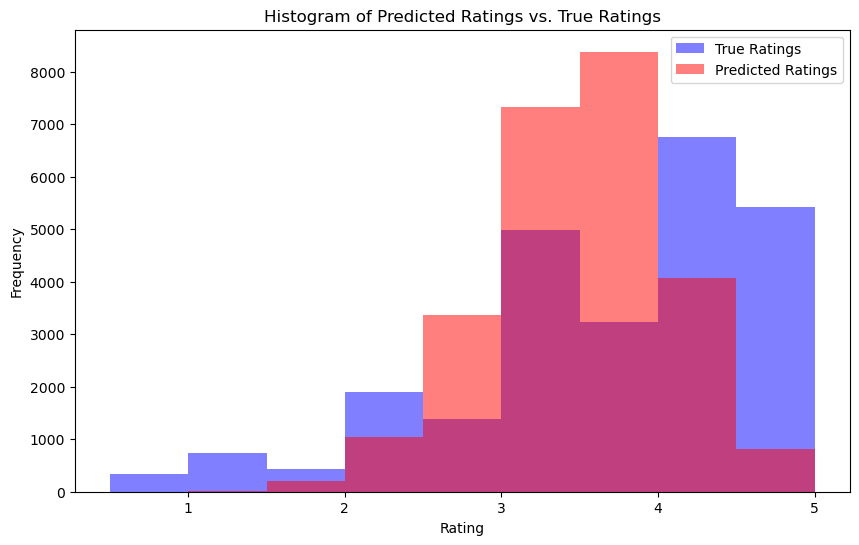

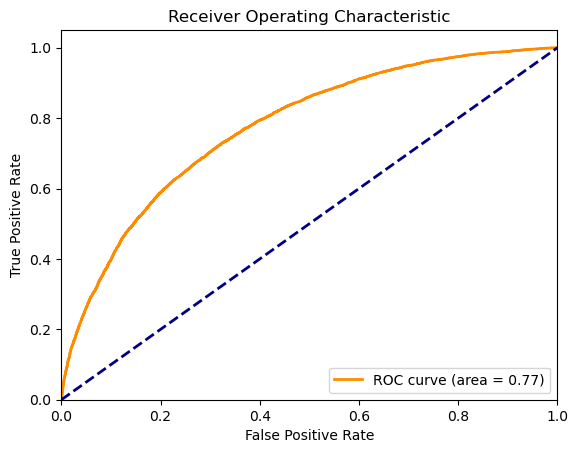

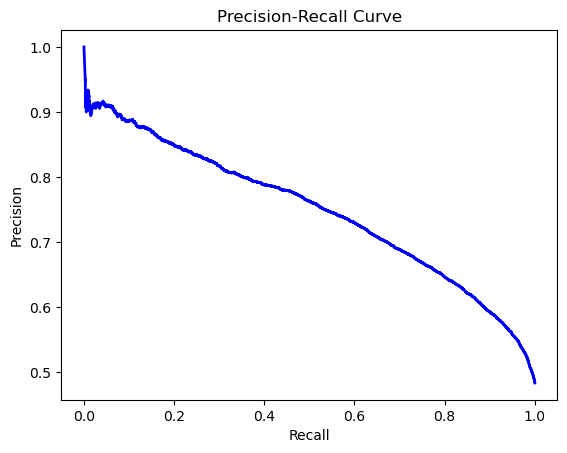

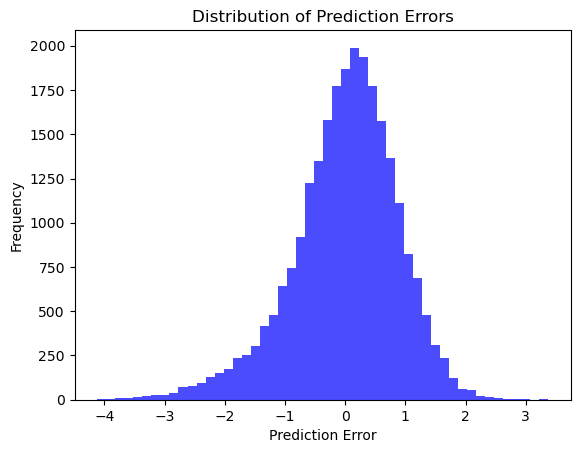

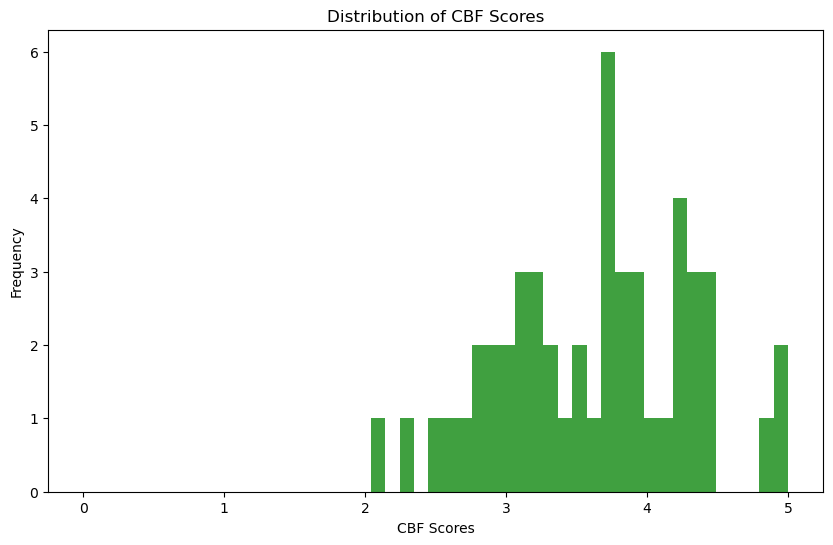

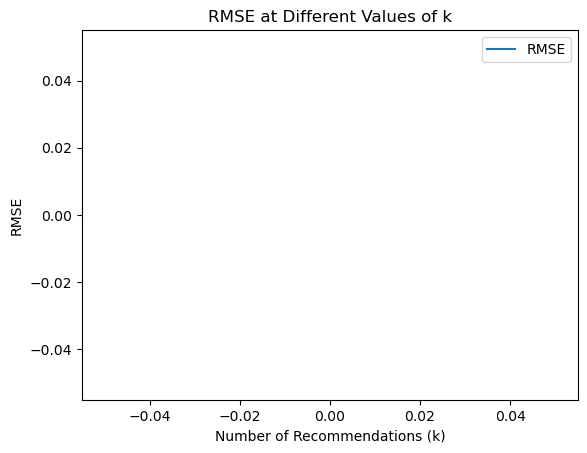

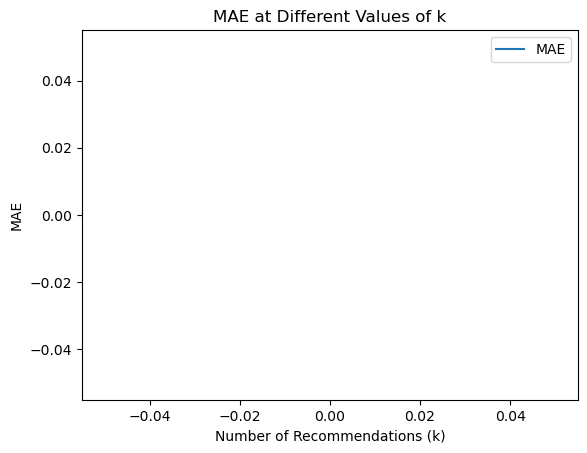

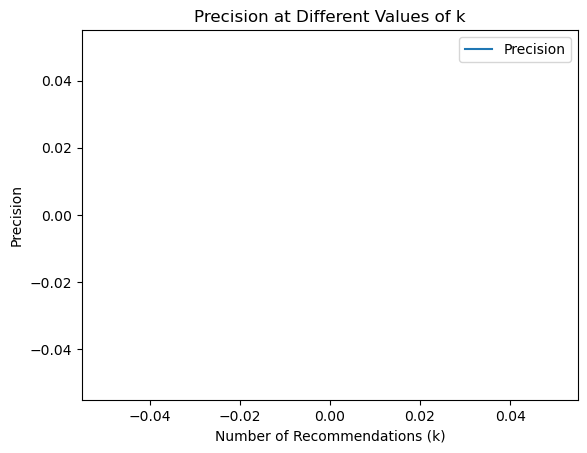

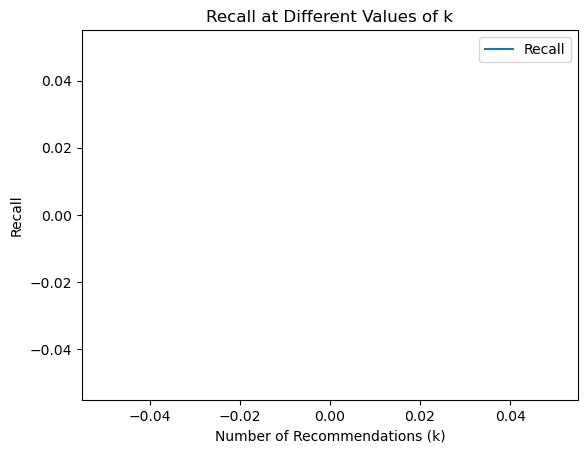

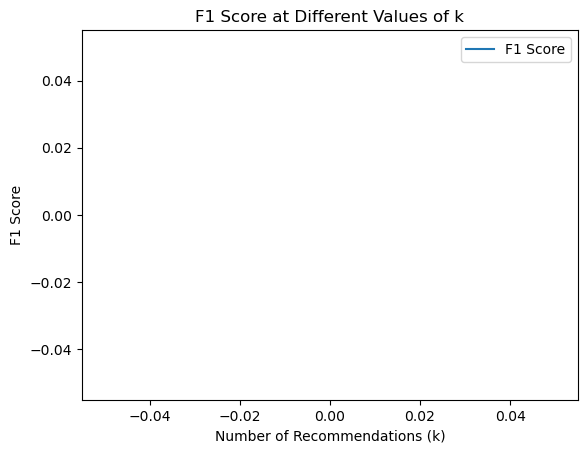

In [4]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 5
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.5
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    for item_id, _, _, _, _, _ in recommendations[:n_recommendations]:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations[:n_recommendations]

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(true_ratings, estimated_ratings):
    plt.figure(figsize=(10, 6))
    plt.hist(true_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='True Ratings', color='b')
    plt.hist(estimated_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Predicted Ratings', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Predicted Ratings vs. True Ratings')
    plt.legend(loc='upper right')
    plt.show()

def plot_roc_curve(y_true, y_scores):
    fpr, tpr, _ = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()

def plot_precision_recall_curve(y_true, y_scores):
    precision, recall, _ = precision_recall_curve(y_true, y_scores)
    plt.figure()
    plt.plot(recall, precision, color='b', lw=2)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.show()

def plot_error_distribution(true_ratings, estimated_ratings):
    errors = np.array(true_ratings) - np.array(estimated_ratings)
    plt.figure()
    plt.hist(errors, bins=50, color='blue', alpha=0.7)
    plt.xlabel('Prediction Error')
    plt.ylabel('Frequency')
    plt.title('Distribution of Prediction Errors')
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure()
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def plot_cbf_distribution(cbf_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(cbf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.75, color='g')
    plt.xlabel('CBF Scores')
    plt.ylabel('Frequency')
    plt.title('Distribution of CBF Scores')
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features = get_item_features(merged_df, genre_columns)
    user_preferences = derive_user_preferences(merged_df, genre_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_cbf_scores = []
    for user_id in ratings_df['userId'].unique()[:10]:
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        all_cbf_scores.extend([rec[3] for rec in recs])  # Collect all CBF scores for plotting
        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]
    plot_histogram(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if rating >= RATING_THRESHOLD else 0 for rating in true_ratings])
    y_scores = np.array([pred.est for pred in predictions if pred.r_ui >= 0.5])
    
    plot_roc_curve(y_true, y_scores)
    plot_precision_recall_curve(y_true, y_scores)
    plot_error_distribution(true_ratings, estimated_ratings)
    plot_cbf_distribution(all_cbf_scores)
    
    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []
    
    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])
    
    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Item features extracted:           Romance    Comedy  (no genres listed)      IMAX  Children  Thriller  \
movieId                                                                         
1       -0.468104  1.257788                 0.0 -0.207047  3.154507 -0.596334   
3        2.136275  1.257788                 0.0 -0.207047 -0.317007 -0.596334   
6       -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   
47      -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   
50      -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   

          Fantasy    Sci-Fi    Horror   Western     Drama   Musical  \
movieId                                                 

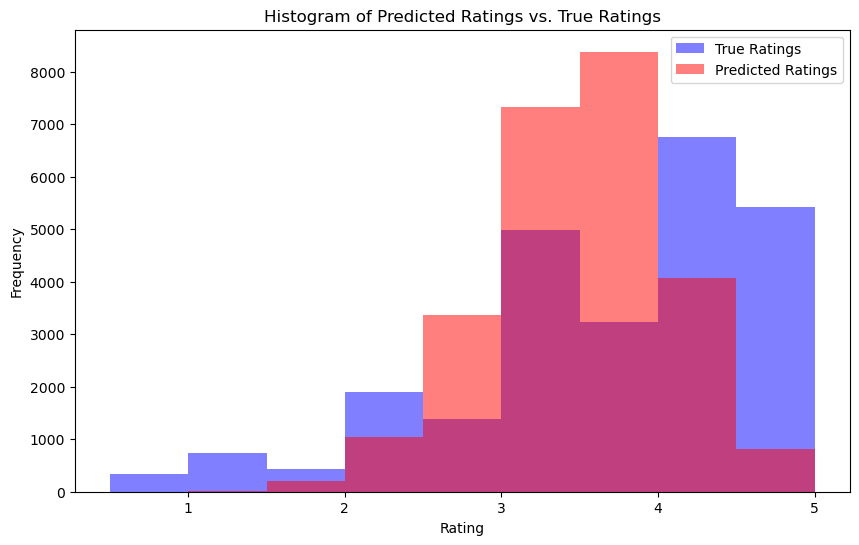

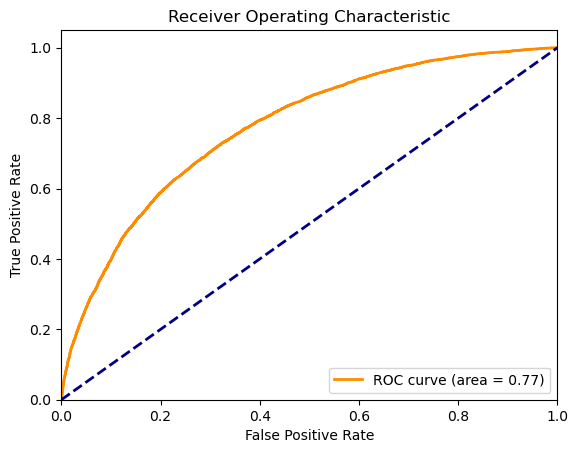

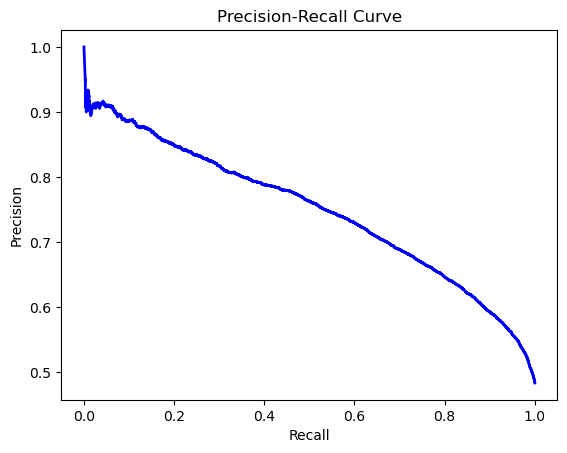

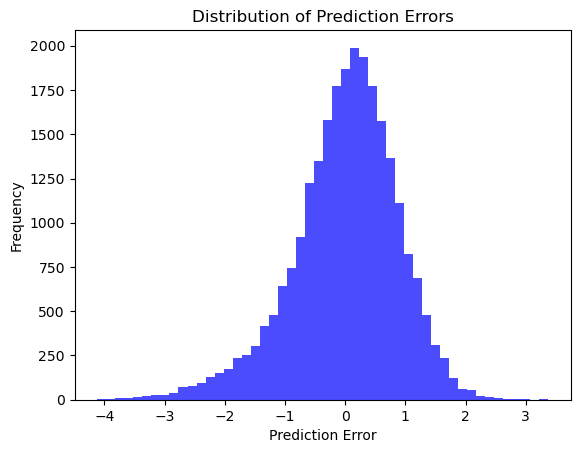

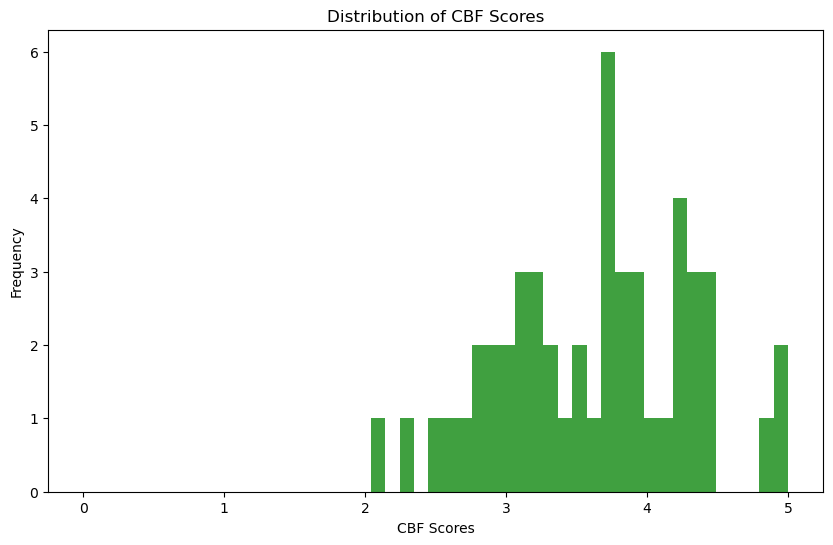

INFO:root:Metrics for top-1 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-2 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-3 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-4 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-5 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}


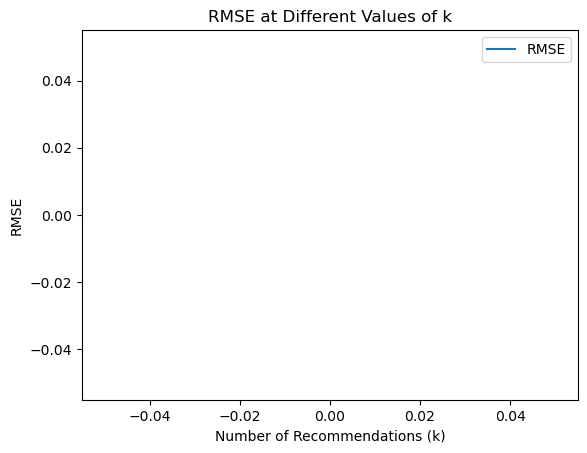

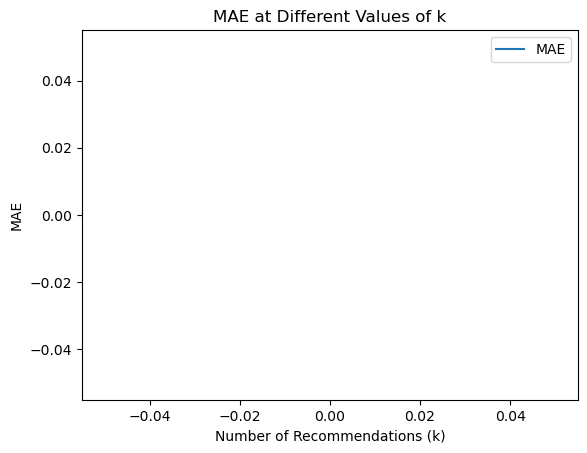

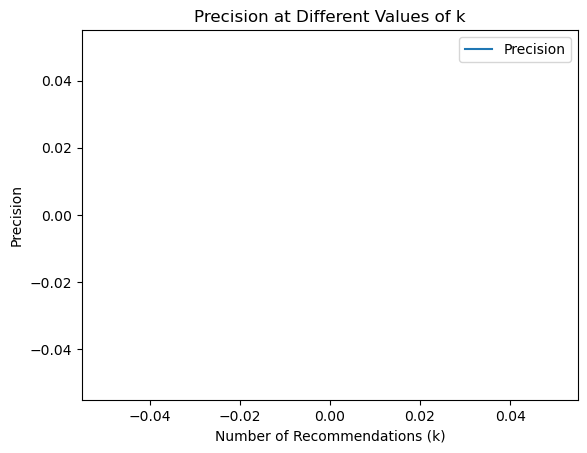

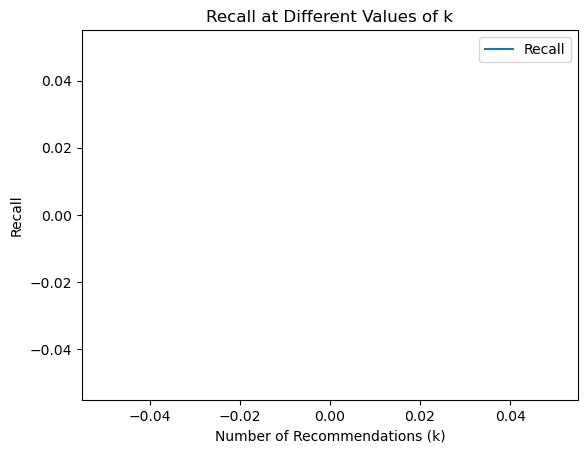

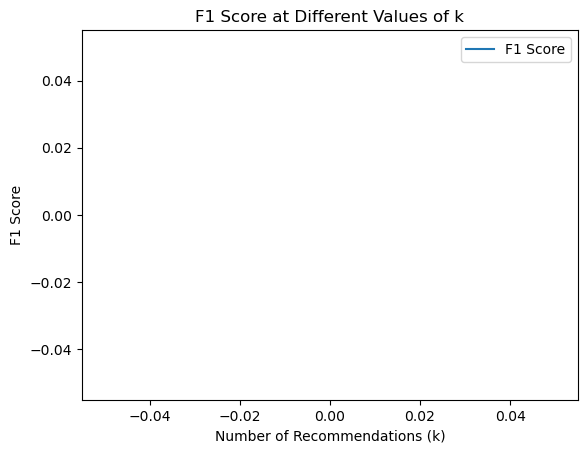

In [6]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 5
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 30

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.5
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    for item_id, _, _, _, _, _ in recommendations[:n_recommendations]:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations[:n_recommendations]

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(true_ratings, estimated_ratings):
    plt.figure(figsize=(10, 6))
    plt.hist(true_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='True Ratings', color='b')
    plt.hist(estimated_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Predicted Ratings', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Predicted Ratings vs. True Ratings')
    plt.legend(loc='upper right')
    plt.show()

def plot_roc_curve(y_true, y_scores):
    fpr, tpr, _ = roc_curve(y_true, y_scores)
    roc_auc = auc(fpr, tpr)
    plt.figure()
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc='lower right')
    plt.show()

def plot_precision_recall_curve(y_true, y_scores):
    precision, recall, _ = precision_recall_curve(y_true, y_scores)
    plt.figure()
    plt.plot(recall, precision, color='b', lw=2)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.show()

def plot_error_distribution(true_ratings, estimated_ratings):
    errors = np.array(true_ratings) - np.array(estimated_ratings)
    plt.figure()
    plt.hist(errors, bins=50, color='blue', alpha=0.7)
    plt.xlabel('Prediction Error')
    plt.ylabel('Frequency')
    plt.title('Distribution of Prediction Errors')
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure()
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def plot_cbf_distribution(cbf_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(cbf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.75, color='g')
    plt.xlabel('CBF Scores')
    plt.ylabel('Frequency')
    plt.title('Distribution of CBF Scores')
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features = get_item_features(merged_df, genre_columns)
    user_preferences = derive_user_preferences(merged_df, genre_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_cbf_scores = []
    for user_id in ratings_df['userId'].unique()[:10]:
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        all_cbf_scores.extend([rec[3] for rec in recs])  # Collect all CBF scores for plotting
        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]
    plot_histogram(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if rating >= RATING_THRESHOLD else 0 for rating in true_ratings])
    y_scores = np.array([pred.est for pred in predictions if pred.r_ui >= 0.5])
    
    plot_roc_curve(y_true, y_scores)
    plot_precision_recall_curve(y_true, y_scores)
    plot_error_distribution(true_ratings, estimated_ratings)
    plot_cbf_distribution(all_cbf_scores)
    
    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []
    
    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])
    
    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Item features extracted:           Romance    Comedy  (no genres listed)      IMAX  Children  Thriller  \
movieId                                                                         
1       -0.468104  1.257788                 0.0 -0.207047  3.154507 -0.596334   
3        2.136275  1.257788                 0.0 -0.207047 -0.317007 -0.596334   
6       -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   
47      -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   
50      -0.468104 -0.795047                 0.0 -0.207047 -0.317007  1.676913   

          Fantasy    Sci-Fi    Horror   Western     Drama   Musical  \
movieId                                                 

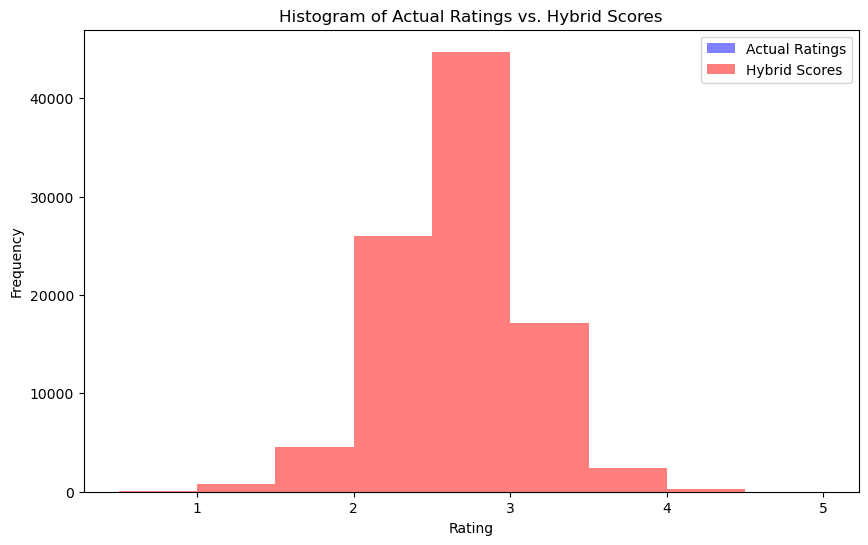

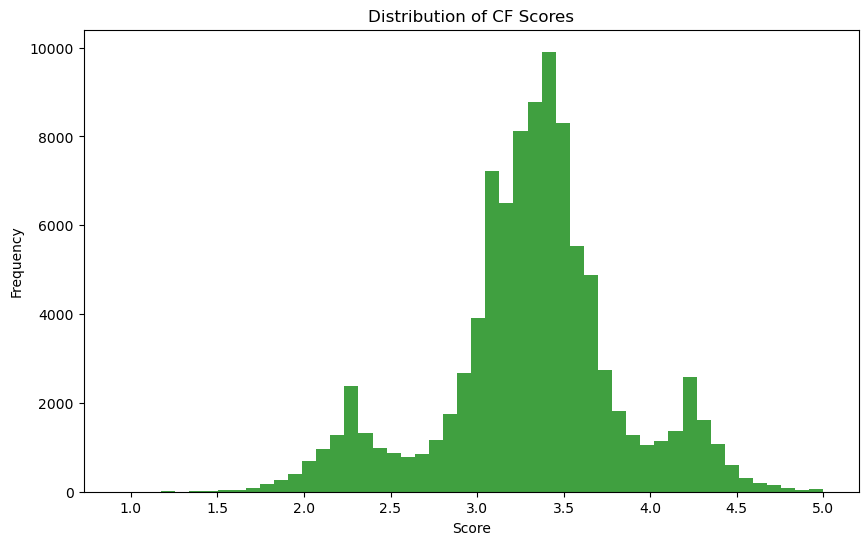

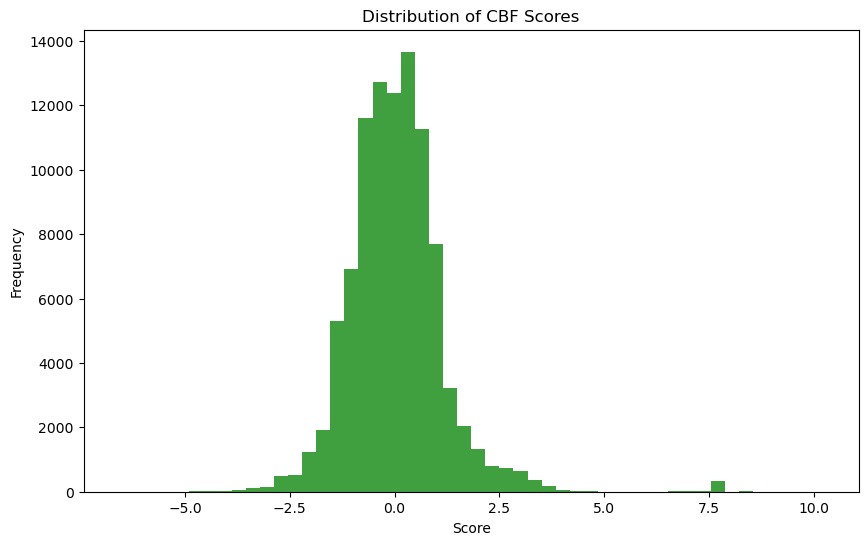

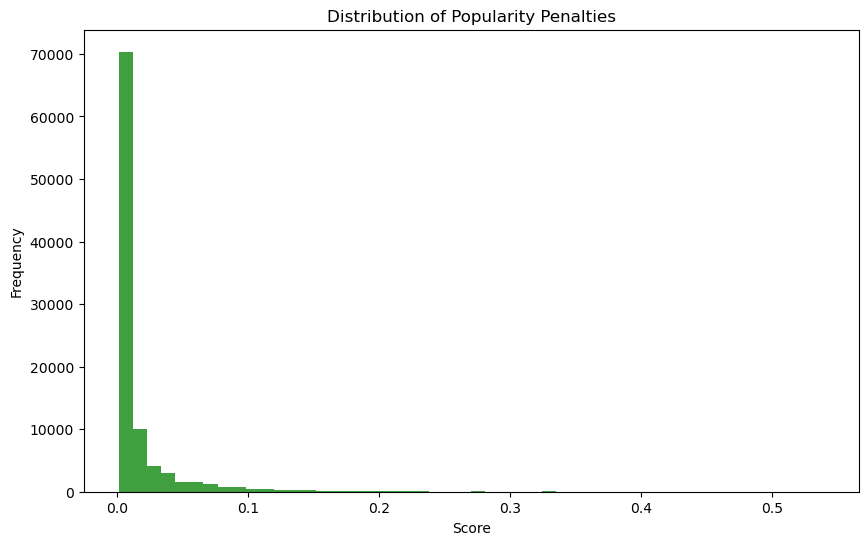

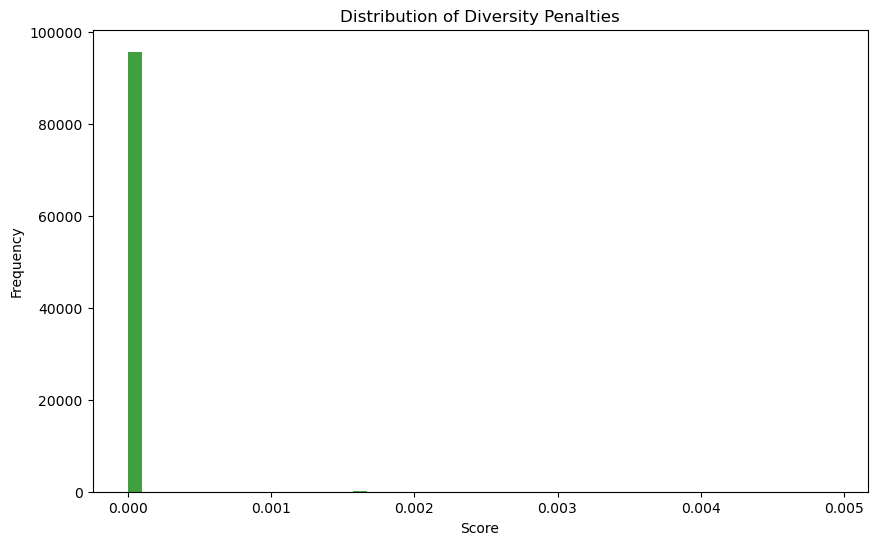

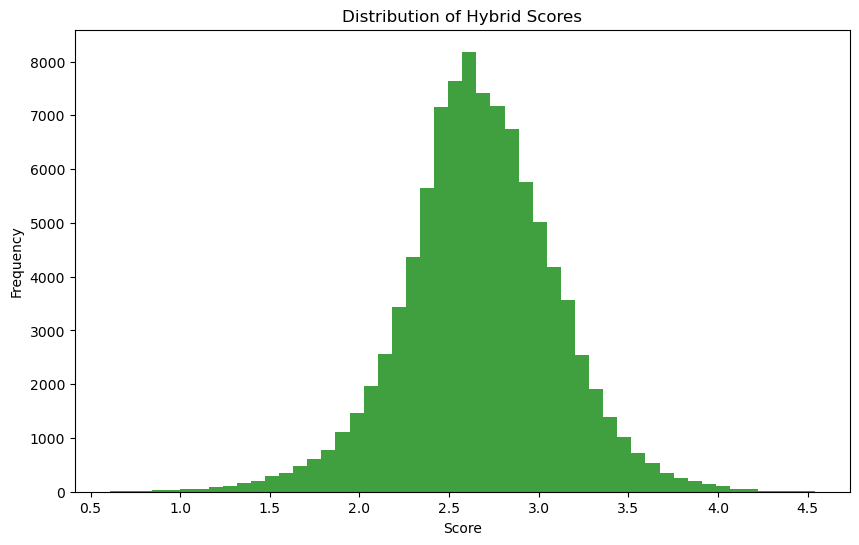

INFO:root:Metrics for top-1 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-2 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-3 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-4 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-5 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}


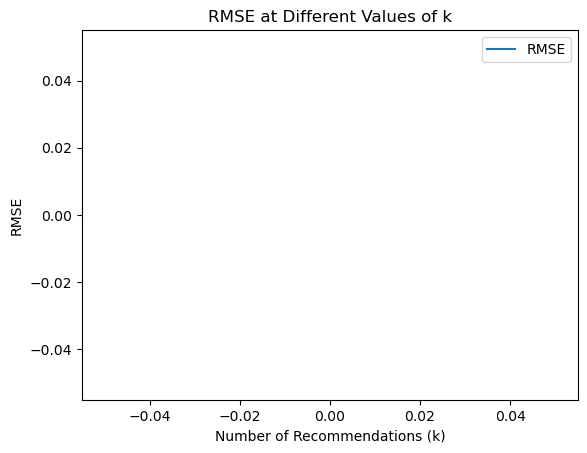

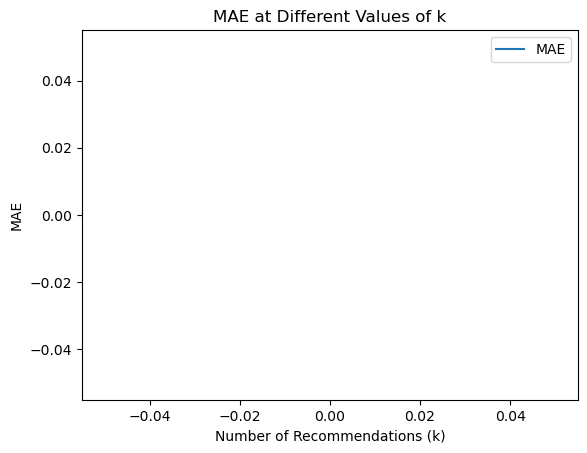

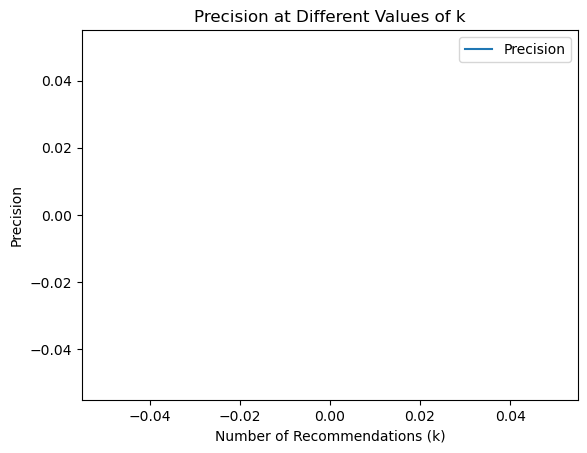

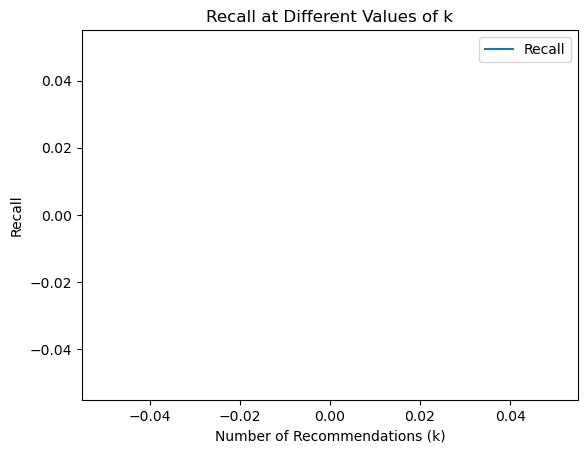

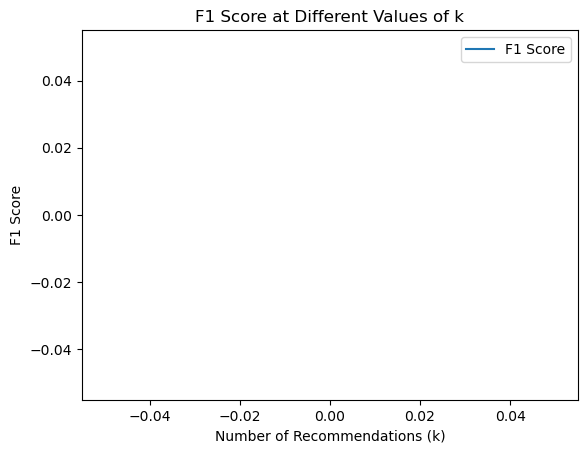

In [8]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 5
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 30

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.5
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    for item_id, _, _, _, _, _ in recommendations[:n_recommendations]:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations[:n_recommendations], cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure()
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features = get_item_features(merged_df, genre_columns)
    user_preferences = derive_user_preferences(merged_df, genre_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []
    
    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])
    
    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
1         3.664680  2.742421 -0.279179 -0.206865 -0.843655 -0.660598   
3        -0.272875 -0.364641 -0.279179 -0.206865 -0.843655 -0.660598   
6        -0.272875 -0.364641 -0.279179 -0.206865 -0.843655  1.513780   
47       -0.272875 -0.364641 -0.279179 -0.206865 -0.843655 -0.660598   
50       -0.272875 -0.364641 -0.279179 -0.206865 -0.843655 -0.660598   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       

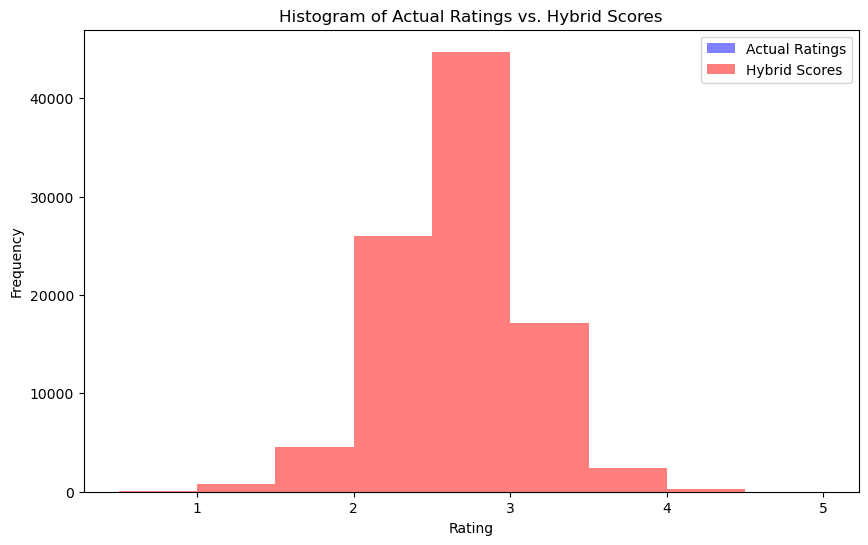

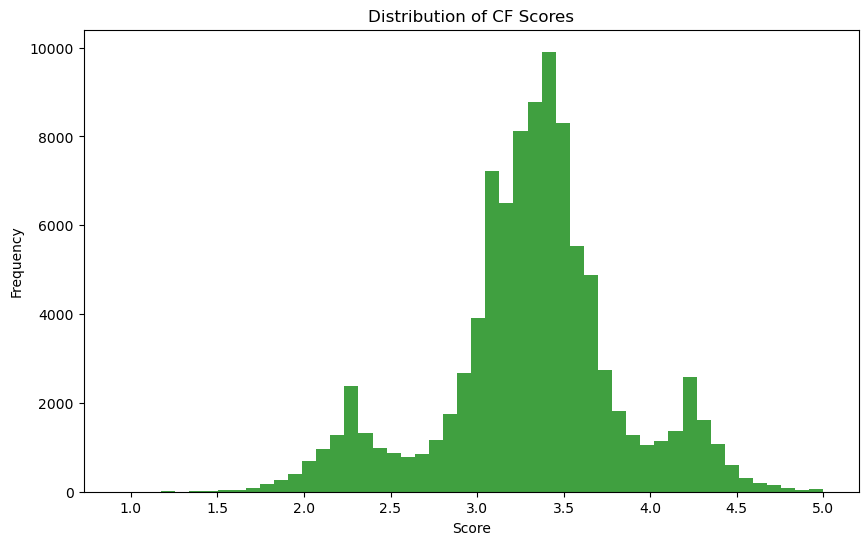

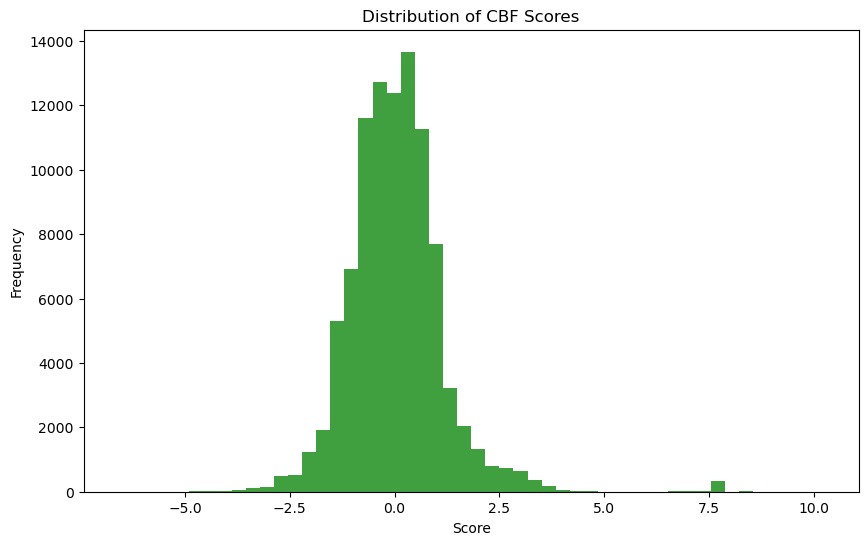

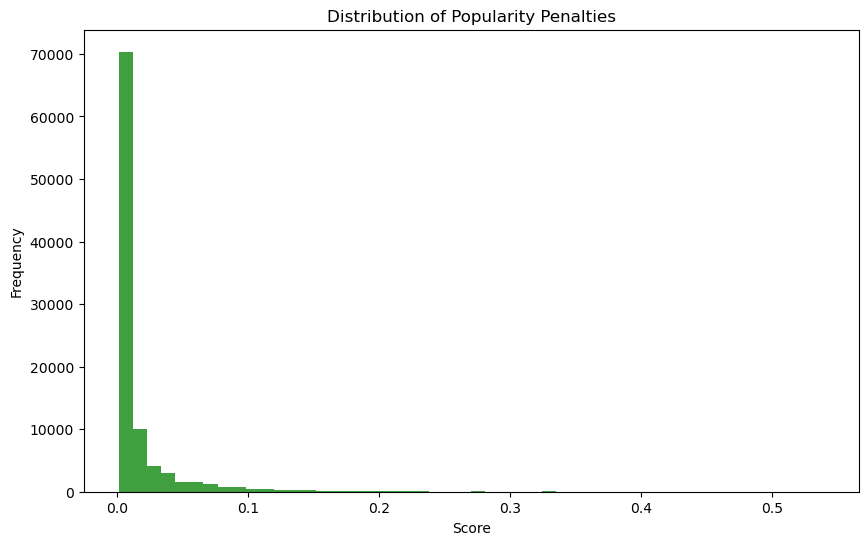

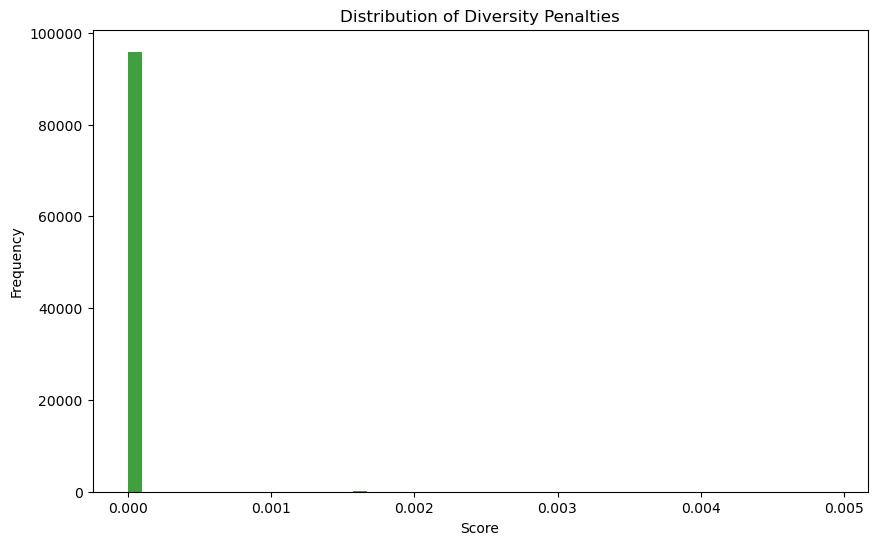

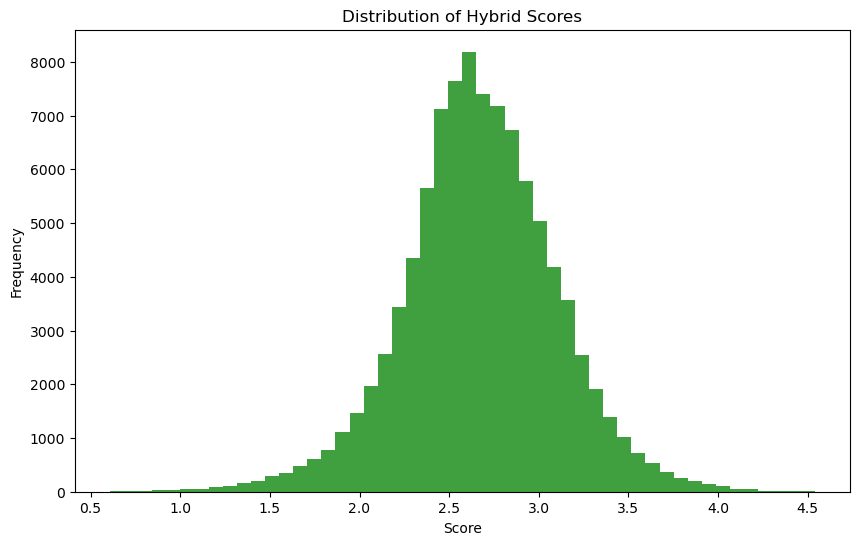

INFO:root:Metrics for top-1 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-2 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-3 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}


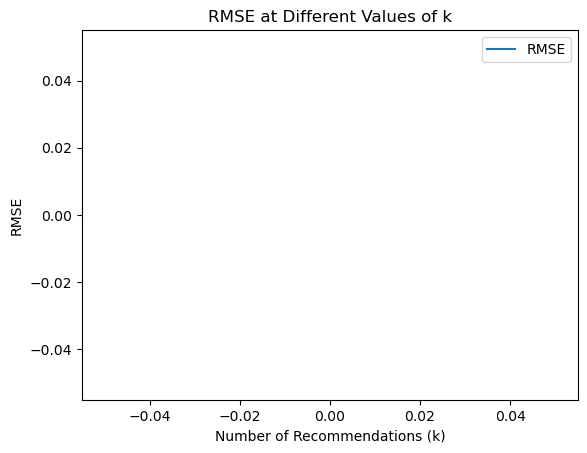

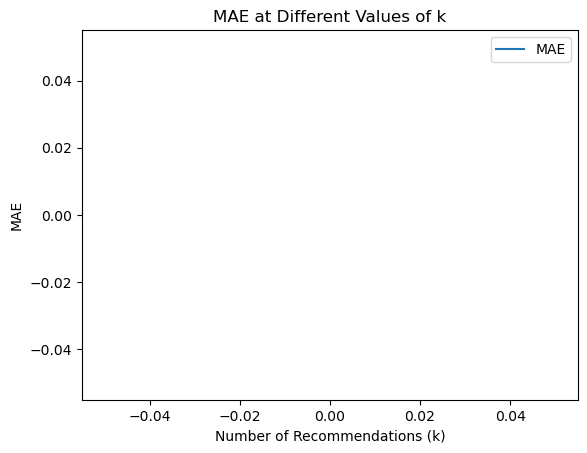

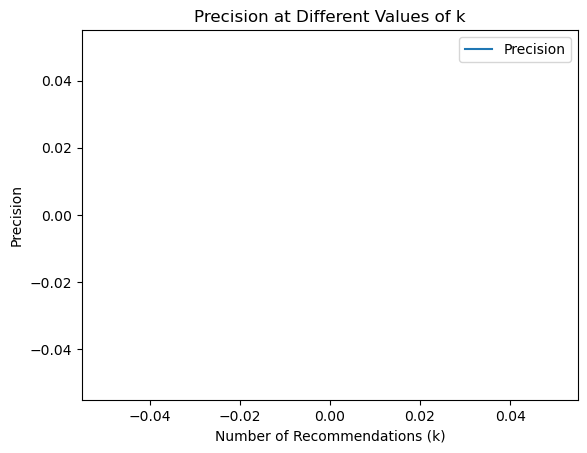

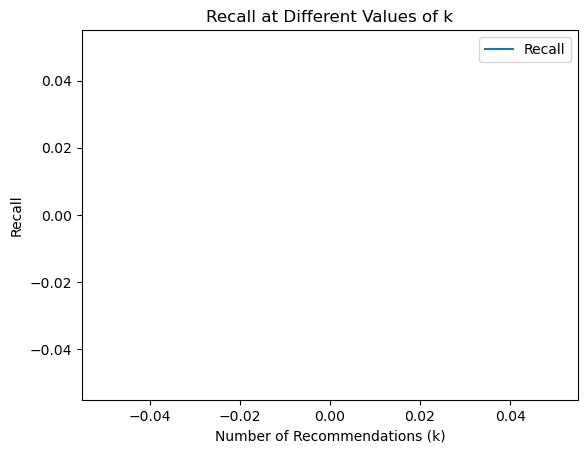

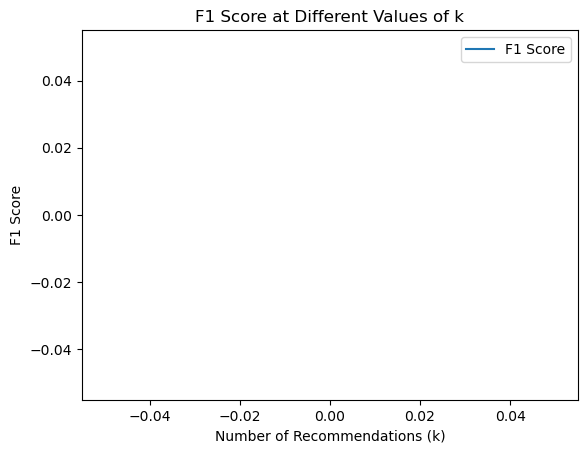

In [1]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    for item_id, _, _, _, _, _ in recommendations[:n_recommendations]:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations[:n_recommendations], cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure()
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []
    
    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])
    
    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
31       -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
527      -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
647      -0.275679 -0.364349 -0.267487 -0.205677  1.191478  1.490189   
688      -0.275679 -0.364349 -0.267487 -0.205677 -0.839294  1.490189   
720       3.627403 -0.364349 -0.267487 -0.205677 -0.839294 -0.671056   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       

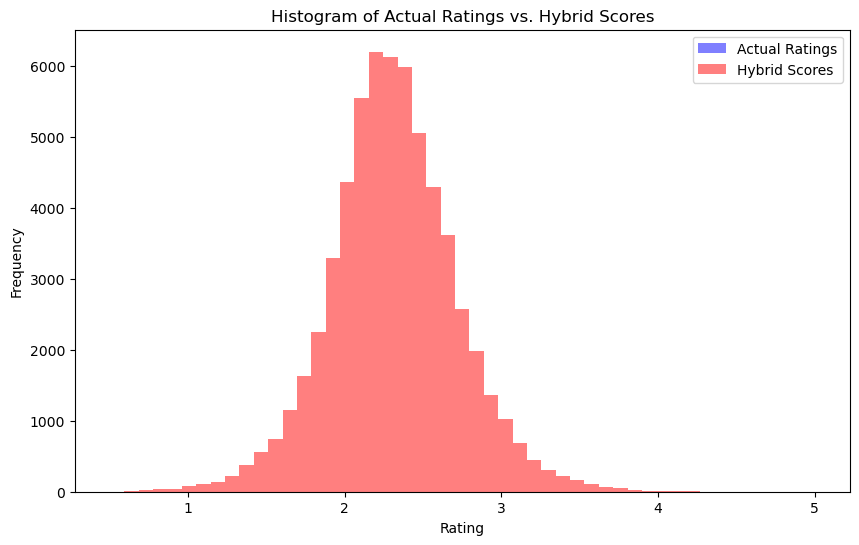

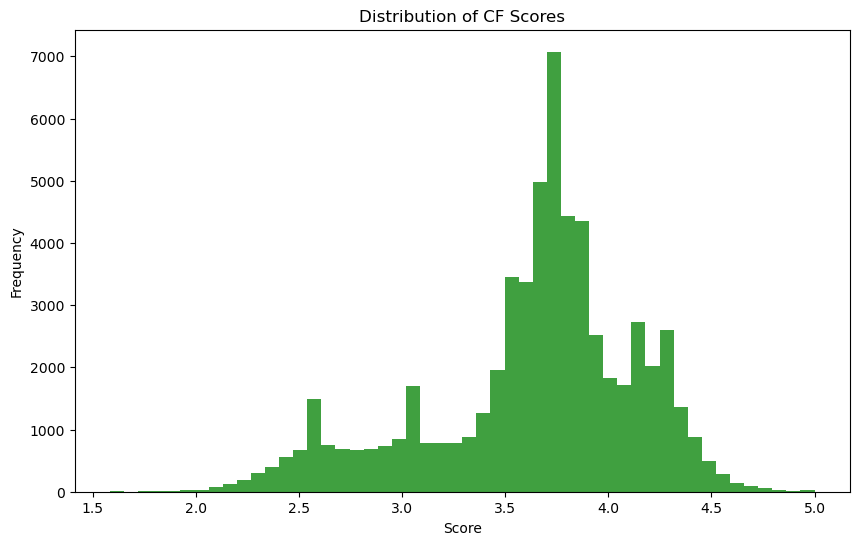

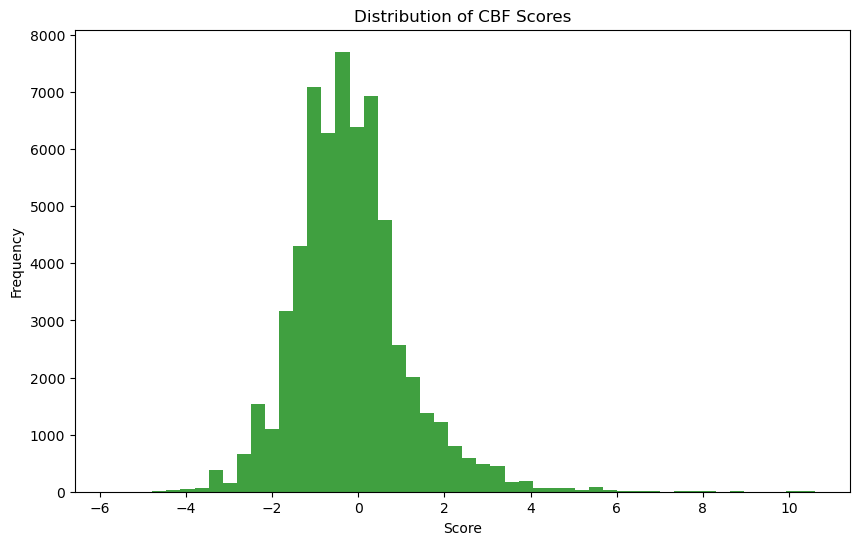

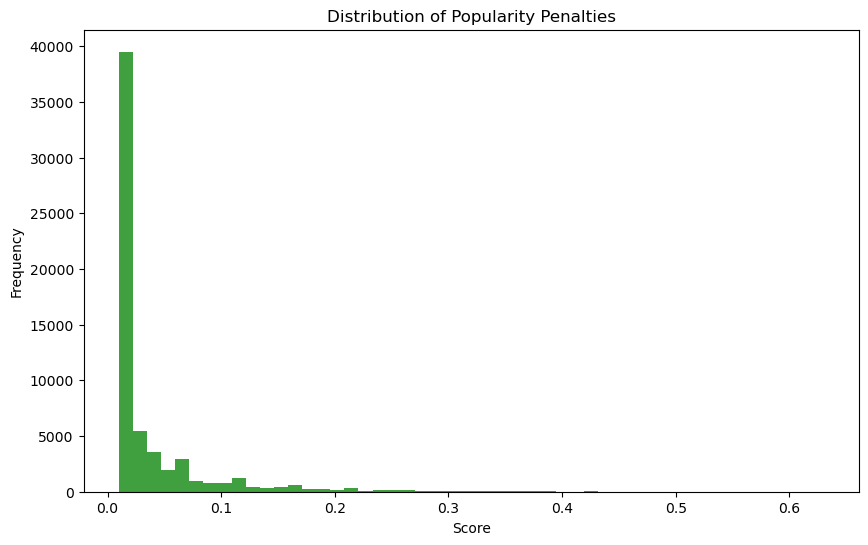

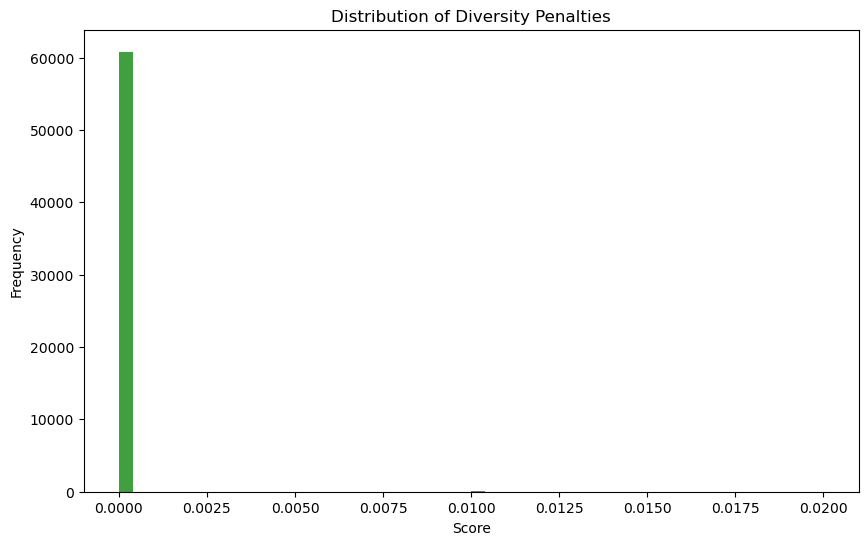

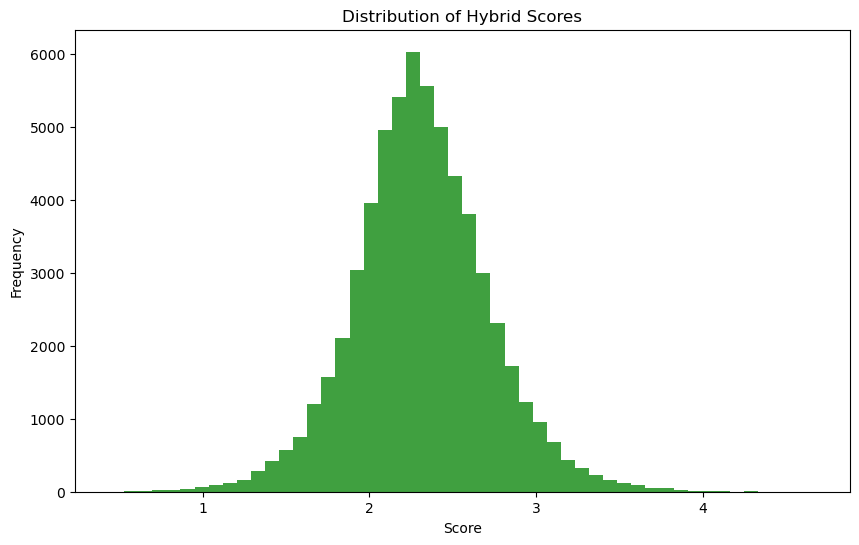

INFO:root:Metrics for top-1 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-2 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-3 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}


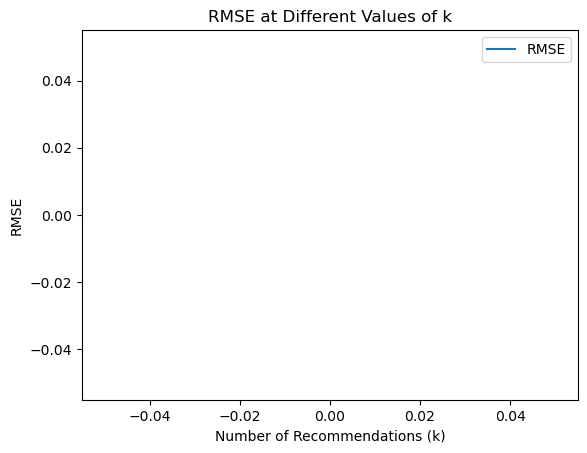

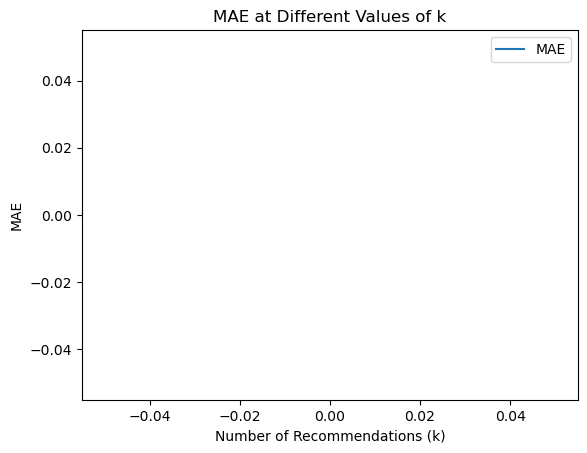

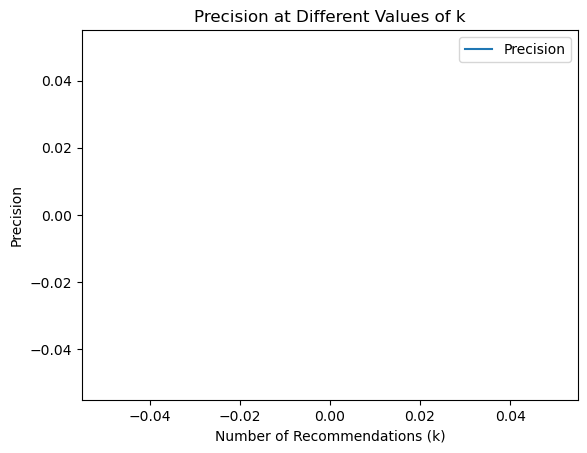

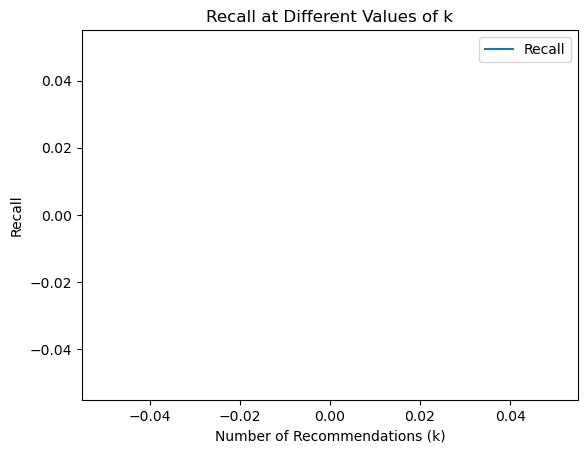

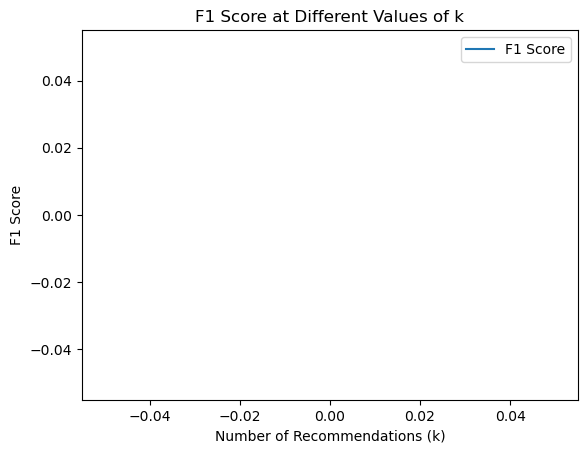

In [3]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.5
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    for item_id, _, _, _, _, _ in recommendations[:n_recommendations]:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations[:n_recommendations], cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.5, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure()
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []
    
    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])
    
    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
31       -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
527      -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
647      -0.275679 -0.364349 -0.267487 -0.205677  1.191478  1.490189   
688      -0.275679 -0.364349 -0.267487 -0.205677 -0.839294  1.490189   
720       3.627403 -0.364349 -0.267487 -0.205677 -0.839294 -0.671056   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       

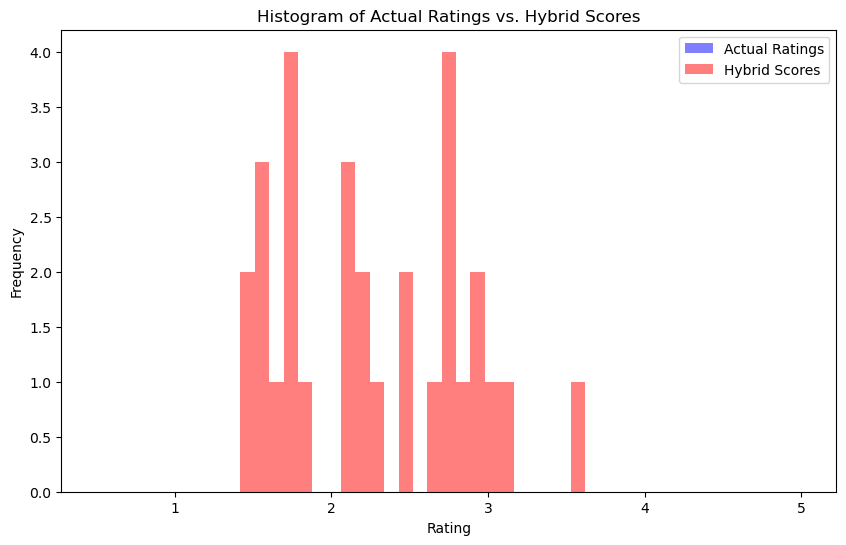

ValueError: x and y must be the same size

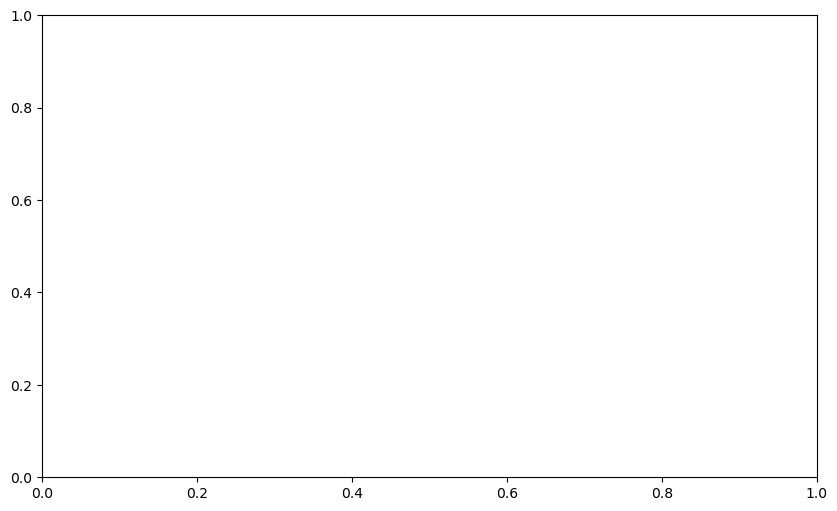

In [5]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    for item_id, _, _, _, _, _ in recommendations[:n_recommendations]:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations[:n_recommendations], cf_scores[:n_recommendations], cbf_scores[:n_recommendations], popularity_penalties[:n_recommendations], diversity_penalties[:n_recommendations], hybrid_scores[:n_recommendations]

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.5, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_scatter(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.scatter(actual_ratings, hybrid_scores, alpha=0.5, color='g')
    plt.xlabel('Actual Ratings')
    plt.ylabel('Hybrid Scores')
    plt.title('Scatter Plot of Actual Ratings vs. Hybrid Scores')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure()
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_scatter(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []
    
    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])
    
    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()



INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8705
INFO:root:MAE: 0.6693
INFO:root:Precision: 0.8244
INFO:root:Recall: 0.3212
INFO:root:F1 Score: 0.4623
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
1         3.692822  2.778885 -0.281968 -0.204552 -0.841178 -0.661263   
3        -0.270796 -0.359857 -0.281968 -0.204552 -0.841178 -0.661263   
6        -0.270796 -0.359857 -0.281968 -0.204552 -0.841178  1.512257   
47       -0.270796 -0.359857 -0.281968 -0.204552 -0.841178 -0.661263   
50       -0.270796 -0.359857 -0.281968 -0.204552 -0.841178 -0.661263   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       

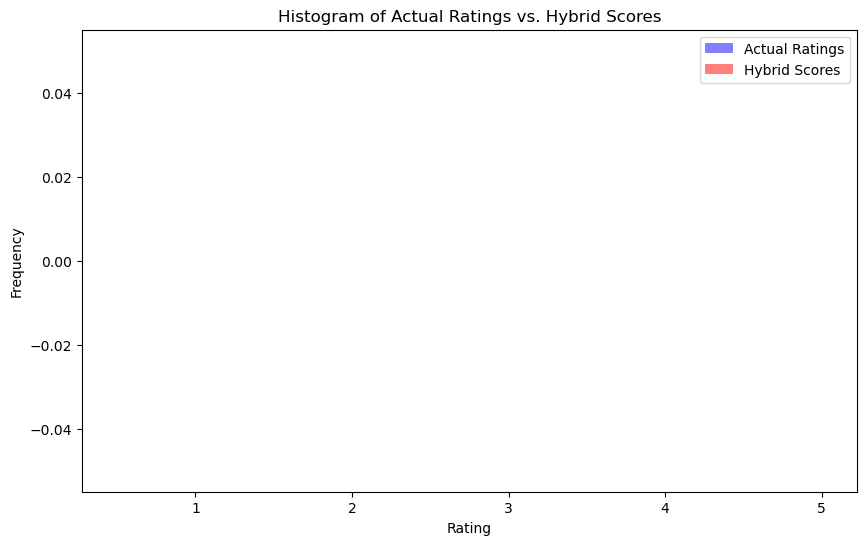

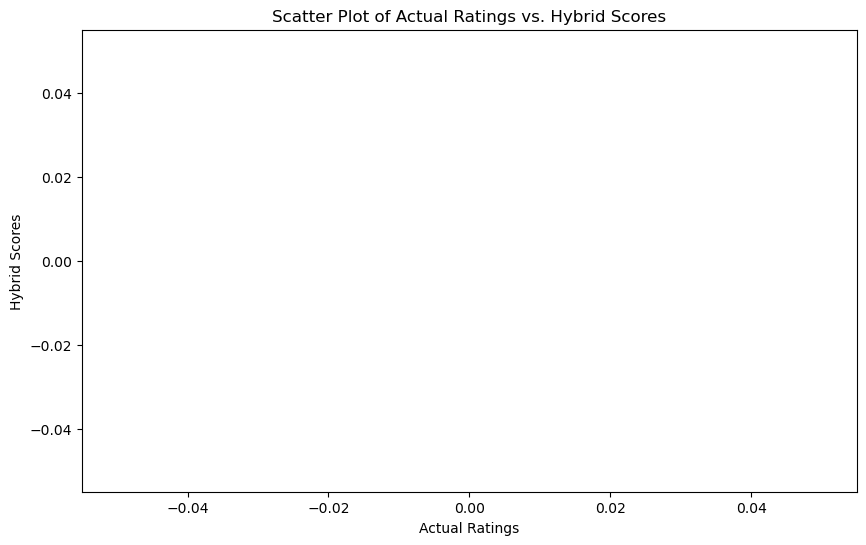

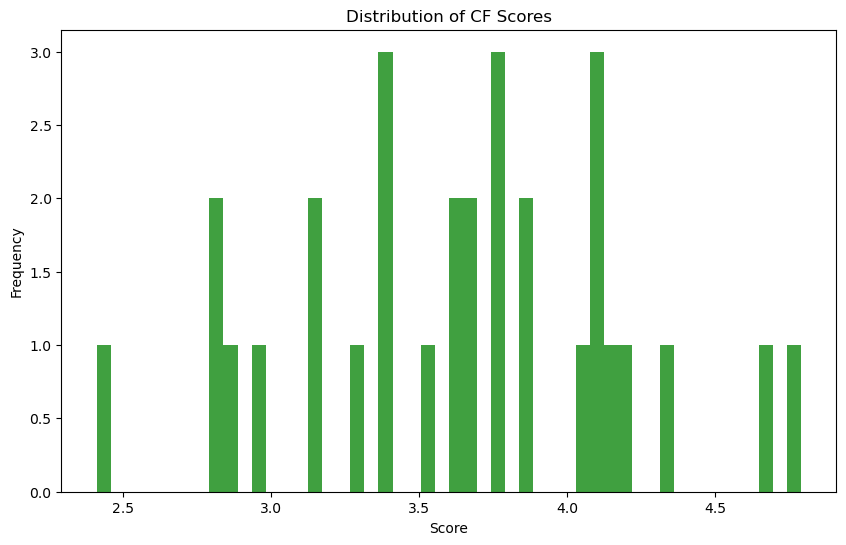

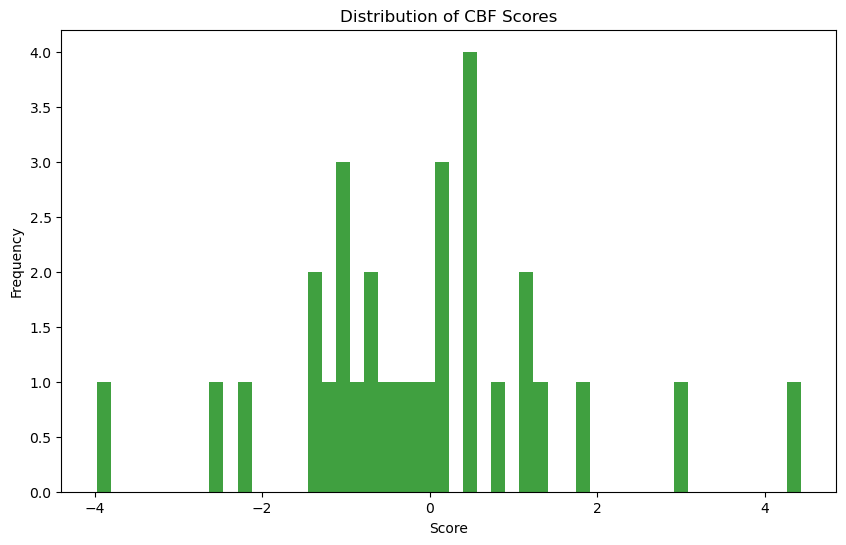

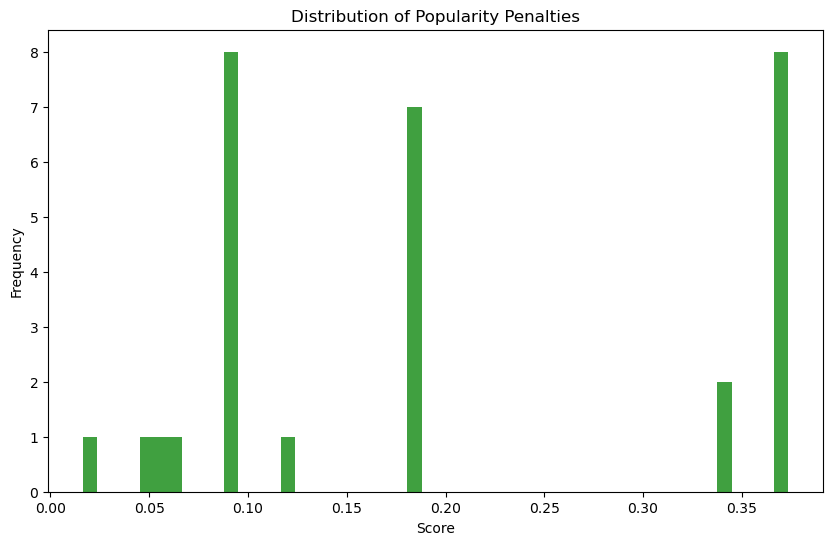

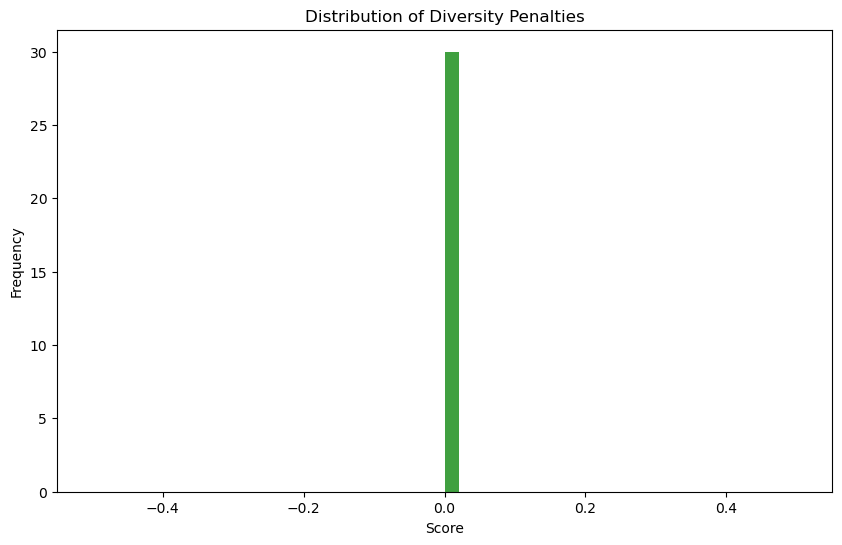

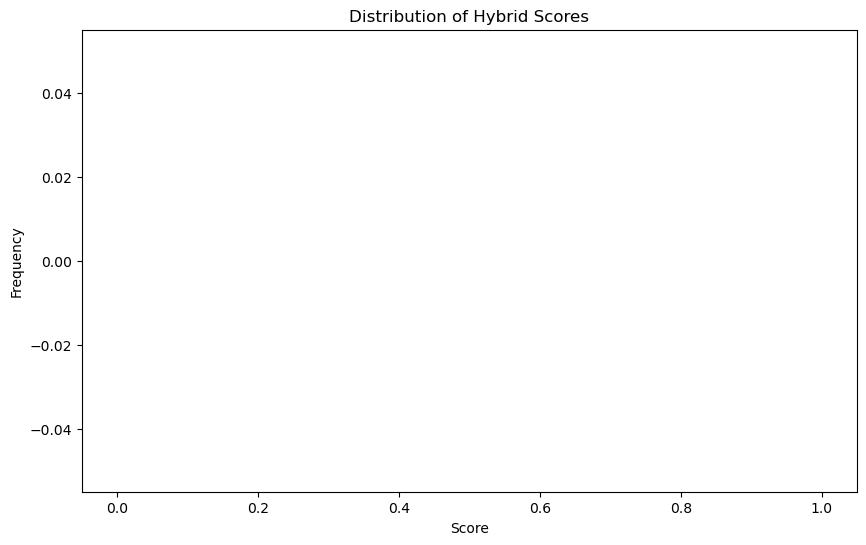

INFO:root:Metrics for top-1 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-2 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-3 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}


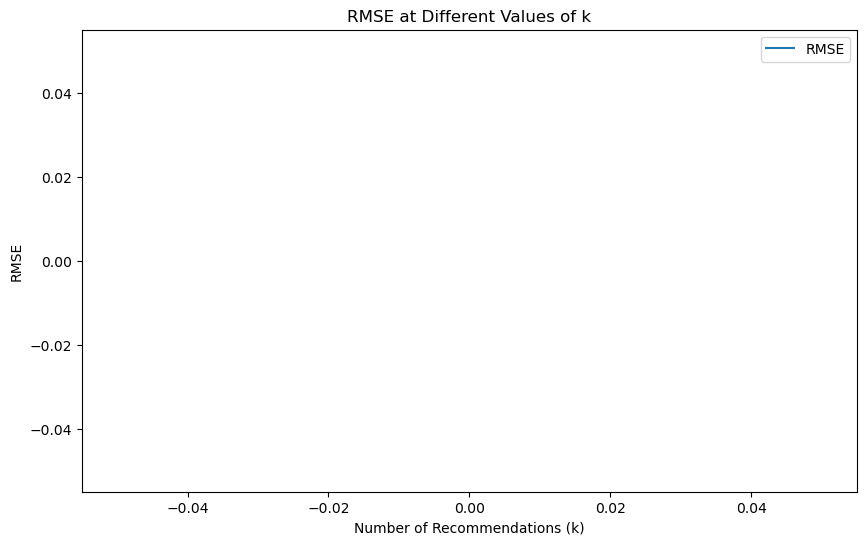

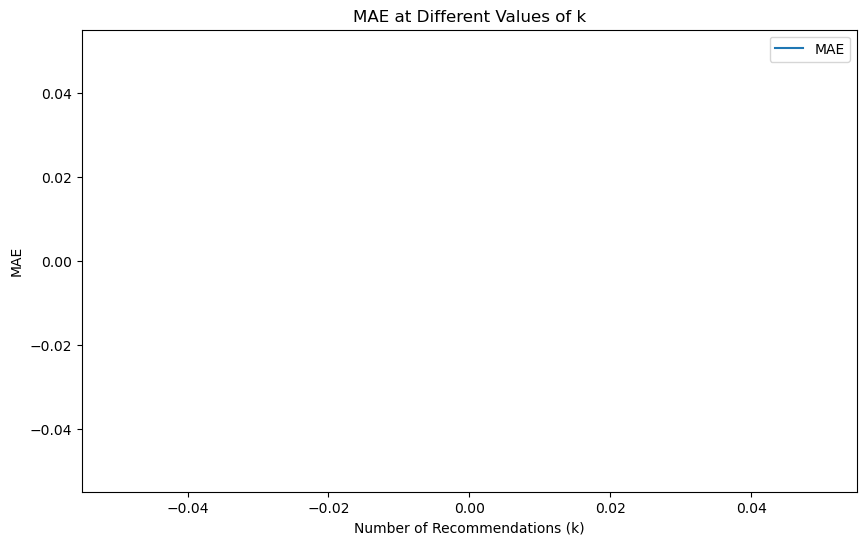

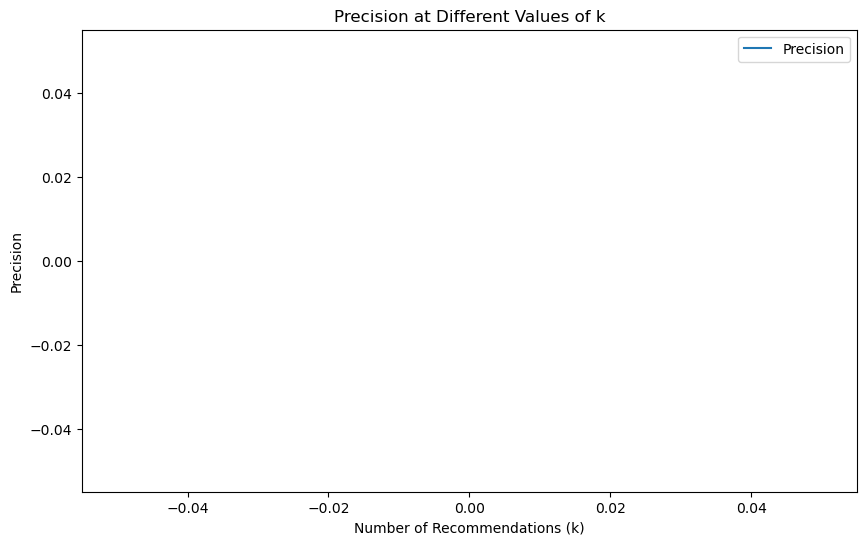

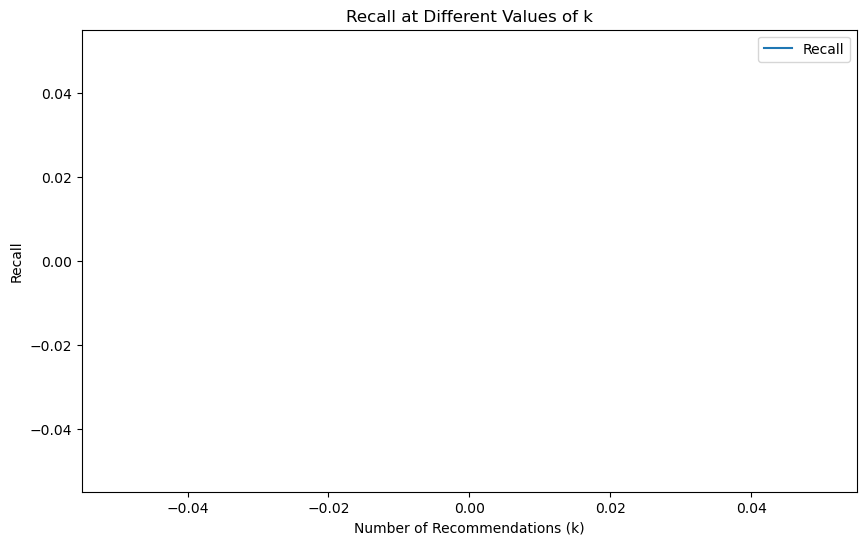

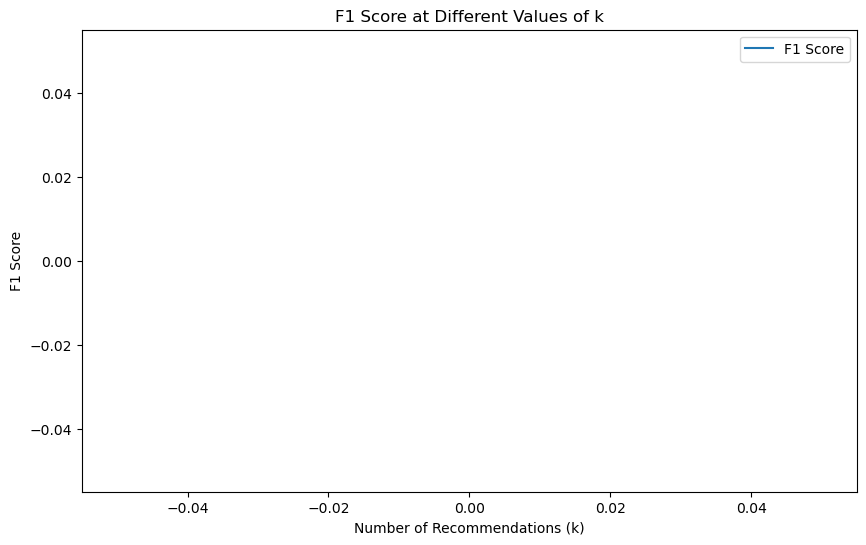

In [25]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 300

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, 
                             global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    for item_id, _, _, _, _, _ in recommendations[:n_recommendations]:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations[:n_recommendations], cf_scores[:n_recommendations], cbf_scores[:3], popularity_penalties[:n_recommendations], diversity_penalties[:n_recommendations], hybrid_scores[:n_recommendations]

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.5, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_scatter(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.scatter(actual_ratings, hybrid_scores, alpha=0.5, color='g')
    plt.xlabel('Actual Ratings')
    plt.ylabel('Hybrid Scores')
    plt.title('Scatter Plot of Actual Ratings vs. Hybrid Scores')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_scatter(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []

    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])

    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
31       -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
527      -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
647      -0.275679 -0.364349 -0.267487 -0.205677  1.191478  1.490189   
688      -0.275679 -0.364349 -0.267487 -0.205677 -0.839294  1.490189   
720       3.627403 -0.364349 -0.267487 -0.205677 -0.839294 -0.671056   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       

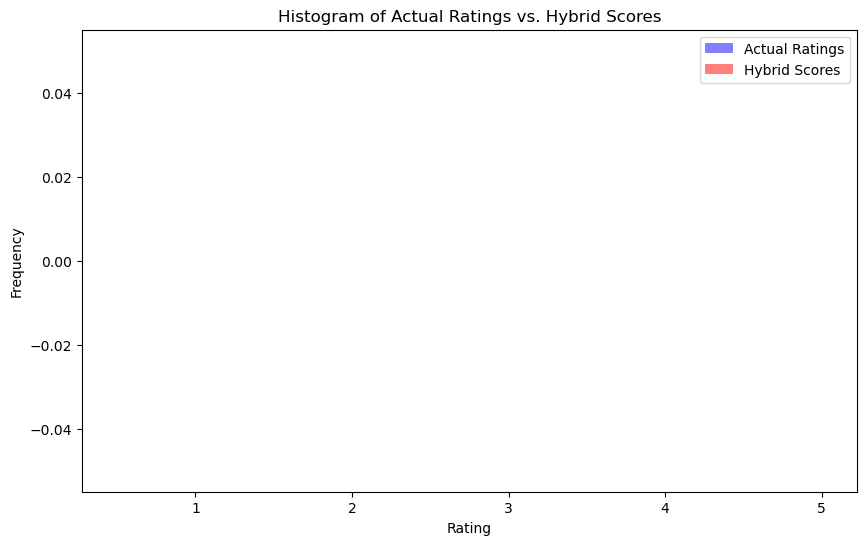

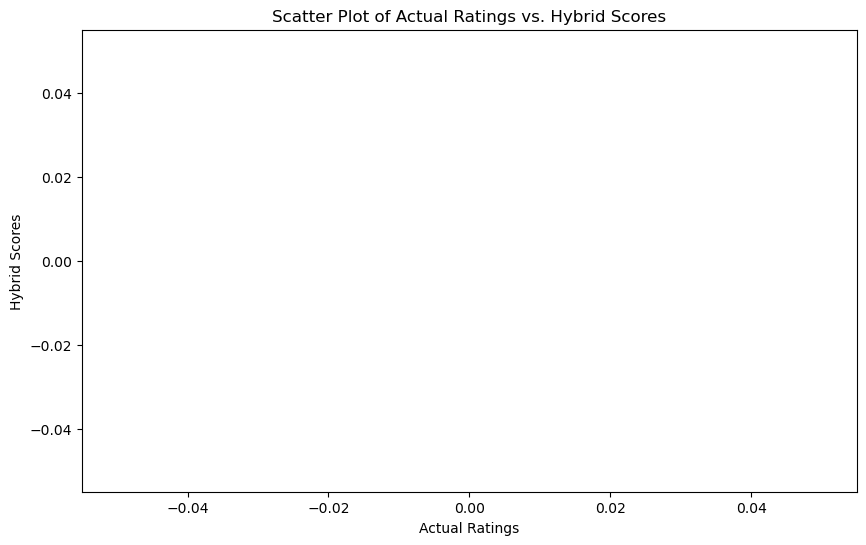

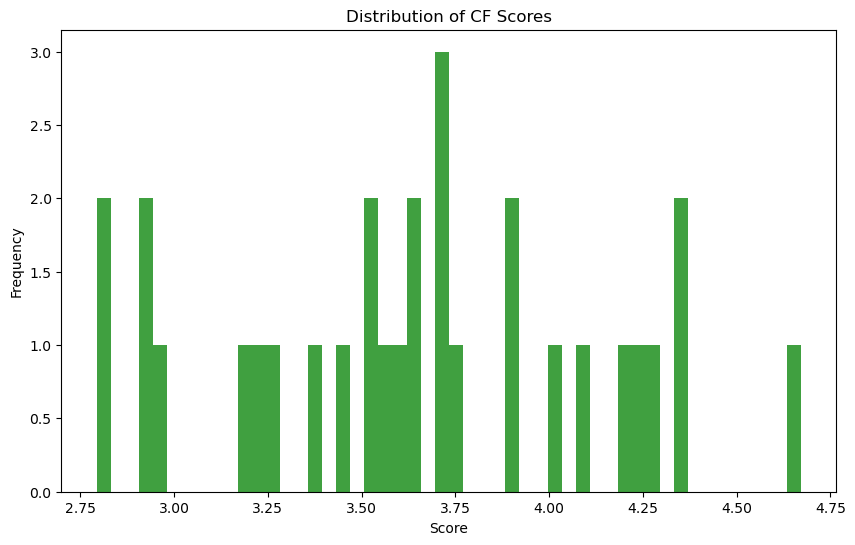

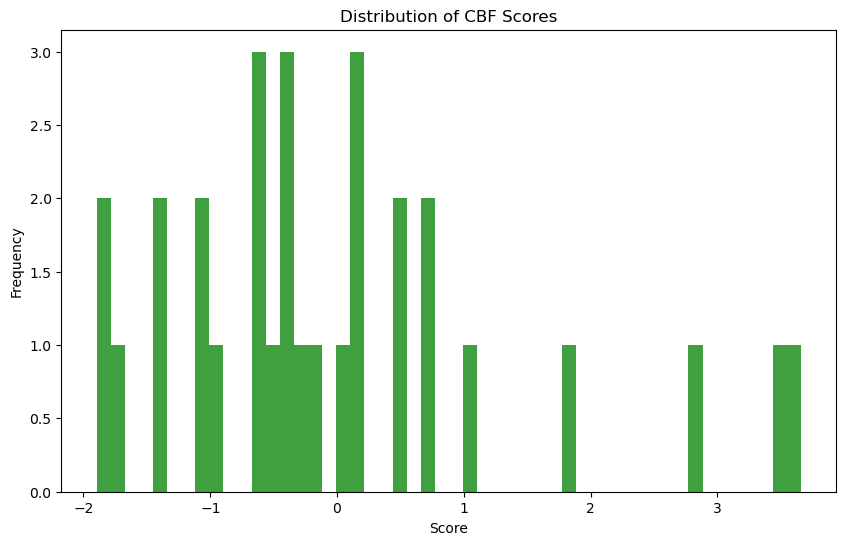

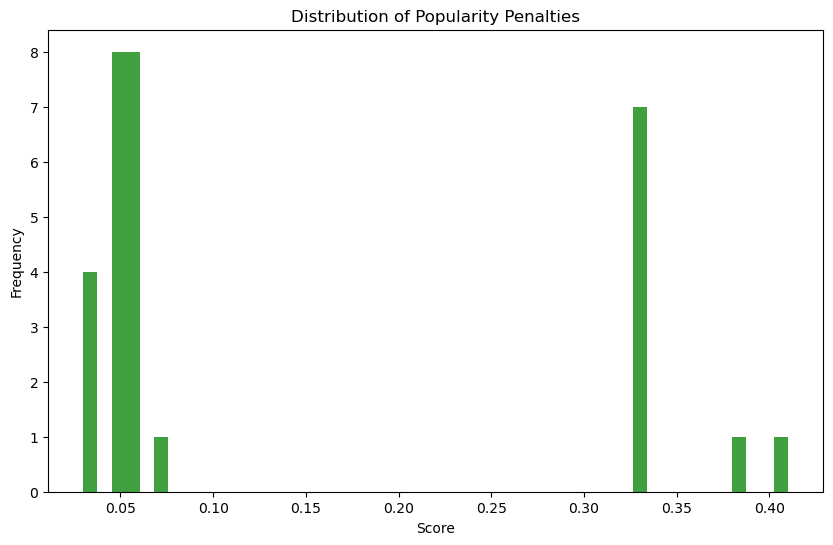

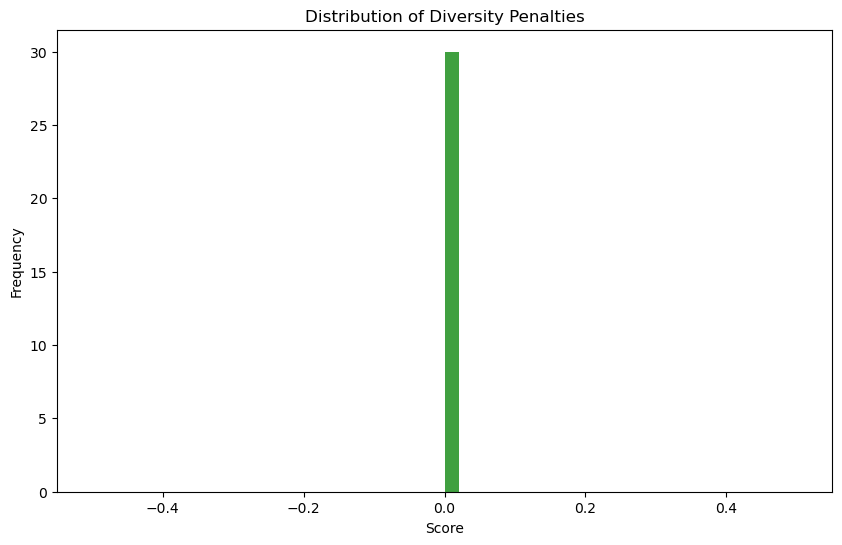

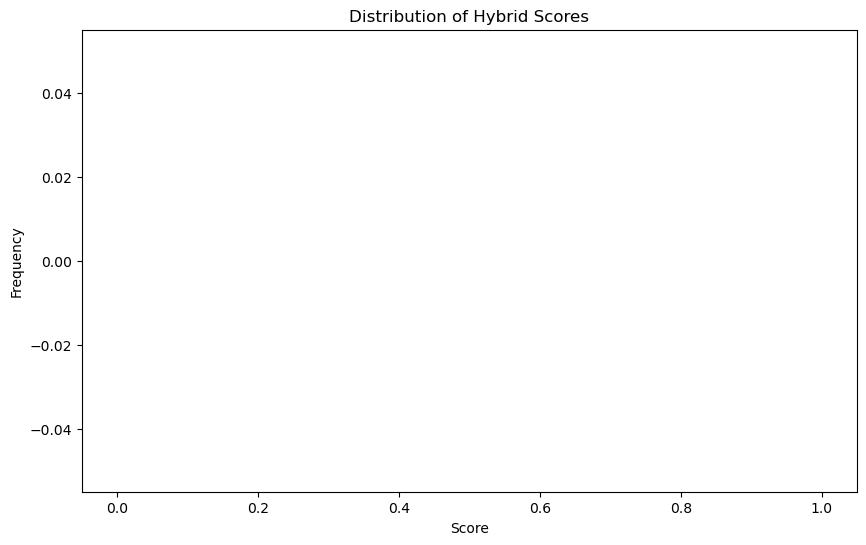

INFO:root:Metrics for top-1 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-2 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-3 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}


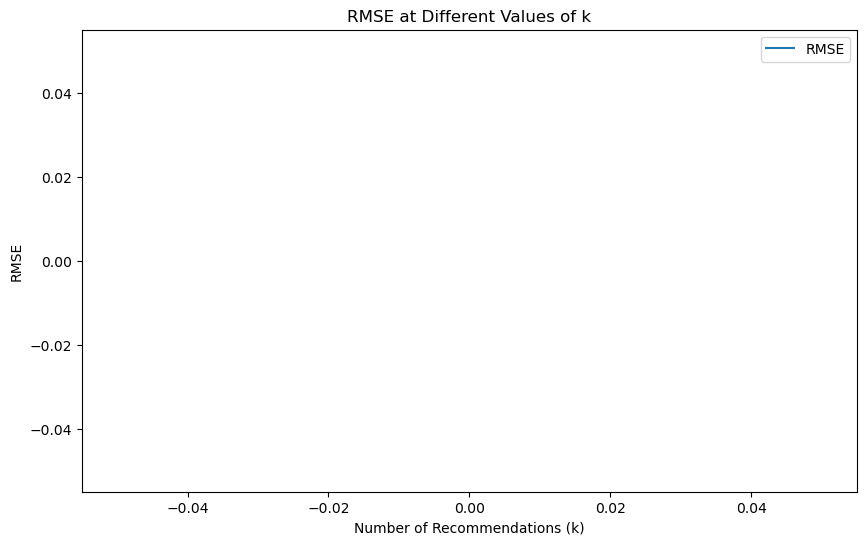

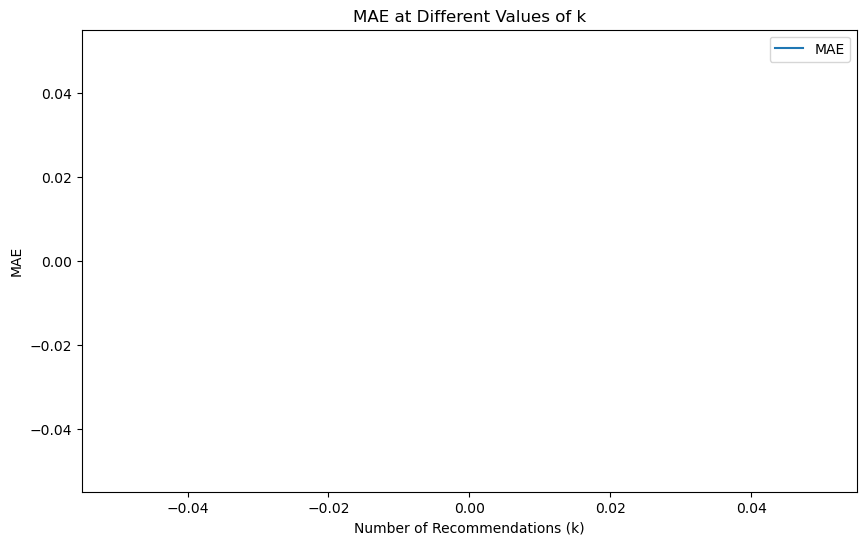

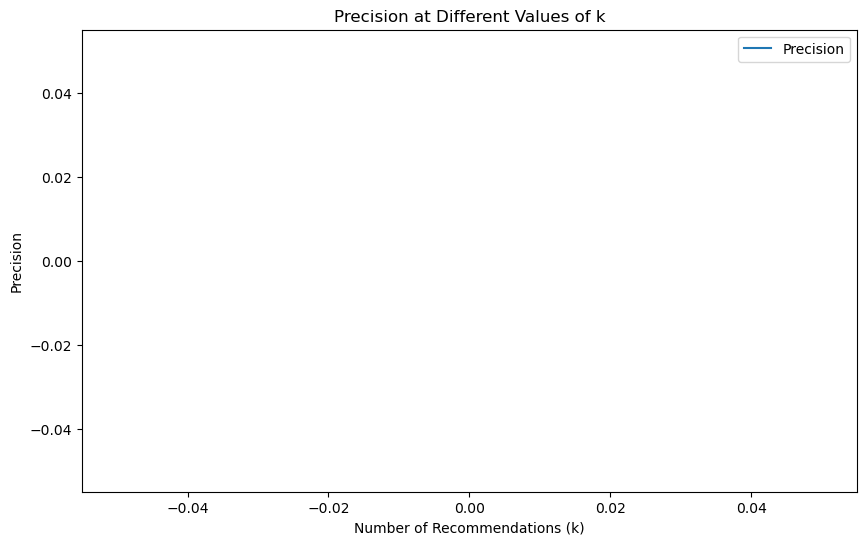

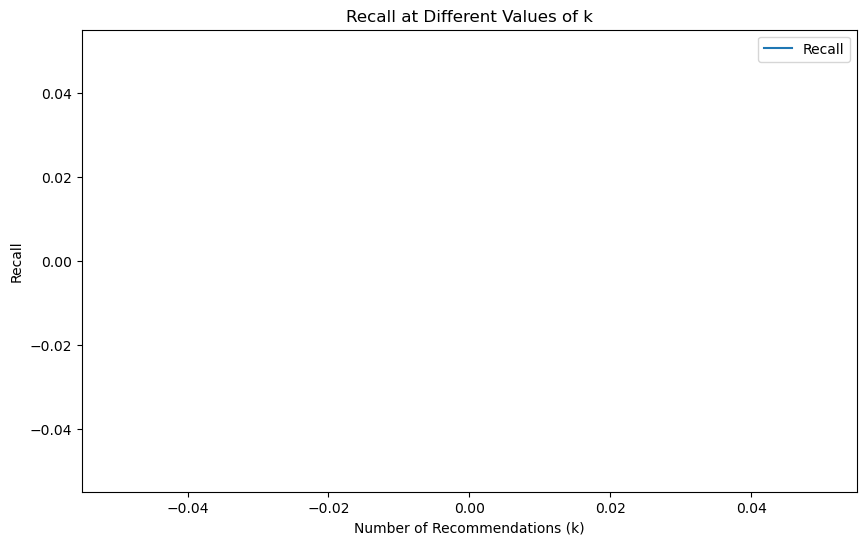

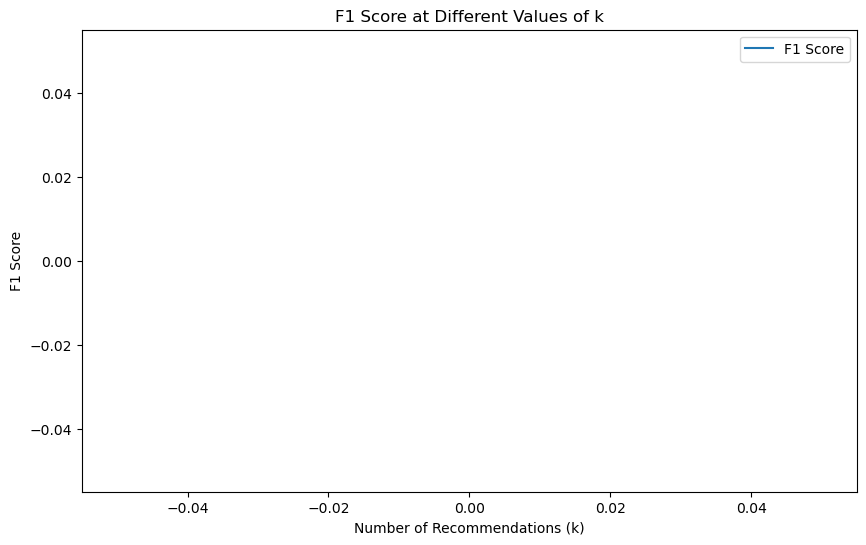

In [27]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    for item_id, _, _, _, _, _ in recommendations:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.5, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_scatter(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.scatter(actual_ratings, hybrid_scores, alpha=0.5, color='g')
    plt.xlabel('Actual Ratings')
    plt.ylabel('Hybrid Scores')
    plt.title('Scatter Plot of Actual Ratings vs. Hybrid Scores')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_scatter(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []

    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])

    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
31       -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
527      -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
647      -0.275679 -0.364349 -0.267487 -0.205677  1.191478  1.490189   
688      -0.275679 -0.364349 -0.267487 -0.205677 -0.839294  1.490189   
720       3.627403 -0.364349 -0.267487 -0.205677 -0.839294 -0.671056   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       

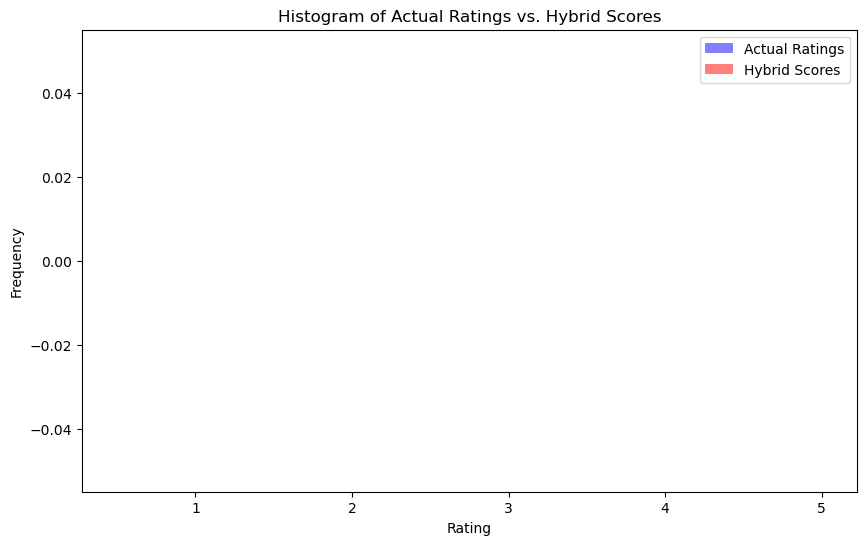

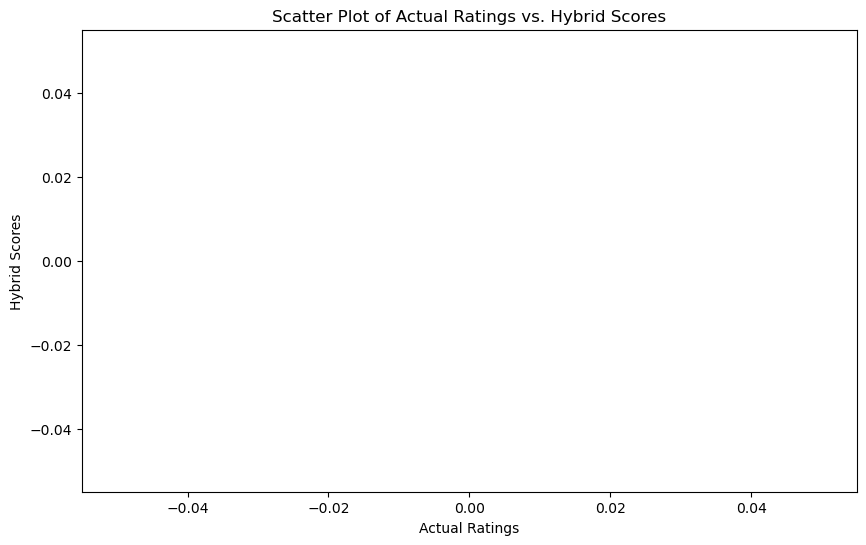

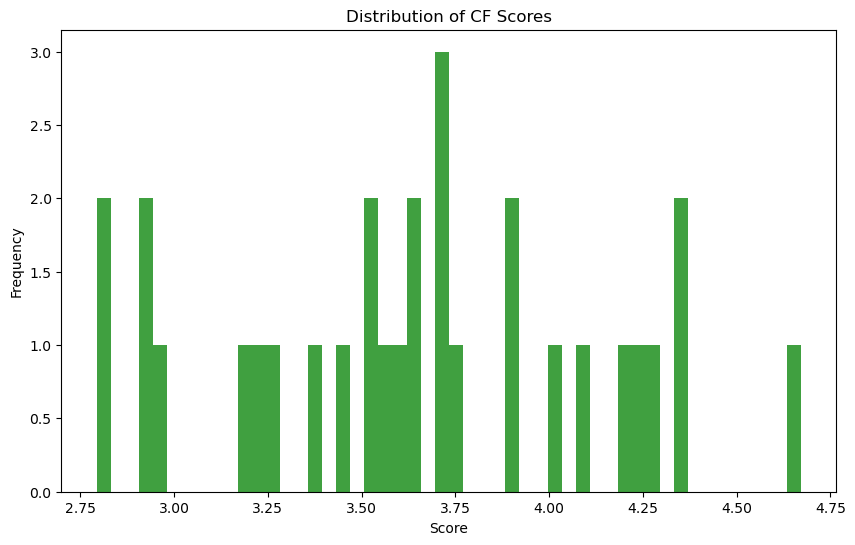

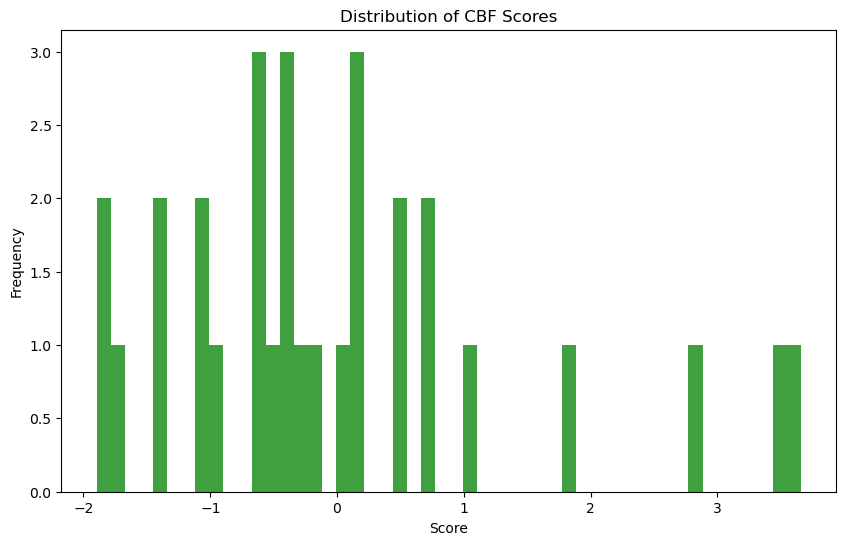

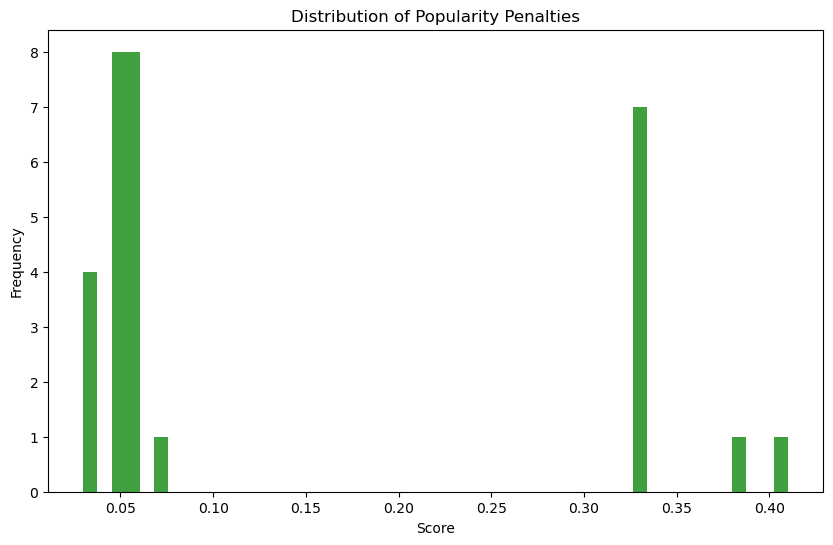

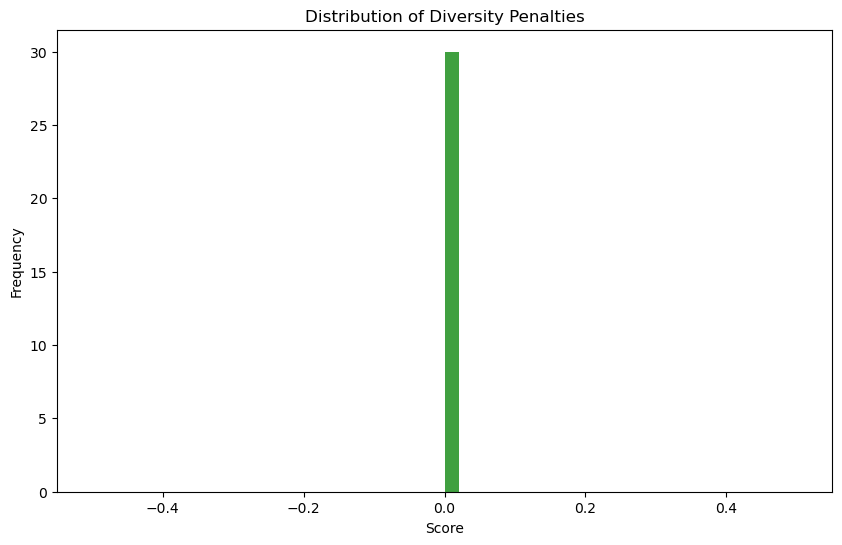

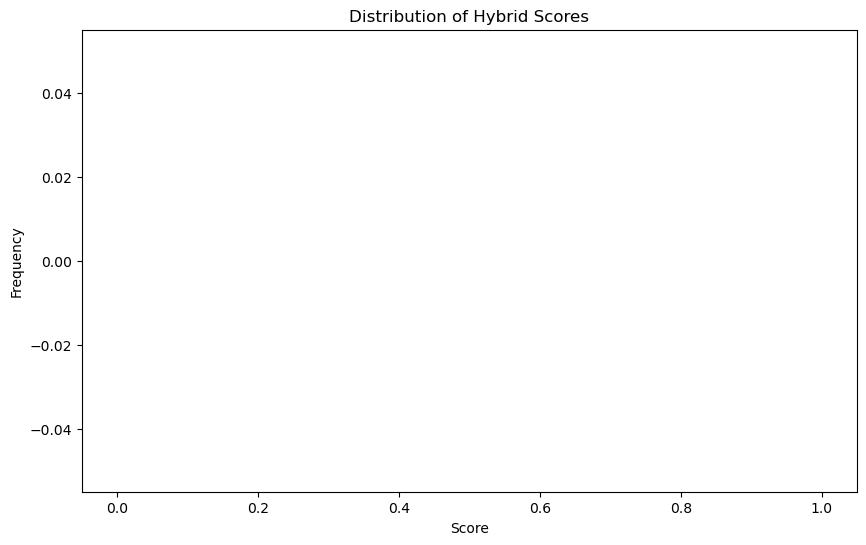

INFO:root:Metrics for top-1 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-2 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-3 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}


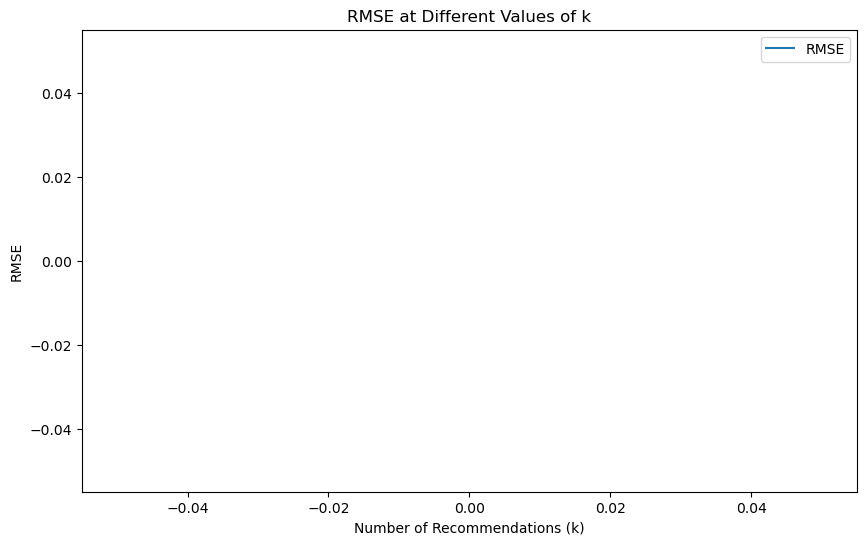

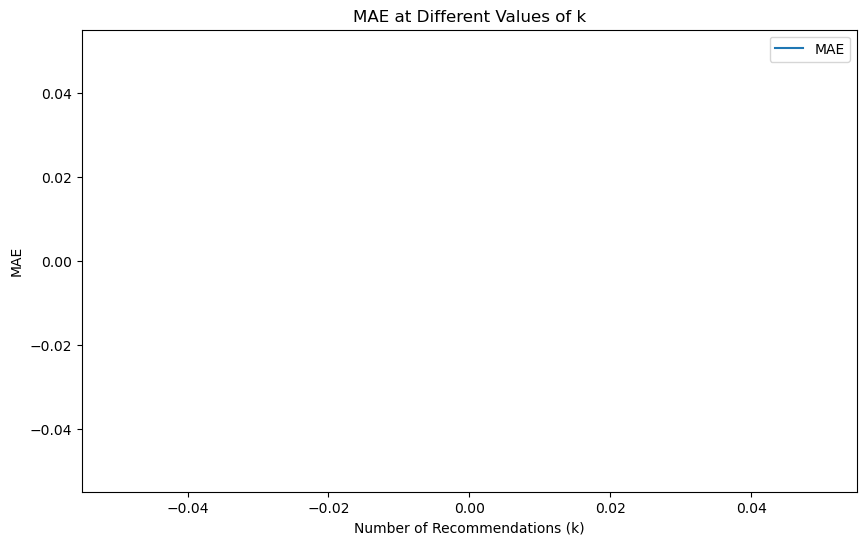

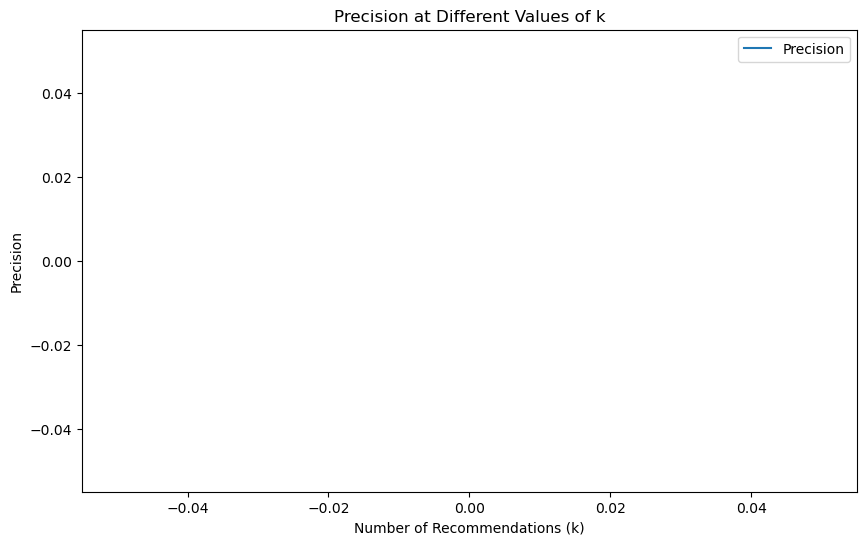

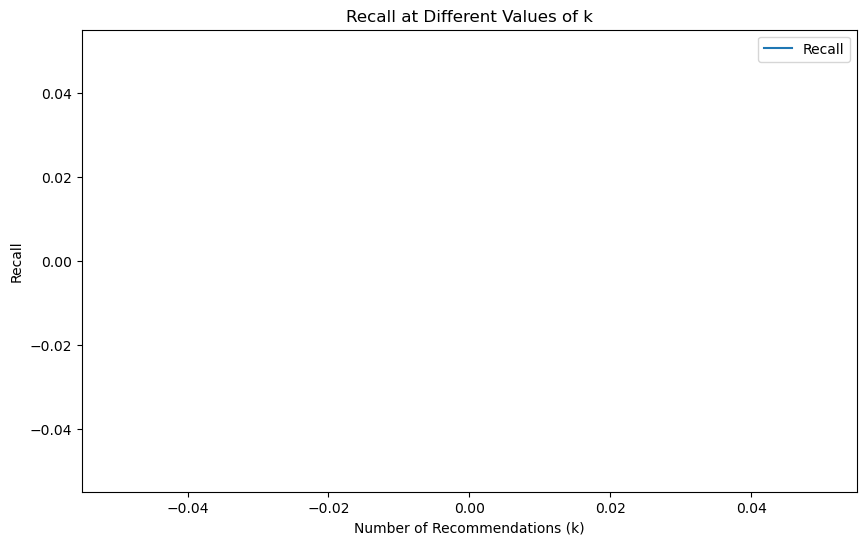

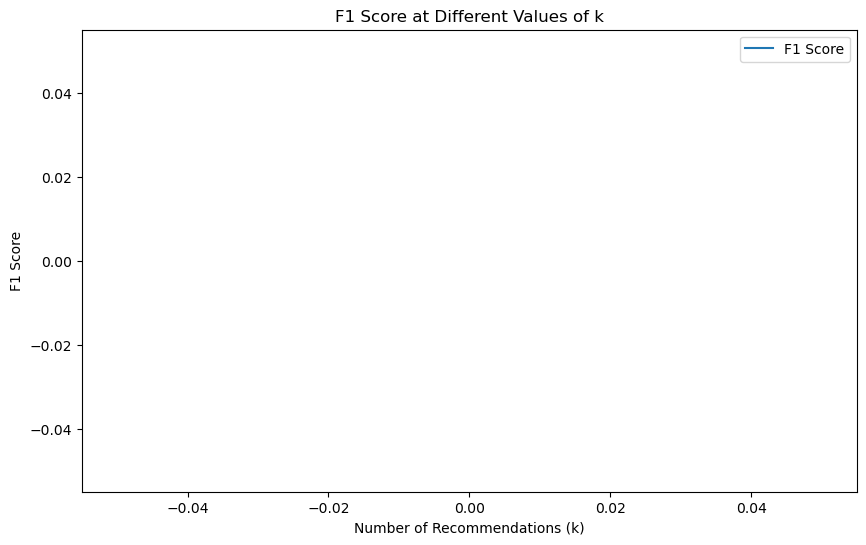

In [29]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty, diversity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    for item_id, _, _, _, _, _ in recommendations:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating, _, _, _, _ in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.5, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_scatter(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.scatter(actual_ratings, hybrid_scores, alpha=0.5, color='g')
    plt.xlabel('Actual Ratings')
    plt.ylabel('Hybrid Scores')
    plt.title('Scatter Plot of Actual Ratings vs. Hybrid Scores')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_scatter(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []

    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])

    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


# NEW CODE SESSION WITH CHATGBT 4o

In [36]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)


def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    for item_id, _ in recommendations:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores


def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }


def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)
            else:
                logging.debug(f"User {user}, Item {item_id}: Predicted {predicted_rating}, Actual not rated by user")

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }



def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _, _, _, _, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _, _, _, _, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _, _, _, _, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _, _, _, _, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _, _, _, _, _ in recommendations[user1]}
        items2 = {item_id for item_id, _, _, _, _, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _, _, _, _, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.5, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_scatter(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.scatter(actual_ratings, hybrid_scores, alpha=0.5, color='g')
    plt.xlabel('Actual Ratings')
    plt.ylabel('Hybrid Scores')
    plt.title('Scatter Plot of Actual Ratings vs. Hybrid Scores')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()


def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_scatter(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []

    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])

    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
31       -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
527      -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
647      -0.275679 -0.364349 -0.267487 -0.205677  1.191478  1.490189   
688      -0.275679 -0.364349 -0.267487 -0.205677 -0.839294  1.490189   
720       3.627403 -0.364349 -0.267487 -0.205677 -0.839294 -0.671056   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       

ValueError: not enough values to unpack (expected 6, got 2)

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
31       -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
527      -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
647      -0.275679 -0.364349 -0.267487 -0.205677  1.191478  1.490189   
688      -0.275679 -0.364349 -0.267487 -0.205677 -0.839294  1.490189   
720       3.627403 -0.364349 -0.267487 -0.205677 -0.839294 -0.671056   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       

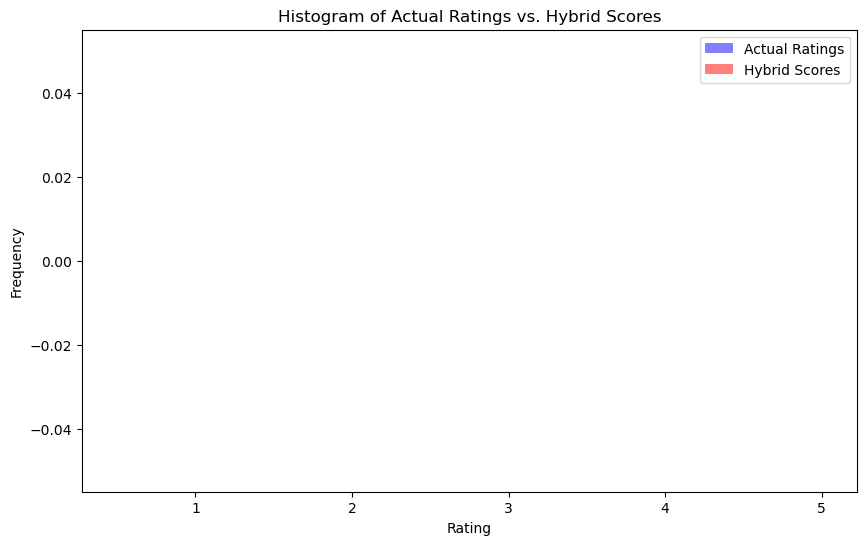

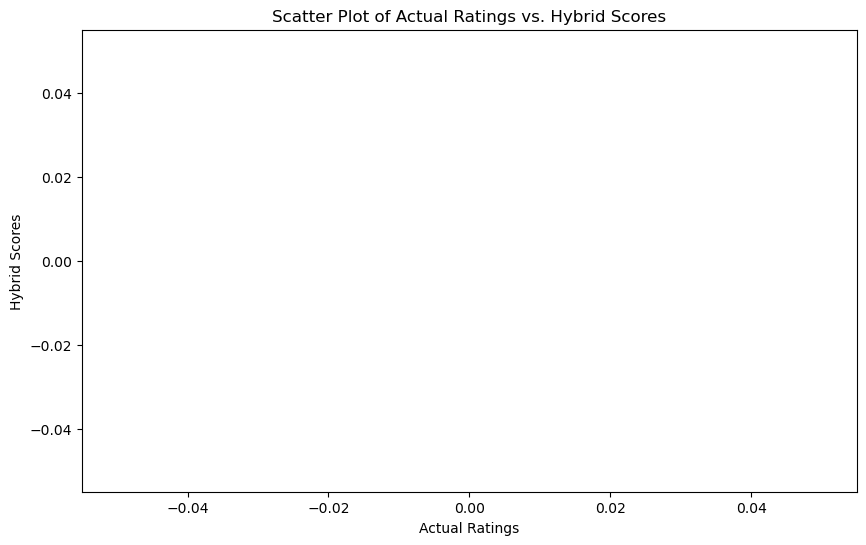

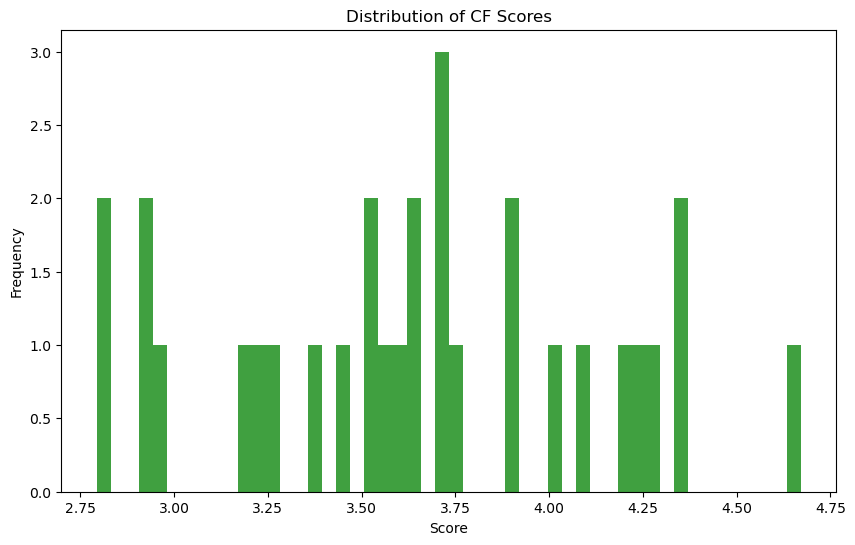

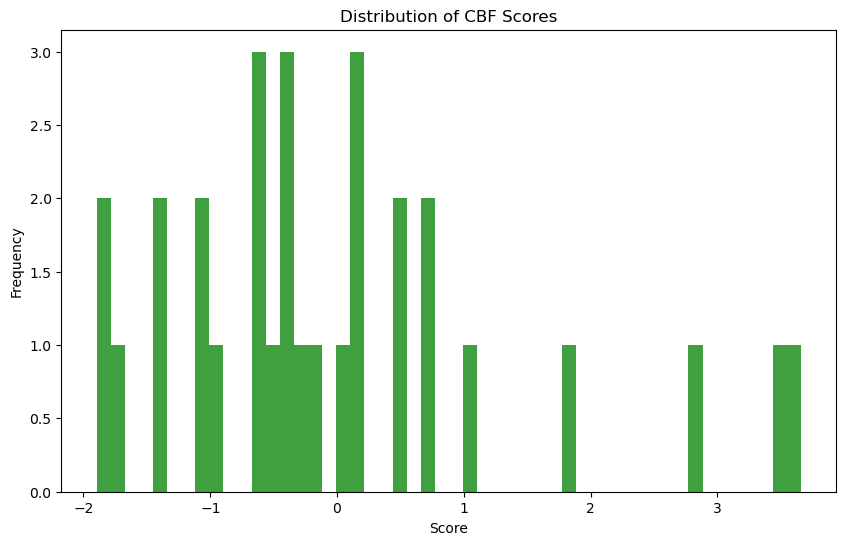

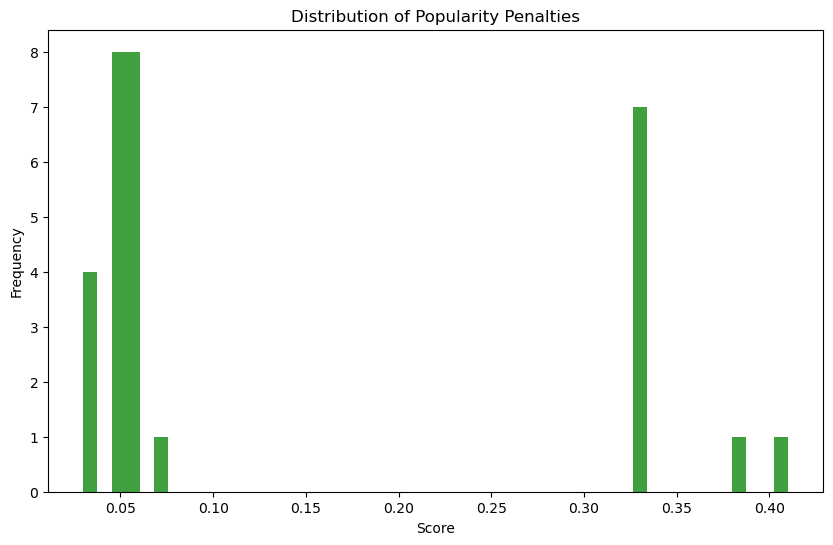

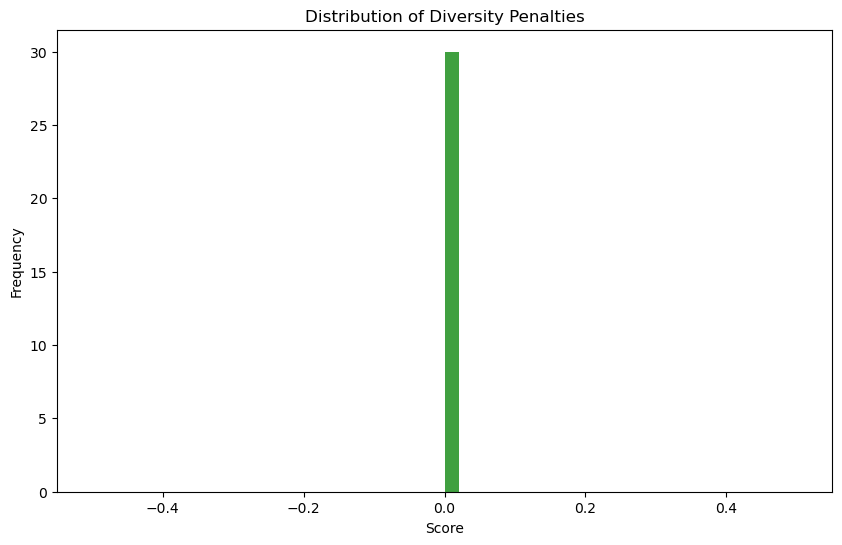

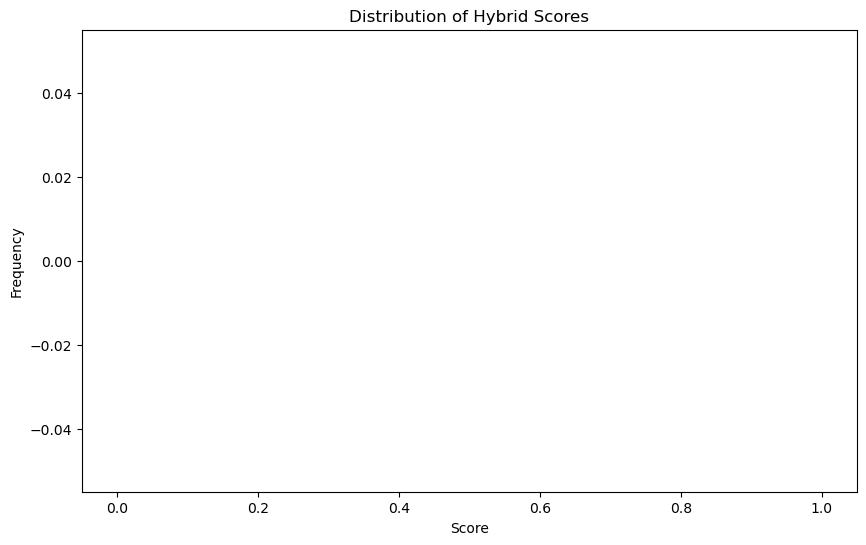

INFO:root:Metrics for top-1 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-2 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}
INFO:root:Metrics for top-3 recommendations: {'RMSE': nan, 'MAE': nan, 'Precision': nan, 'Recall': nan, 'F1 Score': nan}


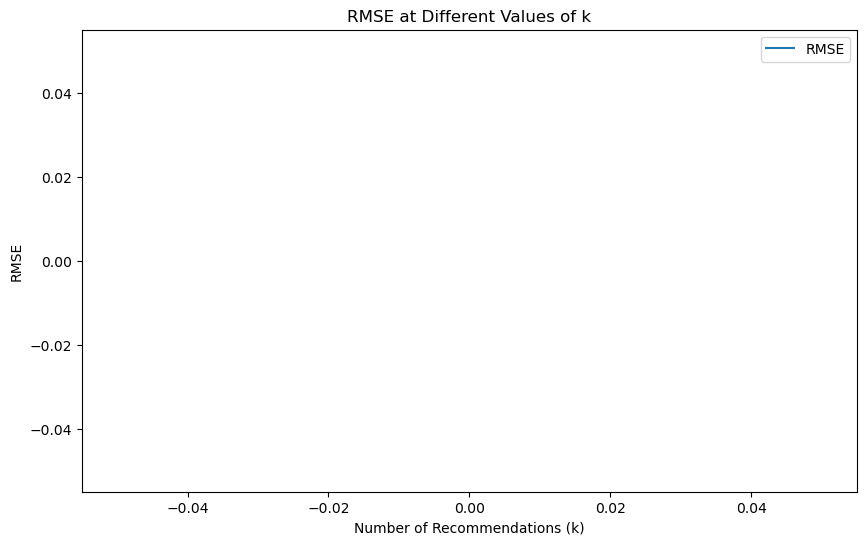

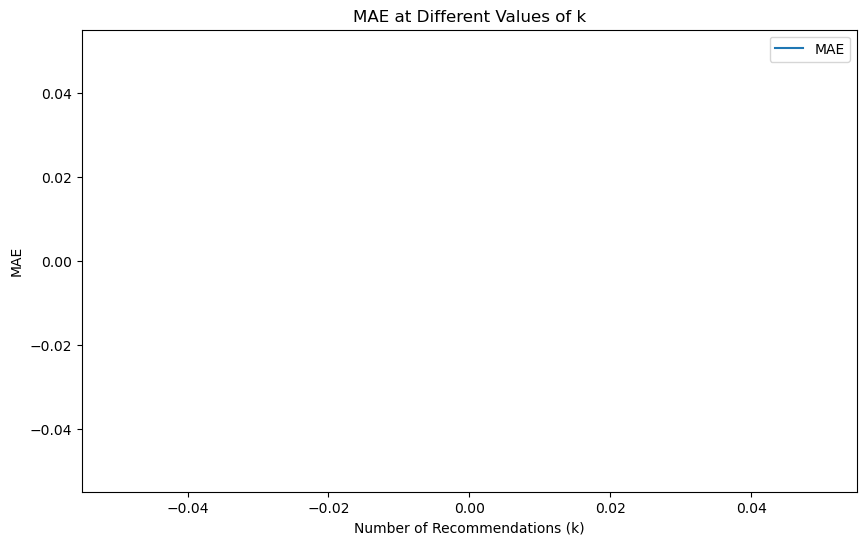

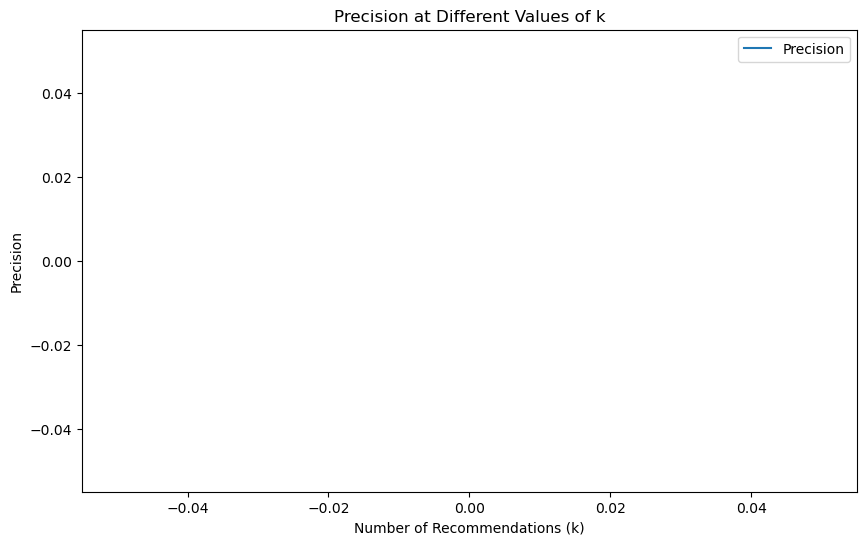

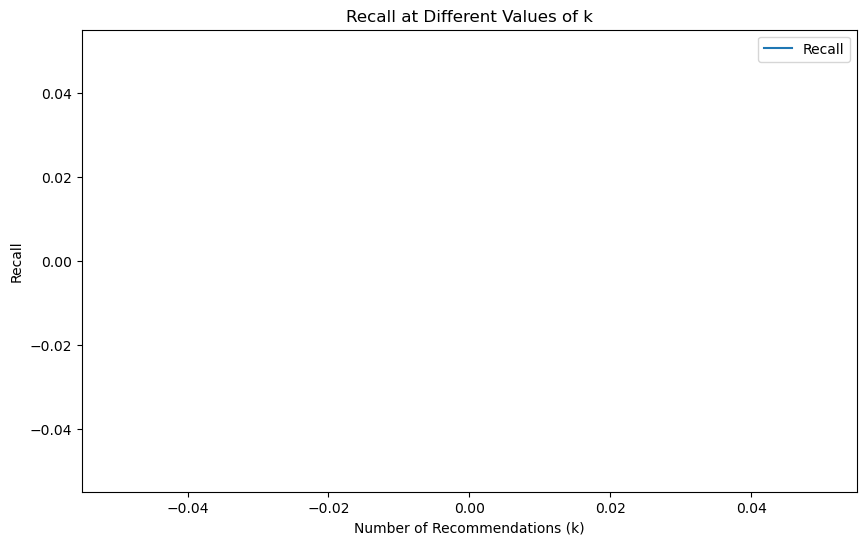

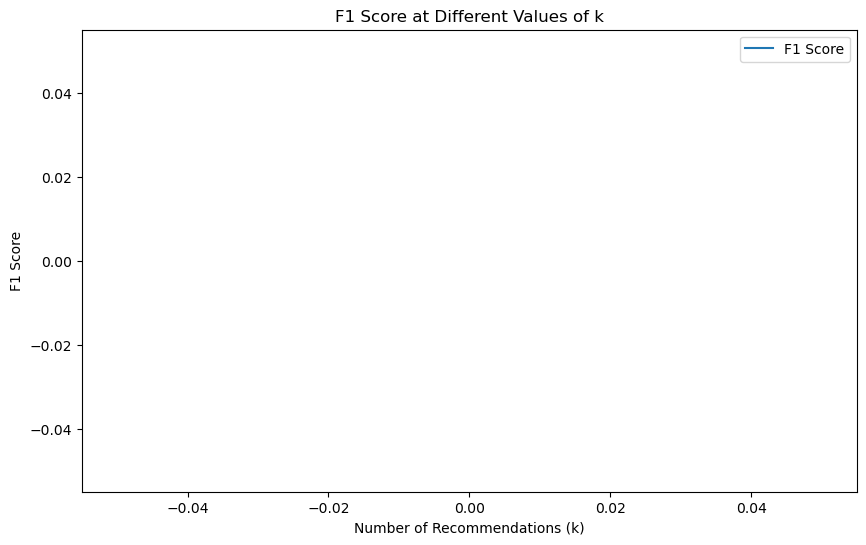

In [46]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    for item_id, _ in recommendations:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        for item_id, predicted_rating in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)
            else:
                logging.debug(f"User {user}, Item {item_id}: Predicted {predicted_rating}, Actual not rated by user")

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_coverage(recommendations, catalog_size):
    recommended_items = set()
    for user, items in recommendations.items():
        recommended_items.update([item_id for item_id, _ in items])
    return len(recommended_items) / catalog_size

def calculate_novelty(recommendations, item_popularity):
    novelty_scores = []
    for user, items in recommendations.items():
        for item_id, _ in items:
            novelty_scores.append(item_popularity.get(item_id, 0))
    return np.mean(novelty_scores)

def calculate_personalization(recommendations):
    user_pairs = list(itertools.combinations(recommendations.keys(), 2))
    similarity_sum = 0
    for user1, user2 in user_pairs:
        items1 = {item_id for item_id, _ in recommendations[user1]}
        items2 = {item_id for item_id, _ in recommendations[user2]}
        similarity_sum += len(items1 & items2) / len(items1 | items2)
    return 1 - (similarity_sum / len(user_pairs))

def calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features):
    serendipity_scores = []
    for user, items in recommendations.items():
        user_prefs = user_preferences.loc[user].to_dict()
        for item_id, _ in items:
            if item_id not in expected_recommendations:
                item_genres = item_features.loc[item_id].to_dict()
                similarity = sum(user_prefs.get(f"user_mean_{genre}", 0) * item_genres.get(genre, 0) for genre in item_genres)
                serendipity_scores.append(1 - similarity)
    return np.mean(serendipity_scores) if serendipity_scores else 0

def calculate_intra_list_similarity(recommendations, item_features):
    diversity_scores = []
    for user, items in recommendations.items():
        features = [item_features.loc[item[0]].values for item in items if item[0] in item_features.index]
        if len(features) > 1:
            distances = pdist(features, 'cosine')
            diversity_scores.append(1 - np.mean(distances))
    return np.mean(diversity_scores) if diversity_scores else 0

def calculate_hit_rate(recommendations, df, n_recommendations):
    hits = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        hits += len(set(item_id for item_id, _ in items).intersection(set(user_rated_items)))
    return hits / (len(recommendations) * n_recommendations)

def calculate_mrr(recommendations, df):
    rr_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        for rank, (item, _) in enumerate(items, start=1):
            if item in user_rated_items:
                rr_sum += 1 / rank
                break
    return rr_sum / len(recommendations)

def calculate_ap(recommendations, df):
    ap_sum = 0
    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user]['movieId'].tolist()
        relevant_items = set(user_rated_items)
        hits = 0
        precision_sum = 0
        for rank, (item, _) in enumerate(items, start=1):
            if item in relevant_items:
                hits += 1
                precision_sum += hits / rank
        ap_sum += precision_sum / min(len(relevant_items), len(items))
    return ap_sum / len(recommendations)

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    serendipity = calculate_serendipity(recommendations, expected_recommendations, user_preferences, item_features)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    hit_rate = calculate_hit_rate(recommendations, df, n_recommendations)
    mrr = calculate_mrr(recommendations, df)
    ap = calculate_ap(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Serendipity: {serendipity:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Hit Rate: {hit_rate:.4f}")
    logging.info(f"Mean Reciprocal Rank (MRR): {mrr:.4f}")
    logging.info(f"Average Precision (AP): {ap:.4f}")

def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.5, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.5, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_scatter(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.scatter(actual_ratings, hybrid_scores, alpha=0.5, color='g')
    plt.xlabel('Actual Ratings')
    plt.ylabel('Hybrid Scores')
    plt.title('Scatter Plot of Actual Ratings vs. Hybrid Scores')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=bins, alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_metrics_over_k(k_values, metrics, metric_name):
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, metrics, label=metric_name)
    plt.xlabel('Number of Recommendations (k)')
    plt.ylabel(metric_name)
    plt.title(f'{metric_name} at Different Values of k')
    plt.legend()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_histogram(all_actual_ratings, all_hybrid_scores)
    plot_scatter(all_actual_ratings, all_hybrid_scores)
    plot_distribution(all_cf_scores, 'Distribution of CF Scores')
    plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
    plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
    plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
    plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')

    k_values = list(range(1, N_RECOMMENDATIONS + 1))
    rmse_values = []
    mae_values = []
    precision_values = []
    recall_values = []
    f1_values = []

    for k in k_values:
        top_k_recommendations = {user: recommendations[user][:k] for user in recommendations}
        metrics = calculate_recommendation_metrics(top_k_recommendations, ratings_df)
        logging.info(f"Metrics for top-{k} recommendations: {metrics}")
        rmse_values.append(metrics['RMSE'])
        mae_values.append(metrics['MAE'])
        precision_values.append(metrics['Precision'])
        recall_values.append(metrics['Recall'])
        f1_values.append(metrics['F1 Score'])

    plot_metrics_over_k(k_values, rmse_values, 'RMSE')
    plot_metrics_over_k(k_values, mae_values, 'MAE')
    plot_metrics_over_k(k_values, precision_values, 'Precision')
    plot_metrics_over_k(k_values, recall_values, 'Recall')
    plot_metrics_over_k(k_values, f1_values, 'F1 Score')

if __name__ == "__main__":
    main()


# clean-up - deleted metrics that are 0, moved graphs to a separate cell

In [60]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    for item_id, _ in recommendations:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    logging.debug(f"User {user_id}, Popularity Penalties: {popularity_penalties}, Diversity Penalties: {diversity_penalties}")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    return {
        'RMSE': rmse,
        'MAE': mae
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        logging.debug(f"User {user}, rated items: {user_rated_items['movieId'].tolist()}")
        for item_id, predicted_rating in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)
            else:
                logging.debug(f"User {user}, Item {item_id}: Predicted {predicted_rating}, Actual not rated by user")

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)

    return {
        'RMSE': rmse,
        'MAE': mae
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

if __name__ == "__main__":
    main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
31       -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
527      -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
647      -0.275679 -0.364349 -0.267487 -0.205677  1.191478  1.490189   
688      -0.275679 -0.364349 -0.267487 -0.205677 -0.839294  1.490189   
720       3.627403 -0.364349 -0.267487 -0.205677 -0.839294 -0.671056   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                                                
31      -0.455396 -0.204908  -0.558481 -0.466382 -0.44


Top 3 recommendations for User 3:
Movie: Saving Private Ryan (1998), Hybrid Score: 4.04
Movie: Silence of the Lambs, The (1991), Hybrid Score: 3.97
Movie: My Neighbor Totoro (Tonari no Totoro) (1988), Hybrid Score: 3.85

Top 3 recommendations for User 7:
Movie: Watchmen (2009), Hybrid Score: 3.74
Movie: Shawshank Redemption, The (1994), Hybrid Score: 3.64
Movie: Children of Men (2006), Hybrid Score: 3.59

Top 3 recommendations for User 11:
Movie: Fight Club (1999), Hybrid Score: 4.32
Movie: Boondock Saints, The (2000), Hybrid Score: 4.26
Movie: Blade Runner (1982), Hybrid Score: 4.24

Top 3 recommendations for User 25:
Movie: Apocalypse Now (1979), Hybrid Score: 4.32
Movie: Seven Samurai (Shichinin no samurai) (1954), Hybrid Score: 4.27
Movie: Lion King, The (1994), Hybrid Score: 4.18

Top 3 recommendations for User 30:
Movie: Spider-Man 2 (2004), Hybrid Score: 4.04
Movie: Lion King, The (1994), Hybrid Score: 4.02
Movie: Harry Potter and the Deathly Hallows: Part 1 (2010), Hybrid Scor

In [69]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 200

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 2.0
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    for item_id, _ in recommendations:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    logging.debug(f"User {user_id}, Popularity Penalties: {popularity_penalties}, Diversity Penalties: {diversity_penalties}")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        logging.debug(f"User {user}, rated items: {user_rated_items['movieId'].tolist()}")
        for item_id, predicted_rating in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)
            else:
                logging.debug(f"User {user}, Item {item_id}: Predicted {predicted_rating}, Actual not rated by user")

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    recommendation_metrics = calculate_recommendation_metrics(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Recommendation RMSE: {recommendation_metrics['RMSE']:.4f}")
    logging.info(f"Recommendation MAE: {recommendation_metrics['MAE']:.4f}")
    logging.info(f"Recommendation Precision: {recommendation_metrics['Precision']:.4f}")
    logging.info(f"Recommendation Recall: {recommendation_metrics['Recall']:.4f}")
    logging.info(f"Recommendation F1 Score: {recommendation_metrics['F1 Score']:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8723
INFO:root:MAE: 0.6699
INFO:root:Precision: 0.8032
INFO:root:Recall: 0.3098
INFO:root:F1 Score: 0.4471
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
1         3.692200  2.768411 -0.288015 -0.197035 -0.834185 -0.672315   
3        -0.270841 -0.361218 -0.288015 -0.197035 -0.834185 -0.672315   
6        -0.270841 -0.361218 -0.288015 -0.197035 -0.834185  1.487399   
47       -0.270841 -0.361218 -0.288015 -0.197035 -0.834185 -0.672315   
50       -0.270841 -0.361218 -0.288015 -0.197035 -0.834185 -0.672315   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       


Top 3 recommendations for User 1:
Movie: Lion King, The (1994), Hybrid Score: 4.04
Movie: Spirited Away (Sen to Chihiro no kamikakushi) (2001), Hybrid Score: 3.99
Movie: Casino Royale (2006), Hybrid Score: 3.98

Top 3 recommendations for User 3:
Movie: Guardians of the Galaxy (2014), Hybrid Score: 3.98
Movie: Apocalypse Now (1979), Hybrid Score: 3.98
Movie: Aliens (1986), Hybrid Score: 3.90

Top 3 recommendations for User 7:
Movie: Princess Bride, The (1987), Hybrid Score: 4.19
Movie: Monty Python and the Holy Grail (1975), Hybrid Score: 4.05
Movie: Skyfall (2012), Hybrid Score: 4.05

Top 3 recommendations for User 10:
Movie: Toy Story 3 (2010), Hybrid Score: 4.49
Movie: Princess Bride, The (1987), Hybrid Score: 4.32
Movie: Lives of Others, The (Das leben der Anderen) (2006), Hybrid Score: 4.22

Top 3 recommendations for User 11:
Movie: Boondock Saints, The (2000), Hybrid Score: 4.56
Movie: Apocalypse Now (1979), Hybrid Score: 4.53
Movie: Dark Knight, The (2008), Hybrid Score: 4.40

T

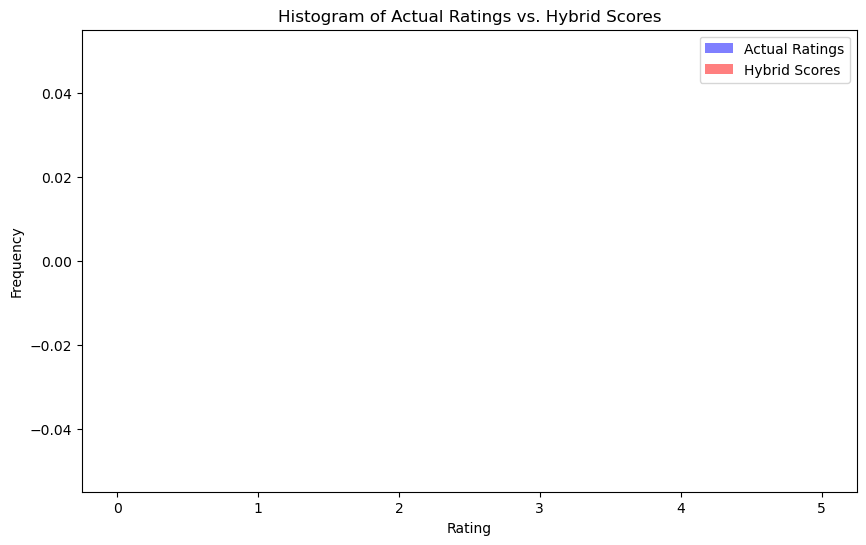

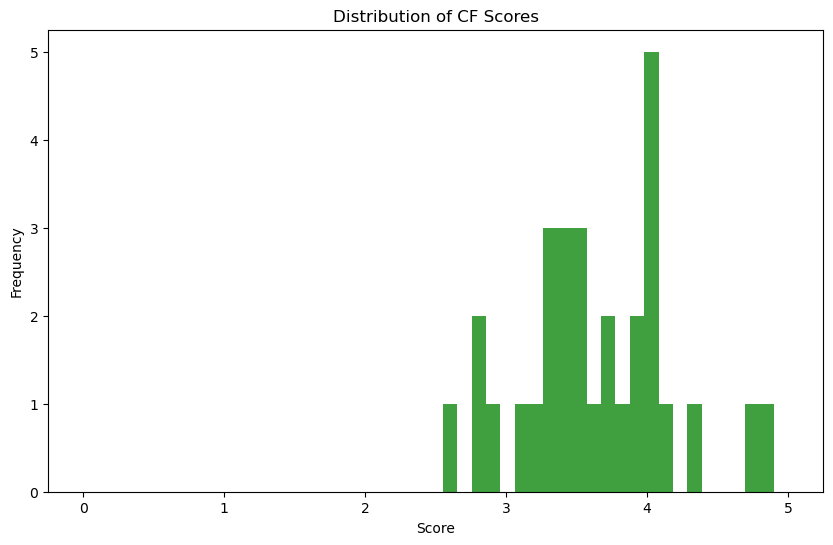

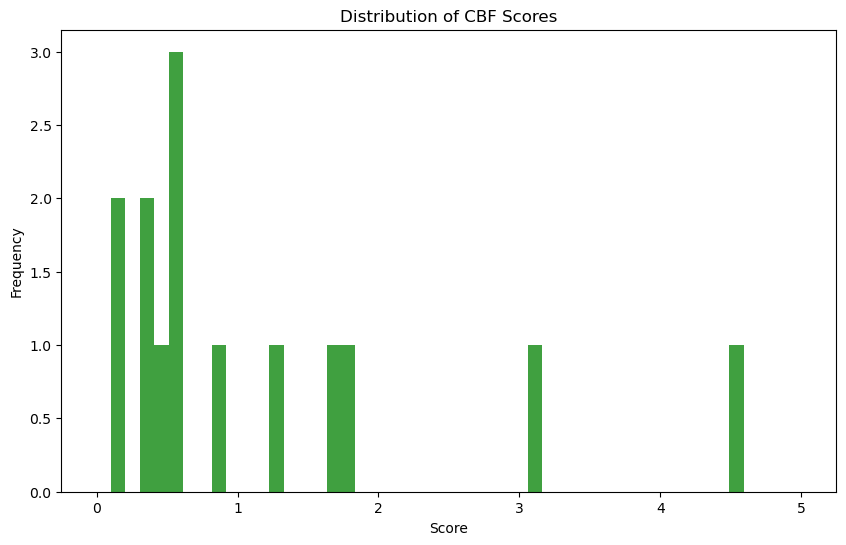

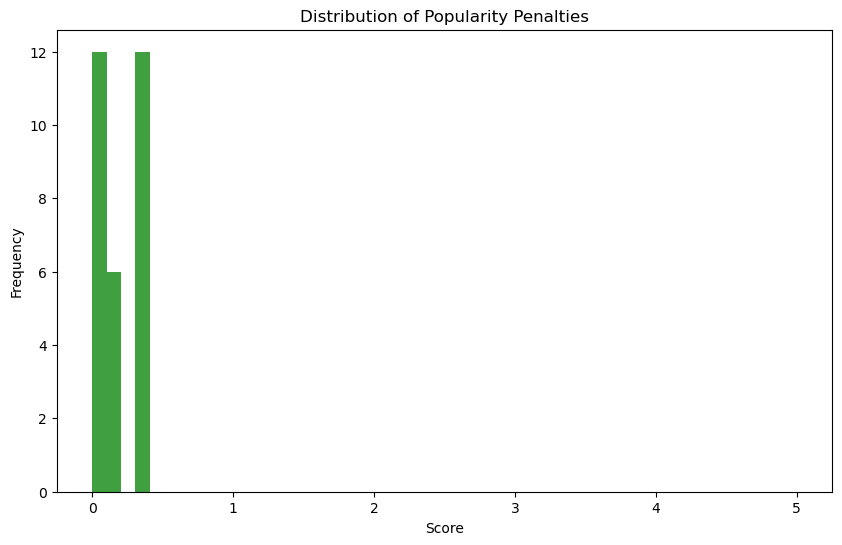

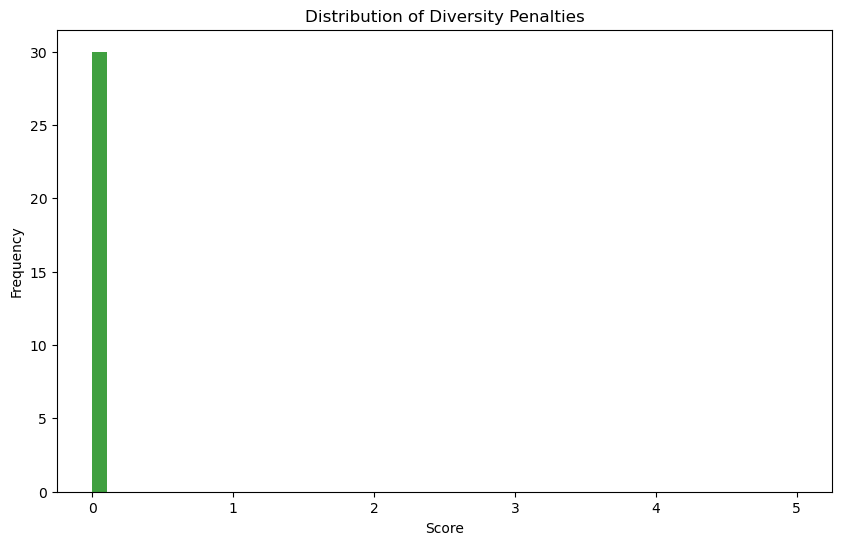

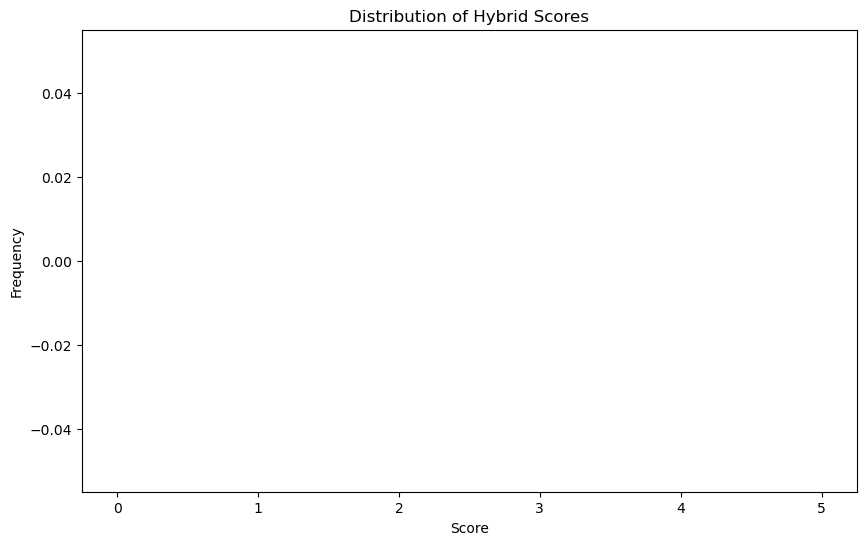

In [71]:
# Plot Histograms
def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.0, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=np.linspace(0.0, 5.0, bins), alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

# Example usage (assuming you have these variables available from the main script)
plot_histogram(all_actual_ratings, all_hybrid_scores)
plot_distribution(all_cf_scores, 'Distribution of CF Scores')
plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')


In [73]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = diversity_counts.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    for item_id, _ in recommendations:
        diversity_counts[item_id] = diversity_counts.get(item_id, 0) + 1

    logging.debug(f"User {user_id}, Popularity Penalties: {popularity_penalties}, Diversity Penalties: {diversity_penalties}")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def calculate_recommendation_metrics(recommendations, df):
    y_true = []
    y_pred = []

    for user, items in recommendations.items():
        user_rated_items = df[df['userId'] == user][['movieId', 'rating']]
        logging.debug(f"User {user}, rated items: {user_rated_items['movieId'].tolist()}")
        for item_id, predicted_rating in items:
            actual_rating = user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values
            if len(actual_rating) > 0:
                y_true.append(actual_rating[0])
                y_pred.append(predicted_rating)
            else:
                logging.debug(f"User {user}, Item {item_id}: Predicted {predicted_rating}, Actual not rated by user")

    if not y_true or not y_pred:
        logging.warning("No matching ratings found for recommended items.")
        return {
            'RMSE': float('nan'),
            'MAE': float('nan'),
            'Precision': float('nan'),
            'Recall': float('nan'),
            'F1 Score': float('nan')
        }

    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    precision = precision_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    recall = recall_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)
    f1 = f1_score([1 if y >= RATING_THRESHOLD else 0 for y in y_true], [1 if y >= RATING_THRESHOLD else 0 for y in y_pred], zero_division=0)

    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)
    recommendation_metrics = calculate_recommendation_metrics(recommendations, df)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")
    logging.info(f"Recommendation RMSE: {recommendation_metrics['RMSE']:.4f}")
    logging.info(f"Recommendation MAE: {recommendation_metrics['MAE']:.4f}")
    logging.info(f"Recommendation Precision: {recommendation_metrics['Precision']:.4f}")
    logging.info(f"Recommendation Recall: {recommendation_metrics['Recall']:.4f}")
    logging.info(f"Recommendation F1 Score: {recommendation_metrics['F1 Score']:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, diversity_counts, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Fantasy    Horror   Musical     Drama    Action  \
movieId                                                                
31       -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
527      -0.275679 -0.364349 -0.267487 -0.205677  1.191478 -0.671056   
647      -0.275679 -0.364349 -0.267487 -0.205677  1.191478  1.490189   
688      -0.275679 -0.364349 -0.267487 -0.205677 -0.839294  1.490189   
720       3.627403 -0.364349 -0.267487 -0.205677 -0.839294 -0.671056   

           Sci-Fi      IMAX  Adventure   Romance     Crime    Comedy  \
movieId                                       


Top 3 recommendations for User 3:
Movie: Saving Private Ryan (1998), Hybrid Score: 4.04
Movie: Silence of the Lambs, The (1991), Hybrid Score: 3.97
Movie: My Neighbor Totoro (Tonari no Totoro) (1988), Hybrid Score: 3.85

Top 3 recommendations for User 7:
Movie: Watchmen (2009), Hybrid Score: 3.74
Movie: Shawshank Redemption, The (1994), Hybrid Score: 3.64
Movie: Children of Men (2006), Hybrid Score: 3.59

Top 3 recommendations for User 11:
Movie: Fight Club (1999), Hybrid Score: 4.32
Movie: Boondock Saints, The (2000), Hybrid Score: 4.26
Movie: Blade Runner (1982), Hybrid Score: 4.24

Top 3 recommendations for User 25:
Movie: Apocalypse Now (1979), Hybrid Score: 4.32
Movie: Seven Samurai (Shichinin no samurai) (1954), Hybrid Score: 4.27
Movie: Lion King, The (1994), Hybrid Score: 4.18

Top 3 recommendations for User 30:
Movie: Spider-Man 2 (2004), Hybrid Score: 4.04
Movie: Lion King, The (1994), Hybrid Score: 4.02
Movie: Harry Potter and the Deathly Hallows: Part 1 (2010), Hybrid Scor

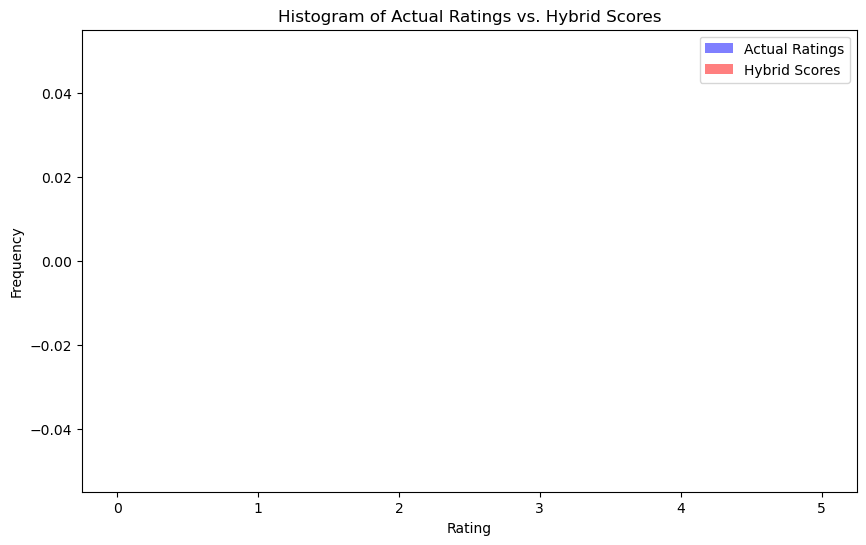

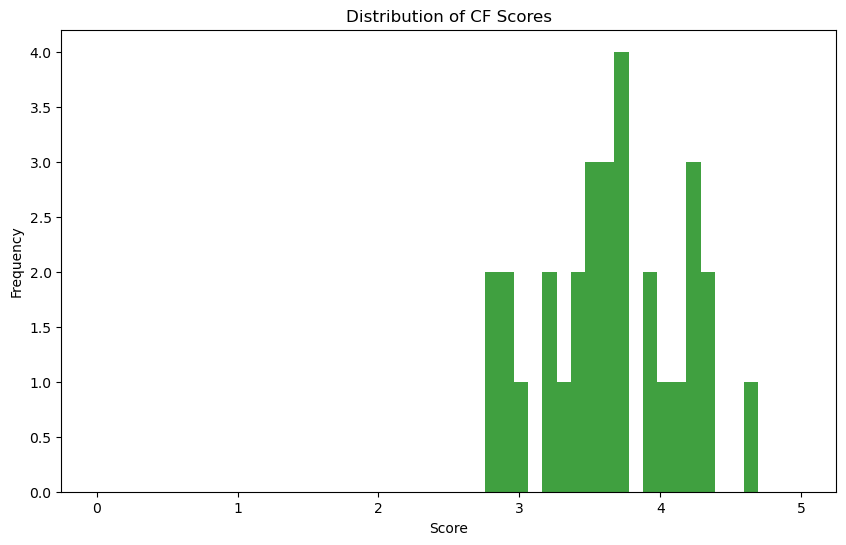

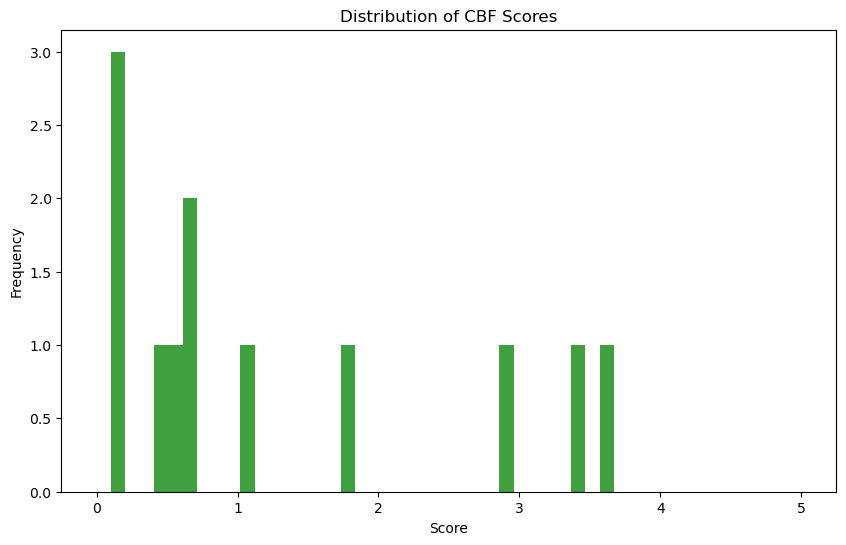

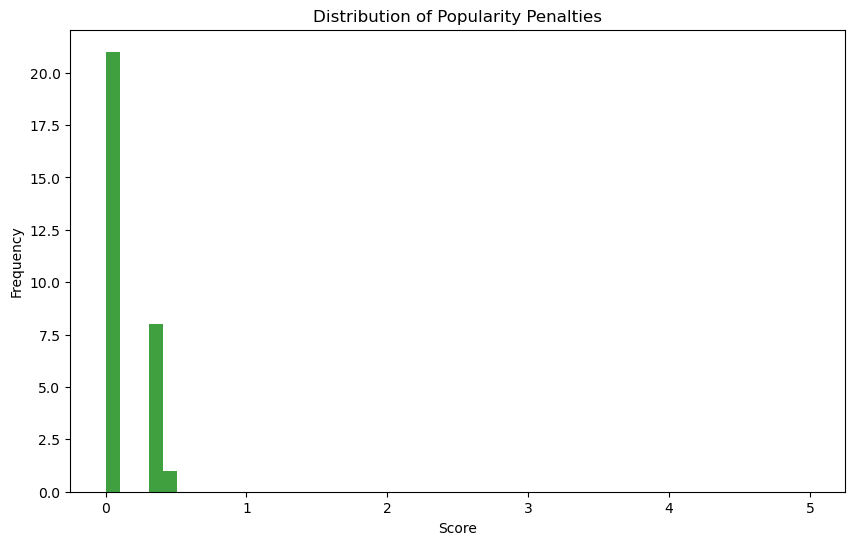

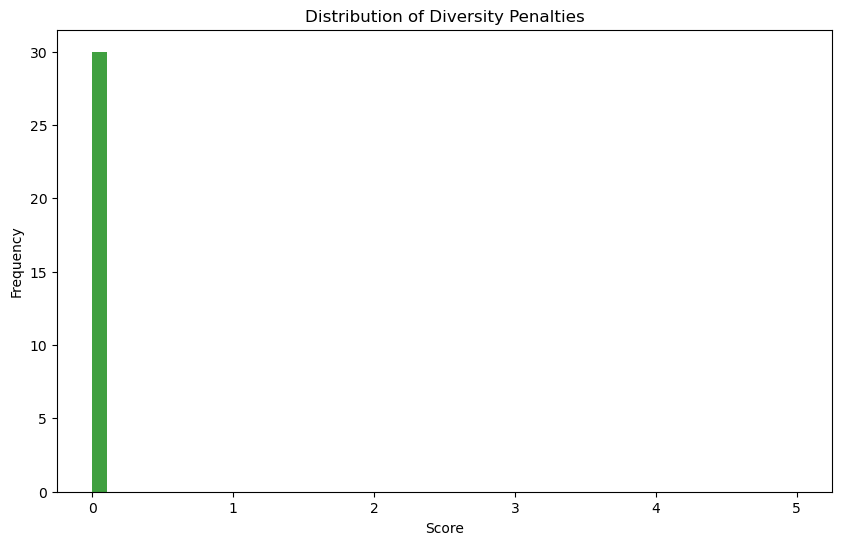

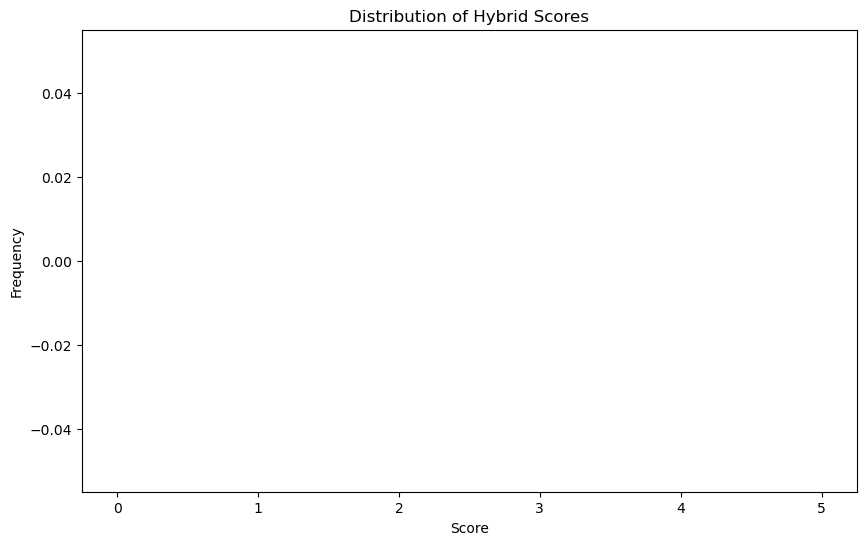

In [75]:
# Plot Histograms
def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.0, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=np.linspace(0.0, 5.0, bins), alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

# Example usage (assuming you have these variables available from the main script)
plot_histogram(all_actual_ratings, all_hybrid_scores)
plot_distribution(all_cf_scores, 'Distribution of CF Scores')
plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
plot_distribution(all_hybrid_scores, 'Distribution of Hybrid Scores')


# FINAL FOR NOW
## still need to fix cf and cbd distributuions and calculation of diversity penalty. 

In [1]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
        pairwise_distances = pdist(feature_vectors, metric='cosine')
        penalty = np.mean(pairwise_distances)
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:             Crime       War  Film-Noir      IMAX  Children  Documentary  \
movieId                                                                   
31      -0.446868 -0.220471  -0.086753 -0.204908 -0.310587    -0.112469   
527     -0.446868  4.535743  -0.086753 -0.204908 -0.310587    -0.112469   
647      2.237796  4.535743  -0.086753 -0.204908 -0.310587    -0.112469   
688     -0.446868  4.535743  -0.086753 -0.204908 -0.310587    -0.112469   
720     -0.446868 -0.220471  -0.086753 -0.204908 -0.310587    -0.112469   

         Thriller    Horror   Mystery  Adventure   Musical   Romance  Western  \
movieId         

KeyboardInterrupt: 

In [ ]:
# Plot Distributions
def plot_distributions(actual_ratings, hybrid_scores, cf_scores, cbf_scores):
    plt.figure(figsize=(12, 8))

    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.hist(cf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CF Scores', color='b')
    plt.hist(cbf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CBF Scores', color='g')

    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.title('Distributions of Hybrid Scores, CF Scores, and CBF Scores')
    plt.legend(loc='upper right')
    plt.show()

# Example usage (assuming you have these variables available from the main script)
plot_distributions(all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores)


In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import cosine
from sklearn.preprocessing import StandardScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        pairwise_distances = []
        feature_vectors = [item_features.loc[item_id].values for item_id, _ in recommendations]
        for i in range(len(feature_vectors)):
            for j in range(i + 1, len(feature_vectors)):
                distance = cosine(feature_vectors[i], feature_vectors[j])
                pairwise_distances.append(distance)
        penalty = np.mean(pairwise_distances)
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=False)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children    Action     Drama       War   Musical  Animation  Western  \
movieId                                                                         
31      -0.310587 -0.671056  1.191478 -0.220471 -0.205677  -0.275679 -0.12926   
527     -0.310587 -0.671056  1.191478  4.535743 -0.205677  -0.275679 -0.12926   
647     -0.310587  1.490189  1.191478  4.535743 -0.205677  -0.275679 -0.12926   
688     -0.310587  1.490189 -0.839294  4.535743 -0.205677  -0.275679 -0.12926   
720     -0.310587 -0.671056 -0.839294 -0.220471 -0.205677   3.627403 -0.12926   

         Documentary    Comedy  Film-Noir     Crime  Th

In [ ]:
# Plot Distributions
def plot_distributions(hybrid_scores, cf_scores, cbf_scores):
    plt.figure(figsize=(12, 8))

    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.hist(cf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CF Scores', color='b')
    plt.hist(cbf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CBF Scores', color='g')

    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.title('Distributions of Hybrid Scores, CF Scores, and CBF Scores')
    plt.legend(loc='upper right')
    plt.show()

# Example usage (assuming you have these variables available from the main script)
plot_distributions(all_hybrid_scores, all_cf_scores, all_cbf_scores)


In [ ]:
# Define industry ranges for the metrics
industry_ranges = {
    'RMSE': (0.85, 0.95),       # Min and max RMSE in industry
    'MAE': (0.70, 0.75),        # Min and max MAE in industry
    'Precision': (0.70, 0.80),  # Min and max precision in industry
    'Recall': (0.10, 0.40),     # Min and max recall in industry
    'F1 Score': (0.30, 0.50),   # Min and max F1 score in industry
}

# Calculate the model metrics for the entire dataset
def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

# Compute the metrics for the entire population
predictions = algo.test(trainset.build_testset())
model_metrics = calculate_model_metrics(predictions)

# Plot the metrics against industry standards
metrics = list(model_metrics.keys())
x = np.arange(len(metrics))  # label locations
bar_width = 0.35  # width of the bars

fig, ax = plt.subplots(figsize=(10, 6))

# Plotting bars for model metrics
ax.bar(x, [model_metrics[metric] for metric in metrics], width=bar_width, color='lightblue', label='Model Metrics')

# Calculate means and error margins for industry standards
industry_means = [(industry_ranges[metric][0] + industry_ranges[metric][1]) / 2 for metric in metrics]
industry_errors = [(industry_ranges[metric][1] - industry_ranges[metric][0]) / 2 for metric in metrics]

# Adding error bars to indicate the range of industry standards
ax.errorbar(x + bar_width / 2, industry_means, yerr=industry_errors, fmt='o', color='red', capsize=5, label='Industry Range')

# Adding labels, title, and custom x-axis tick labels
ax.set_ylabel('Values')
ax.set_title('Model Metrics vs Industry Ranges')
ax.set_xticks(x + bar_width / 2)
ax.set_xticklabels(metrics)
ax.set_ylim(0, 1)  # Setting the y-limit to encompass typical ranges for these metrics
ax.legend()

plt.tight_layout()
plt.show()

# Print the computed model metrics
print("Model Evaluation Metrics:")
print(model_metrics)


In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import cosine
from sklearn.preprocessing import StandardScaler
import time

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        pairwise_distances = []
        feature_vectors = [item_features.loc[item_id].values for item_id, _ in recommendations]
        for i in range(len(feature_vectors)):
            for j in range(i + 1, len(feature_vectors)):
                distance = cosine(feature_vectors[i], feature_vectors[j])
                pairwise_distances.append(distance)
        penalty = np.mean(pairwise_distances)
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:            Action  Documentary   Mystery  Adventure       War    Comedy  \
movieId                                                                   
31      -0.671056    -0.112469 -0.284724  -0.558481 -0.220471 -0.813972   
527     -0.671056    -0.112469 -0.284724  -0.558481  4.535743 -0.813972   
647      1.490189    -0.112469 -0.284724  -0.558481  4.535743 -0.813972   
688      1.490189    -0.112469 -0.284724   1.790571  4.535743  1.228544   
720     -0.671056    -0.112469 -0.284724   1.790571 -0.220471  1.228544   

         Film-Noir     Crime    Sci-Fi      IMAX   Fantasy  Thriller  \
movieId                  

In [ ]:
# Define industry ranges for the metrics
industry_ranges = {
    'RMSE': (0.85, 0.95),       # Min and max RMSE in industry
    'MAE': (0.70, 0.75),        # Min and max MAE in industry
    'Precision': (0.70, 0.80),  # Min and max precision in industry
    'Recall': (0.10, 0.40),     # Min and max recall in industry
    'F1 Score': (0.30, 0.50),   # Min and max F1 score in industry
}

# Calculate the model metrics for the entire dataset
predictions = algo.test(trainset.build_testset())
model_metrics = calculate_model_metrics(predictions)

# Plot the metrics against industry standards
metrics = list(model_metrics.keys())
x = np.arange(len(metrics))  # label locations
bar_width = 0.35  # width of the bars

fig, ax = plt.subplots(figsize=(10, 6))

# Plotting bars for model metrics
ax.bar(x, [model_metrics[metric] for metric in metrics], width=bar_width, color='lightblue', label='Model Metrics')

# Calculate means and error margins for industry standards
industry_means = [(industry_ranges[metric][0] + industry_ranges[metric][1]) / 2 for metric in metrics]
industry_errors = [(industry_ranges[metric][1] - industry_ranges[metric][0]) / 2 for metric in metrics]

# Adding error bars to indicate the range of industry standards
ax.errorbar(x + bar_width / 2, industry_means, yerr=industry_errors, fmt='o', color='red', capsize=5, label='Industry Range')

# Adding labels, title, and custom x-axis tick labels
ax.set_ylabel('Values')
ax.set_title('Model Metrics vs Industry Ranges')
ax.set_xticks(x + bar_width / 2)
ax.set_xticklabels(metrics)
ax.set_ylim(0, 1)  # Setting the y-limit to encompass typical ranges for these metrics
ax.legend()

plt.tight_layout()
plt.show()

# Print the computed model metrics
print("Model Evaluation Metrics:")
print(model_metrics)


In [ ]:
# Plot Distributions and Histogram
def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.0, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=np.linspace(0.0, 5.0, bins), alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_distributions(hybrid_scores, cf_scores, cbf_scores):
    plt.figure(figsize=(12, 8))
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.hist(cf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CF Scores', color='b')
    plt.hist(cbf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CBF Scores', color='g')
    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.title('Distributions of Hybrid Scores, CF Scores, and CBF Scores')
    plt.legend(loc='upper right')
    plt.show()

# Example usage (assuming you have these variables available from the main script)
plot_histogram(all_actual_ratings, all_hybrid_scores)
plot_distribution(all_cf_scores, 'Distribution of CF Scores')
plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
plot_distributions(all_hybrid_scores, all_cf_scores, all_cbf_scores)


In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist, cosine
from sklearn.preprocessing import StandardScaler
import time

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
        pairwise_distances = pdist(feature_vectors, 'cosine')
        penalty = np.mean(pairwise_distances)
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8669
INFO:root:MAE: 0.6679
INFO:root:Precision: 0.8151
INFO:root:Recall: 0.2624
INFO:root:F1 Score: 0.3970
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Film-Noir     Drama  Western      IMAX  Animation       War  \
movieId                                                                
31       -0.086753  1.191478 -0.12926 -0.204908  -0.275679 -0.220471   
527      -0.086753  1.191478 -0.12926 -0.204908  -0.275679  4.535743   
647      -0.086753  1.191478 -0.12926 -0.204908  -0.275679  4.535743   
688      -0.086753 -0.839294 -0.12926 -0.204908  -0.275679  4.535743   
720      -0.086753 -0.839294 -0.12926 -0.204908   3.627403 -0.220471   

          Fantasy   Romance    Comedy   Musical    Horror  Children   Mystery  \
movieId                              

In [1]:
# Plot Distributions and Histogram
def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.0, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=np.linspace(0.0, 5.0, bins), alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_distributions(hybrid_scores, cf_scores, cbf_scores):
    plt.figure(figsize=(12, 8))
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.hist(cf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CF Scores', color='b')
    plt.hist(cbf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CBF Scores', color='g')
    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.title('Distributions of Hybrid Scores, CF Scores, and CBF Scores')
    plt.legend(loc='upper right')
    plt.show()

# Example usage (assuming you have these variables available from the main script)
plot_histogram(all_actual_ratings, all_hybrid_scores)
plot_distribution(all_cf_scores, 'Distribution of CF Scores')
plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
plot_distributions(all_hybrid_scores, all_cf_scores, all_cbf_scores)


NameError: name 'all_actual_ratings' is not defined

In [3]:
# Define industry ranges for the metrics
industry_ranges = {
    'RMSE': (0.85, 0.95),       # Min and max RMSE in industry
    'MAE': (0.70, 0.75),        # Min and max MAE in industry
    'Precision': (0.70, 0.80),  # Min and max precision in industry
    'Recall': (0.10, 0.40),     # Min and max recall in industry
    'F1 Score': (0.30, 0.50),   # Min and max F1 score in industry
}

# Calculate the model metrics for the entire dataset
predictions = algo.test(trainset.build_testset())
model_metrics = calculate_model_metrics(predictions)

# Plot the metrics against industry standards
metrics = list(model_metrics.keys())
x = np.arange(len(metrics))  # label locations
bar_width = 0.35  # width of the bars

fig, ax = plt.subplots(figsize=(10, 6))

# Plotting bars for model metrics
ax.bar(x, [model_metrics[metric] for metric in metrics], width=bar_width, color='lightblue', label='Model Metrics')

# Calculate means and error margins for industry standards
industry_means = [(industry_ranges[metric][0] + industry_ranges[metric][1]) / 2 for metric in metrics]
industry_errors = [(industry_ranges[metric][1] - industry_ranges[metric][0]) / 2 for metric in metrics]

# Adding error bars to indicate the range of industry standards
ax.errorbar(x + bar_width / 2, industry_means, yerr=industry_errors, fmt='o', color='red', capsize=5, label='Industry Range')

# Adding labels, title, and custom x-axis tick labels
ax.set_ylabel('Values')
ax.set_title('Model Metrics vs Industry Ranges')
ax.set_xticks(x + bar_width / 2)
ax.set_xticklabels(metrics)
ax.set_ylim(0, 1)  # Setting the y-limit to encompass typical ranges for these metrics
ax.legend()

plt.tight_layout()
plt.show()

# Print the computed model metrics
print("Model Evaluation Metrics:")
print(model_metrics)


NameError: name 'algo' is not defined

In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist, cosine
from sklearn.preprocessing import StandardScaler
import time
from functools import lru_cache

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 30

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file, user_sample_size=None):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')
        
        if user_sample_size:
            unique_users = ratings_df['userId'].drop_duplicates()
            actual_sample_size = min(user_sample_size, len(unique_users))
            sampled_users = unique_users.sample(n=actual_sample_size, random_state=RANDOM_SEED)
            ratings_df = ratings_df[ratings_df['userId'].isin(sampled_users)]
        
        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)
        
        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)
        
        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

@lru_cache(maxsize=None)
def calculate_pairwise_distances(feature_vectors):
    pairwise_distances = pdist(feature_vectors, 'cosine')
    return np.mean(pairwise_distances)

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
        penalty = calculate_pairwise_distances(tuple(map(tuple, feature_vectors)))
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE, USER_SAMPLE_SIZE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8842
INFO:root:MAE: 0.6863
INFO:root:Precision: 0.8346
INFO:root:Recall: 0.1501
INFO:root:F1 Score: 0.2545
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:           Mystery    Sci-Fi  Adventure   Western  Children  Animation  \
movieId                                                                 
31      -0.275197 -0.465052  -0.569793 -0.128045 -0.343955  -0.302887   
527     -0.275197 -0.465052  -0.569793 -0.128045 -0.343955  -0.302887   
647     -0.275197 -0.465052  -0.569793 -0.128045 -0.343955  -0.302887   
688     -0.275197 -0.465052   1.755022 -0.128045 -0.343955  -0.302887   
720     -0.275197 -0.465052   1.755022 -0.128045 -0.343955   3.301560   

         Film-Noir     Crime  Documentary   Romance   Musical  Thriller  \
movieId                             

In [ ]:
# Plot Distributions and Histogram
def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.0, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=np.linspace(0.0, 5.0, bins), alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_distributions(hybrid_scores, cf_scores, cbf_scores):
    plt.figure(figsize=(12, 8))
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.hist(cf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CF Scores', color='b')
    plt.hist(cbf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CBF Scores', color='g')
    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.title('Distributions of Hybrid Scores, CF Scores, and CBF Scores')
    plt.legend(loc='upper right')
    plt.show()

# Example usage (assuming you have these variables available from the main script)
plot_histogram(all_actual_ratings, all_hybrid_scores)
plot_distribution(all_cf_scores, 'Distribution of CF Scores')
plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
plot_distributions(all_hybrid_scores, all_cf_scores, all_cbf_scores)


In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist, cosine
from sklearn.preprocessing import StandardScaler
import time
from functools import lru_cache

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 5.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
# USER_SAMPLE_SIZE = 100  # Remove this if you want to use the full dataset

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.5

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

@lru_cache(maxsize=None)
def calculate_pairwise_distances(feature_vectors):
    pairwise_distances = pdist(feature_vectors, 'cosine')
    return np.mean(pairwise_distances)

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
        penalty = calculate_pairwise_distances(tuple(map(tuple, feature_vectors)))
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:           Musical  Film-Noir   Mystery      IMAX  Animation     Crime  \
movieId                                                                 
1       -0.206865   -0.09329 -0.287006 -0.207047   3.664680 -0.445216   
3       -0.206865   -0.09329 -0.287006 -0.207047  -0.272875 -0.445216   
6       -0.206865   -0.09329 -0.287006 -0.207047  -0.272875  2.246099   
47      -0.206865   -0.09329  3.484244 -0.207047  -0.272875 -0.445216   
50      -0.206865   -0.09329  3.484244 -0.207047  -0.272875  2.246099   

          Romance  Children     Drama       War   Fantasy  Adventure  \
movieId                                

In [ ]:
# Plot Distributions and Histogram
def plot_histogram(actual_ratings, hybrid_scores):
    plt.figure(figsize=(10, 6))
    plt.hist(actual_ratings, bins=np.arange(0.0, 5.5, 0.5), alpha=0.5, label='Actual Ratings', color='b')
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')
    plt.title('Histogram of Actual Ratings vs. Hybrid Scores')
    plt.legend(loc='upper right')
    plt.show()

def plot_distribution(data, title, xlabel='Score', ylabel='Frequency', bins=50):
    plt.figure(figsize=(10, 6))
    plt.hist(data, bins=np.linspace(0.0, 5.0, bins), alpha=0.75, color='g')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title(title)
    plt.show()

def plot_distributions(hybrid_scores, cf_scores, cbf_scores):
    plt.figure(figsize=(12, 8))
    plt.hist(hybrid_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='Hybrid Scores', color='r')
    plt.hist(cf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CF Scores', color='b')
    plt.hist(cbf_scores, bins=np.linspace(0.0, 5.0, 50), alpha=0.5, label='CBF Scores', color='g')
    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.title('Distributions of Hybrid Scores, CF Scores, and CBF Scores')
    plt.legend(loc='upper right')
    plt.show()

# Example usage (assuming you have these variables available from the main script)
plot_histogram(all_actual_ratings, all_hybrid_scores)
plot_distribution(all_cf_scores, 'Distribution of CF Scores')
plot_distribution(all_cbf_scores, 'Distribution of CBF Scores')
plot_distribution(all_popularity_penalties, 'Distribution of Popularity Penalties')
plot_distribution(all_diversity_penalties, 'Distribution of Diversity Penalties')
plot_distributions(all_hybrid_scores, all_cf_scores, all_cbf_scores)


# faster processing

In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist, cosine
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed



# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
# USER_SAMPLE_SIZE = 100  # Remove this if you want to use the full dataset
BATCH_SIZE = 300  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_batch_diversity_penalty(feature_vectors):
    pairwise_distances = []
    for i in range(len(feature_vectors)):
        for j in range(i + 1, len(feature_vectors)):
            distance = cosine(feature_vectors[i], feature_vectors[j])
            pairwise_distances.append(distance)
    return np.mean(pairwise_distances) if pairwise_distances else 0

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
        
        if len(feature_vectors) > BATCH_SIZE:
            penalties = Parallel(n_jobs=-1)(delayed(calculate_batch_diversity_penalty)(feature_vectors[i:i + BATCH_SIZE])
                                            for i in range(0, len(feature_vectors), BATCH_SIZE))
            penalty = np.mean(penalties)
        else:
            penalty = calculate_batch_diversity_penalty(feature_vectors)
            
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:           Mystery   Fantasy  Thriller       War     Crime  Documentary  \
movieId                                                                  
1       -0.287006  2.742421 -0.596334 -0.225004 -0.445216     -0.11062   
3       -0.287006 -0.364641 -0.596334 -0.225004 -0.445216     -0.11062   
6       -0.287006 -0.364641  1.676913 -0.225004  2.246099     -0.11062   
47       3.484244 -0.364641  1.676913 -0.225004 -0.445216     -0.11062   
50       3.484244 -0.364641  1.676913 -0.225004  2.246099     -0.11062   

         Film-Noir   Romance  Animation   Western   Musical    Comedy  \
movieId                        

In [1]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist, cosine
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
# USER_SAMPLE_SIZE = 100  # Remove this if you want to use the full dataset
BATCH_SIZE = 100  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    ratings_df['time_weighted_rating'] = ratings_df['rating'] * ratings_df['time_weight']
    
    min_rating, max_rating = ratings_df['time_weighted_rating'].min(), ratings_df['time_weighted_rating'].max()
    if min_rating != max_rating:
        ratings_df['time_weighted_rating'] = 5.0 * (ratings_df['time_weighted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['time_weighted_rating'] = ratings_df['time_weighted_rating'].clip(0.5, 5.0)
    ratings_df['time_weighted_rating'] = (ratings_df['time_weighted_rating'] * 2).round() / 2
    
    return ratings_df

def add_year_feature(df, year_divisor):
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)  # Ensure no negative values
    return df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_batch_diversity_penalty(feature_vectors):
    pairwise_distances = []
    for i in range(len(feature_vectors)):
        for j in range(i + 1, len(feature_vectors)):
            distance = cosine(feature_vectors[i], feature_vectors[j])
            pairwise_distances.append(distance)
    return np.mean(pairwise_distances) if pairwise_distances else 0

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
        
        if len(feature_vectors) > BATCH_SIZE:
            penalties = Parallel(n_jobs=-1)(delayed(calculate_batch_diversity_penalty)(feature_vectors[i:i + BATCH_SIZE])
                                            for i in range(0, len(feature_vectors), BATCH_SIZE))
            penalty = np.mean(penalties)
        else:
            penalty = calculate_batch_diversity_penalty(feature_vectors)
            
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR)
    
    # Add year feature
    merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'time_weighted_rating', 'years_since_release']]
    
    merged_df = standardize_features(merged_df, genre_columns + ['years_since_release'])
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns + ['years_since_release'])
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:           Mystery  Film-Noir  Children    Action       War    Comedy  \
movieId                                                                
1       -0.287006   -0.09329  3.154507 -0.660598 -0.225004  1.257788   
3       -0.287006   -0.09329 -0.317007 -0.660598 -0.225004  1.257788   
6       -0.287006   -0.09329 -0.317007  1.513780 -0.225004 -0.795047   
47       3.484244   -0.09329 -0.317007 -0.660598 -0.225004 -0.795047   
50       3.484244   -0.09329 -0.317007 -0.660598 -0.225004 -0.795047   

            Drama    Sci-Fi  Thriller     Crime      IMAX   Romance  \
movieId                                        

KeyboardInterrupt: 

# LAST WORKING VERSION

In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import pdist, cosine
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None


def apply_time_decay(ratings_df, decay_factor, year_divisor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    
    # Adjust for the time since the movie's release year
    ratings_df['year_diff'] = (current_time.year - ratings_df['release_year']) / year_divisor
    ratings_df['adjusted_rating'] = ratings_df['rating'] * ratings_df['time_weight'] / (1 + ratings_df['year_diff'])
    
    min_rating, max_rating = ratings_df['adjusted_rating'].min(), ratings_df['adjusted_rating'].max()
    if min_rating != max_rating:
        ratings_df['adjusted_rating'] = 5.0 * (ratings_df['adjusted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['adjusted_rating'] = ratings_df['adjusted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['adjusted_rating'] = ratings_df['adjusted_rating'].clip(0.5, 5.0)
    ratings_df['adjusted_rating'] = (ratings_df['adjusted_rating'] * 2).round() / 2
    
    return ratings_df
    
    

def add_year_feature(df, year_divisor):
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)  # Ensure no negative values
    return df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_batch_diversity_penalty(feature_vectors):
    pairwise_distances = []
    for i in range(len(feature_vectors)):
        for j in range(i + 1, len(feature_vectors)):
            distance = cosine(feature_vectors[i], feature_vectors[j])
            pairwise_distances.append(distance)
    return np.mean(pairwise_distances) if pairwise_distances else 0

def calculate_diversity_penalty(recommendations, item_features):
    penalty = 0
    if len(recommendations) > 1:
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
        
        if len(feature_vectors) > BATCH_SIZE:
            penalties = Parallel(n_jobs=-1)(delayed(calculate_batch_diversity_penalty)(feature_vectors[i:i + BATCH_SIZE])
                                            for i in range(0, len(feature_vectors), BATCH_SIZE))
            penalty = np.mean(penalties)
        else:
            penalty = calculate_batch_diversity_penalty(feature_vectors)
            
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:             Crime  Animation    Sci-Fi      IMAX  Children   Fantasy  \
movieId                                                                
1       -0.445216   3.664680 -0.454173 -0.207047  3.154507  2.742421   
3       -0.445216  -0.272875 -0.454173 -0.207047 -0.317007 -0.364641   
6        2.246099  -0.272875 -0.454173 -0.207047 -0.317007 -0.364641   
47      -0.445216  -0.272875 -0.454173 -0.207047 -0.317007 -0.364641   
50       2.246099  -0.272875 -0.454173 -0.207047 -0.317007 -0.364641   

          Western    Comedy  Adventure   Mystery  Documentary   Romance  \
movieId                                    

In [1]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from scipy.spatial.distance import cdist
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.7

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    
    # Adjust for the time since the movie's release year
    ratings_df['year_diff'] = (current_time.year - ratings_df['release_year']) / year_divisor
    ratings_df['adjusted_rating'] = ratings_df['rating'] * ratings_df['time_weight'] / (1 + ratings_df['year_diff'])
    
    min_rating, max_rating = ratings_df['adjusted_rating'].min(), ratings_df['adjusted_rating'].max()
    if min_rating != max_rating:
        ratings_df['adjusted_rating'] = 5.0 * (ratings_df['adjusted_rating'] - min_rating) / (max_rating - min_rating)
    else:
        ratings_df['adjusted_rating'] = ratings_df['adjusted_rating'].apply(lambda x: 5.0 * (x - min_rating) / (max_rating - min_rating))
    
    ratings_df['adjusted_rating'] = ratings_df['adjusted_rating'].clip(0.5, 5.0)
    ratings_df['adjusted_rating'] = (ratings_df['adjusted_rating'] * 2).round() / 2
    
    return ratings_df

def standardize_features(df, feature_columns):
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    # Identify and remove zeroed columns
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    scores = np.array(scores)
    min_score = np.nanmin(scores)
    max_score = np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_diversity_penalty(recommendations, item_features, batch_size=100):
    penalty = 0
    if len(recommendations) > 1:
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
        num_batches = len(feature_vectors) // batch_size + 1
        pairwise_distances = []

        for i in range(num_batches):
            start_idx = i * batch_size
            end_idx = min((i + 1) * batch_size, len(feature_vectors))
            if end_idx > start_idx:
                batch_distances = cdist(feature_vectors[start_idx:end_idx], feature_vectors[start_idx:end_idx], metric='cosine')
                upper_triangle_indices = np.triu_indices(end_idx - start_idx, k=1)
                pairwise_distances.extend(batch_distances[upper_triangle_indices])

        penalty = np.mean(pairwise_distances) if pairwise_distances else 0
        
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    # Ensure we are only returning the top n_recommendations
    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)
    diversity_counts = {}

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    # Ensure actual_ratings and hybrid_scores have the same length
    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Print recommendations with movie titles
    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics

if __name__ == "__main__":
    profiler = cProfile.Profile()
    profiler.enable()
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics = main()
    profiler.disable()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)  # Print the top 10 lines


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation   Romance       War     Drama    Sci-Fi   Mystery  \
movieId                                                                
1         3.664680 -0.468104 -0.225004 -0.843655 -0.454173 -0.287006   
3        -0.272875  2.136275 -0.225004 -0.843655 -0.454173 -0.287006   
6        -0.272875 -0.468104 -0.225004 -0.843655 -0.454173 -0.287006   
47       -0.272875 -0.468104 -0.225004 -0.843655 -0.454173  3.484244   
50       -0.272875 -0.468104 -0.225004 -0.843655 -0.454173  3.484244   

           Comedy  Children  Documentary    Action   Musical  Adventure  \
movieId                                    

KeyboardInterrupt: 

# Restart

In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
from scipy.spatial.distance import pdist

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None


def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    ratings_df['time_diff'] = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    ratings_df['time_weight'] = decay_factor ** (ratings_df['time_diff'] / 365)
    
    ratings_df['year_diff'] = (current_time.year - ratings_df['release_year']) / year_divisor
    ratings_df['adjusted_rating'] = ratings_df['rating'] * ratings_df['time_weight'] / (1 + ratings_df['year_diff'])
    
    min_rating, max_rating = ratings_df['adjusted_rating'].min(), ratings_df['adjusted_rating'].max()
    if min_rating != max_rating:
        ratings_df['adjusted_rating'] = 5.0 * (ratings_df['adjusted_rating'] - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = ratings_df['adjusted_rating'].clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_batch_diversity_penalty(feature_vectors):
    """Calculate diversity penalty for a batch of feature vectors."""
    pairwise_distances = pdist(feature_vectors, metric='cosine')
    return np.mean(pairwise_distances) if pairwise_distances.size else 0

def calculate_diversity_penalty(recommendations, item_features):
    """Calculate diversity penalty for recommendations."""
    if len(recommendations) <= 1:
        return 0
    feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
    if len(feature_vectors) > BATCH_SIZE:
        penalties = Parallel(n_jobs=-1)(delayed(calculate_batch_diversity_penalty)(feature_vectors[i:i + BATCH_SIZE])
                                        for i in range(0, len(feature_vectors), BATCH_SIZE))
        penalty = np.mean(penalties)
    else:
        penalty = calculate_batch_diversity_penalty(feature_vectors)
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Animation  Thriller    Comedy   Western  Documentary    Action  \
movieId                                                                   
1         3.664680 -0.596334  1.257788 -0.139691     -0.11062 -0.660598   
3        -0.272875 -0.596334  1.257788 -0.139691     -0.11062 -0.660598   
6        -0.272875  1.676913 -0.795047 -0.139691     -0.11062  1.513780   
47       -0.272875  1.676913 -0.795047 -0.139691     -0.11062 -0.660598   
50       -0.272875  1.676913 -0.795047 -0.139691     -0.11062 -0.660598   

          Mystery   Fantasy  Film-Noir  Adventure       War      IMAX  \
movieId                 

## Be careful - unnecessary calculations were removed!

In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
from scipy.spatial.distance import pdist

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_batch_diversity_penalty(feature_vectors):
    """Calculate diversity penalty for a batch of feature vectors."""
    pairwise_distances = pdist(feature_vectors, metric='cosine')
    return np.mean(pairwise_distances) if pairwise_distances.size else 0

def calculate_diversity_penalty(recommendations, item_features):
    """Calculate diversity penalty for recommendations."""
    if len(recommendations) <= 1:
        return 0
    feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
    if len(feature_vectors) > BATCH_SIZE:
        penalties = Parallel(n_jobs=-1)(delayed(calculate_batch_diversity_penalty)(feature_vectors[i:i + BATCH_SIZE])
                                        for i in range(0, len(feature_vectors), BATCH_SIZE))
        penalty = np.mean(penalties)
    else:
        penalty = calculate_batch_diversity_penalty(feature_vectors)
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:           Mystery  Animation   Fantasy     Drama    Comedy  Adventure  \
movieId                                                                 
1       -0.287006   3.664680  2.742421 -0.843655  1.257788   1.781433   
3       -0.287006  -0.272875 -0.364641 -0.843655  1.257788  -0.561346   
6       -0.287006  -0.272875 -0.364641 -0.843655 -0.795047  -0.561346   
47       3.484244  -0.272875 -0.364641 -0.843655 -0.795047  -0.561346   
50       3.484244  -0.272875 -0.364641 -0.843655 -0.795047  -0.561346   

              War    Sci-Fi      IMAX  Thriller  Children  Documentary  \
movieId                              

In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
from scipy.spatial.distance import pdist
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_batch_diversity_penalty(feature_vectors):
    """Calculate diversity penalty for a batch of feature vectors."""
    pairwise_distances = pdist(feature_vectors, metric='cosine')
    return np.mean(pairwise_distances) if pairwise_distances.size else 0

def calculate_diversity_penalty(recommendations, item_features):
    """Calculate diversity penalty for recommendations."""
    if len(recommendations) <= 1:
        return 0
    feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
    if len(feature_vectors) > BATCH_SIZE:
        penalties = Parallel(n_jobs=-1)(delayed(calculate_batch_diversity_penalty)(feature_vectors[i:i + BATCH_SIZE])
                                        for i in range(0, len(feature_vectors), BATCH_SIZE))
        penalty = np.mean(penalties)
    else:
        penalty = calculate_batch_diversity_penalty(feature_vectors)
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics

if __name__ == "__main__":
    profiler = cProfile.Profile()
    profiler.enable()
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics = main()
    profiler.disable()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children  Adventure       War   Romance   Mystery   Western  \
movieId                                                                
1        3.154507   1.781433 -0.225004 -0.468104 -0.287006 -0.139691   
3       -0.317007  -0.561346 -0.225004  2.136275 -0.287006 -0.139691   
6       -0.317007  -0.561346 -0.225004 -0.468104 -0.287006 -0.139691   
47      -0.317007  -0.561346 -0.225004 -0.468104  3.484244 -0.139691   
50      -0.317007  -0.561346 -0.225004 -0.468104  3.484244 -0.139691   

            Drama  Film-Noir   Fantasy  Animation      IMAX   Musical  \
movieId                                      

In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
from scipy.spatial.distance import pdist
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.9
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def calculate_batch_diversity_penalty(feature_vectors):
    """Calculate diversity penalty for a batch of feature vectors."""
    pairwise_distances = pdist(feature_vectors, metric='cosine')
    return np.mean(pairwise_distances) if pairwise_distances.size else 0

def calculate_diversity_penalty(recommendations, item_features):
    """Calculate diversity penalty for recommendations."""
    if len(recommendations) <= 1:
        return 0
    feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recommendations])
    penalty = calculate_batch_diversity_penalty(feature_vectors)
    return penalty

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    diversity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        diversity_penalty = calculate_diversity_penalty(recommendations, item_features)
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty) - (DIVERSITY_PENALTY_WEIGHT * diversity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        diversity_penalties.append(diversity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Diversity {diversity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated diversity penalties and hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    diversity_penalties = diversity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    all_diversity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, diversity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)
        all_diversity_penalties.extend(diversity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics

if __name__ == "__main__":
    profiler = cProfile.Profile()
    profiler.enable()
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, all_diversity_penalties, model_metrics = main()
    profiler.disable()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)

    

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:            Action     Drama       War    Comedy  Thriller   Mystery     Crime  \
movieId                                                                         
1       -0.660598 -0.843655 -0.225004  1.257788 -0.596334 -0.287006 -0.445216   
3       -0.660598 -0.843655 -0.225004  1.257788 -0.596334 -0.287006 -0.445216   
6        1.513780 -0.843655 -0.225004 -0.795047  1.676913 -0.287006  2.246099   
47      -0.660598 -0.843655 -0.225004 -0.795047  1.676913  3.484244 -0.445216   
50      -0.660598 -0.843655 -0.225004 -0.795047  1.676913  3.484244  2.246099   

             IMAX  Animation   Musical    Horror    Sci

## Note: Temporarily turned off the diversity calculation function

In [2]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    profiler = cProfile.Profile()
    profiler.enable()
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    profiler.disable()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Western    Horror  Children  Film-Noir      IMAX  \
movieId                                                                
1       -0.225004 -0.139691 -0.279179  3.154507   -0.09329 -0.207047   
3       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
6       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
47      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
50      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   

          Musical  Thriller   Fantasy     Crime  Documentary   Mystery  \
movieId                                     

NameError: name 'calculate_coverage' is not defined

In [4]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = df[df['userId'] == user_id]['movieId'].tolist()
    all_items = df['movieId'].unique()
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")
    
    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values
            
            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)
        
        popularity_penalties.append(popularity_penalty)
        hybrid_scores.append(hybrid_score)
        
        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    profiler = cProfile.Profile()
    profiler.enable()
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    profiler.disable()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


Exception ignored When destroying _lsprof profiler:
Traceback (most recent call last):
  File "C:\Users\trobb\AppData\Local\Temp\ipykernel_21128\3636605243.py", line 349, in <module>
RuntimeError: Cannot install a profile function while another profile function is being installed
INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Western    Horror  Children  Film-Noir      IMAX  \
movieId                                                                
1       -0.225004 -0.139691 -0.279179  3.154507   -0.09329 -0.207047   
3       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
6       -0.225004 -0.139691 -0.279179 -0.317007   -0.0


Top 3 recommendations for User 1:
Movie: Mary Poppins (1964), Hybrid Score: 4.39
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.33
Movie: WALL·E (2008), Hybrid Score: 4.29

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 4.12
Movie: Hoop Dreams (1994), Hybrid Score: 4.03
Movie: Crumb (1994), Hybrid Score: 3.94

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.34
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.27
Movie: Paths of Glory (1957), Hybrid Score: 4.23

Top 3 recommendations for User 4:
Movie: Graduate, The (1967), Hybrid Score: 4.27
Movie: Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Hybrid Score: 4.20
Movie: Streetcar Named Desire, A (1951), Hybrid Score: 4.19

Top 3 recommendations for User 5:
Movie: Tangled (2010), Hybrid Score: 4.27
Movie: Jungle Book, The (1967), Hybrid Score: 4.18
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.03

Top 3 recommendat

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Western    Horror  Children  Film-Noir      IMAX  \
movieId                                                                
1       -0.225004 -0.139691 -0.279179  3.154507   -0.09329 -0.207047   
3       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
6       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
47      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
50      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   

          Musical  Thriller   Fantasy     Crime  Documentary   Mystery  \
movieId                                     

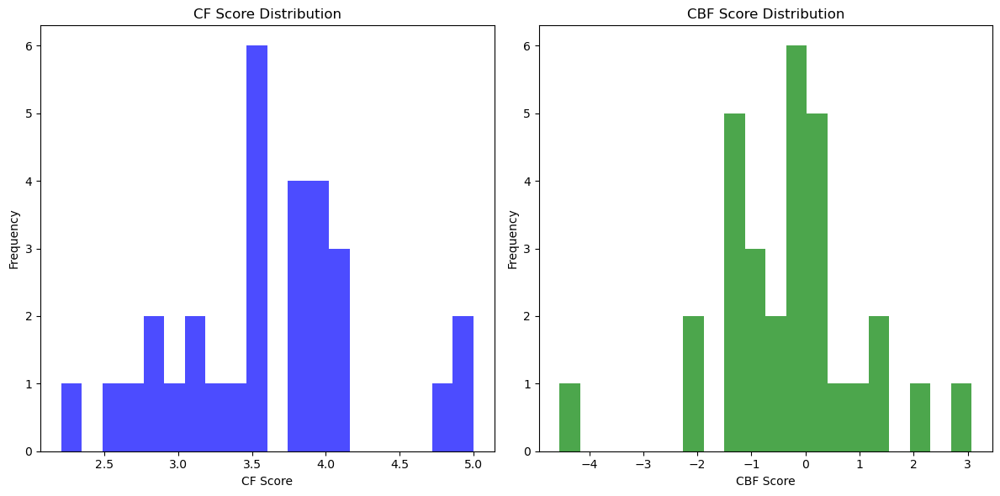


Top 3 recommendations for User 1:
Movie: Mary Poppins (1964), Hybrid Score: 4.39
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.33
Movie: WALL·E (2008), Hybrid Score: 4.29

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 4.12
Movie: Hoop Dreams (1994), Hybrid Score: 4.03
Movie: Crumb (1994), Hybrid Score: 3.94

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.34
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.27
Movie: Paths of Glory (1957), Hybrid Score: 4.23

Top 3 recommendations for User 4:
Movie: Graduate, The (1967), Hybrid Score: 4.27
Movie: Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Hybrid Score: 4.20
Movie: Streetcar Named Desire, A (1951), Hybrid Score: 4.19

Top 3 recommendations for User 5:
Movie: Tangled (2010), Hybrid Score: 4.27
Movie: Jungle Book, The (1967), Hybrid Score: 4.18
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.03

Top 3 recommendat

In [6]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())  # Use a set for O(1) lookups
    all_items = df['movieId'].unique()  # Assuming this doesn't need to be called repeatedly
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        popularity_penalties.append(popularity_penalty)
        hybrid_scores.append(hybrid_score)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Western    Horror  Children  Film-Noir      IMAX  \
movieId                                                                
1       -0.225004 -0.139691 -0.279179  3.154507   -0.09329 -0.207047   
3       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
6       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
47      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
50      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   

          Musical  Thriller   Fantasy     Crime  Documentary   Mystery  \
movieId                                     

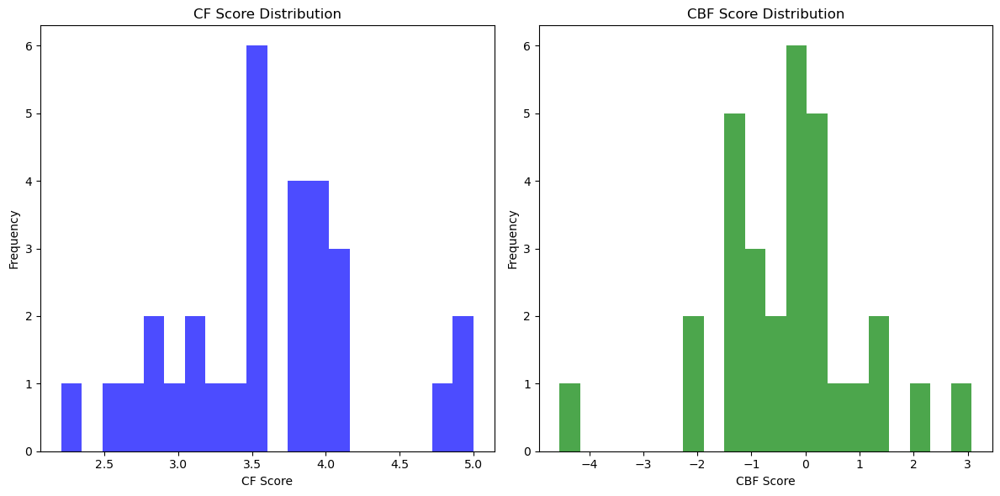


Top 3 recommendations for User 1:
Movie: Mary Poppins (1964), Hybrid Score: 4.39
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.33
Movie: WALL·E (2008), Hybrid Score: 4.29

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 4.12
Movie: Hoop Dreams (1994), Hybrid Score: 4.03
Movie: Crumb (1994), Hybrid Score: 3.94

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.34
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.27
Movie: Paths of Glory (1957), Hybrid Score: 4.23

Top 3 recommendations for User 4:
Movie: Graduate, The (1967), Hybrid Score: 4.27
Movie: Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Hybrid Score: 4.20
Movie: Streetcar Named Desire, A (1951), Hybrid Score: 4.19

Top 3 recommendations for User 5:
Movie: Tangled (2010), Hybrid Score: 4.27
Movie: Jungle Book, The (1967), Hybrid Score: 4.18
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.03

Top 3 recommendat

In [8]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())  # Use a set for O(1) lookups
    all_items = df['movieId'].unique()  # Assuming this doesn't need to be called repeatedly
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        popularity_penalties.append(popularity_penalty)
        hybrid_scores.append(hybrid_score)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Western    Horror  Children  Film-Noir      IMAX  \
movieId                                                                
1       -0.225004 -0.139691 -0.279179  3.154507   -0.09329 -0.207047   
3       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
6       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
47      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
50      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   

          Musical  Thriller   Fantasy     Crime  Documentary   Mystery  \
movieId                                     

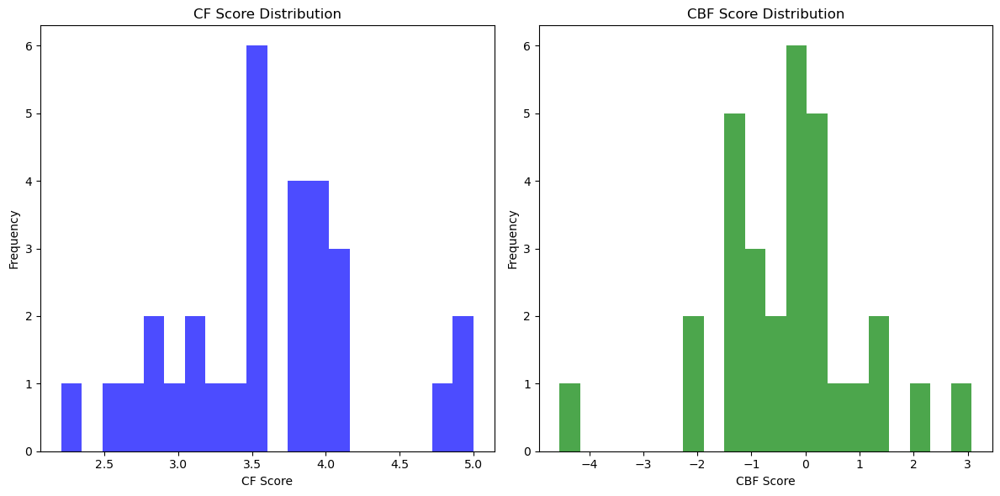


Top 3 recommendations for User 1:
Movie: Mary Poppins (1964), Hybrid Score: 4.39
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.33
Movie: WALL·E (2008), Hybrid Score: 4.29

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 4.12
Movie: Hoop Dreams (1994), Hybrid Score: 4.03
Movie: Crumb (1994), Hybrid Score: 3.94

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.34
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.27
Movie: Paths of Glory (1957), Hybrid Score: 4.23

Top 3 recommendations for User 4:
Movie: Graduate, The (1967), Hybrid Score: 4.27
Movie: Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Hybrid Score: 4.20
Movie: Streetcar Named Desire, A (1951), Hybrid Score: 4.19

Top 3 recommendations for User 5:
Movie: Tangled (2010), Hybrid Score: 4.27
Movie: Jungle Book, The (1967), Hybrid Score: 4.18
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.03

Top 3 recommendat

In [11]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores):
    """Normalize scores to a 0.5-5.0 scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = 5.0 * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(0.5, 5.0)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())  # Use a set for O(1) lookups
    all_items = df['movieId'].unique()  # Assuming this doesn't need to be called repeatedly
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    # Normalize both CF and CBF scores to a 0.5-5.0 scale
    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        popularity_penalties.append(popularity_penalty)
        hybrid_scores.append(hybrid_score)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Western    Horror  Children  Film-Noir      IMAX  \
movieId                                                                
1       -0.225004 -0.139691 -0.279179  3.154507   -0.09329 -0.207047   
3       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
6       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
47      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
50      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   

          Musical  Thriller   Fantasy     Crime  Documentary   Mystery  \
movieId                                     

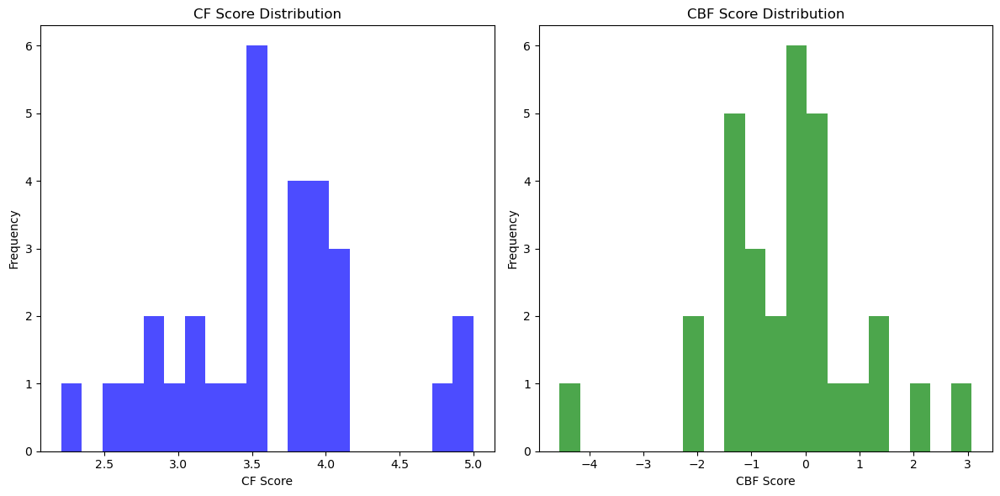


Top 3 recommendations for User 1:
Movie: Mary Poppins (1964), Hybrid Score: 4.45
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.40
Movie: WALL·E (2008), Hybrid Score: 4.35

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 4.19
Movie: Hoop Dreams (1994), Hybrid Score: 4.12
Movie: Crumb (1994), Hybrid Score: 4.05

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.41
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.34
Movie: Paths of Glory (1957), Hybrid Score: 4.30

Top 3 recommendations for User 4:
Movie: Graduate, The (1967), Hybrid Score: 4.34
Movie: Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Hybrid Score: 4.28
Movie: Streetcar Named Desire, A (1951), Hybrid Score: 4.27

Top 3 recommendations for User 5:
Movie: Tangled (2010), Hybrid Score: 4.34
Movie: Jungle Book, The (1967), Hybrid Score: 4.26
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.13

Top 3 recommendat

In [13]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    return normalized_scores.clip(new_min, new_max)

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())  # Use a set for O(1) lookups
    all_items = df['movieId'].unique()  # Assuming this doesn't need to be called repeatedly
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    # Normalize both CF and CBF scores to a 0.5-5.0 scale
    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        popularity_penalties.append(popularity_penalty)
        hybrid_scores.append(hybrid_score)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Western    Horror  Children  Film-Noir      IMAX  \
movieId                                                                
1       -0.225004 -0.139691 -0.279179  3.154507   -0.09329 -0.207047   
3       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
6       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
47      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
50      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   

          Musical  Thriller   Fantasy     Crime  Documentary   Mystery  \
movieId                                     

Before normalization: min_score = 2.965181292952797, max_score = 5.0
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -2.3639527761676677, max_score = 4.567111274976319
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 1: Calculated hybrid scores in 9.01 seconds
INFO:root:User 1: Generated top 3 recommendations in 9.02 seconds
INFO:root:Top 3 recommendations for User 1: [(1028, 4.447996676728053), (6350, 4.3953049921137515), (60069, 4.3530486210419586)]
INFO:root:Processing user 2
INFO:root:Generating recommendations for User 2
INFO:root:User 2: Computed CF and CBF scores for 9695 items in 1.30 seconds


Before normalization: min_score = 2.1823317915122695, max_score = 4.544210146133099
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -6.577700724147265, max_score = 10.226648709609972
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 2: Calculated hybrid scores in 9.02 seconds
INFO:root:User 2: Generated top 3 recommendations in 9.03 seconds
INFO:root:Top 3 recommendations for User 2: [(858, 4.191476412667218), (246, 4.123989931675813), (162, 4.047383571077034)]
INFO:root:Processing user 3
INFO:root:Generating recommendations for User 3
INFO:root:User 3: Computed CF and CBF scores for 9685 items in 1.53 seconds


Before normalization: min_score = 0.9311739975321079, max_score = 3.264918034769727
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -3.01707548218093, max_score = 5.543766044344512
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 3: Calculated hybrid scores in 9.35 seconds
INFO:root:User 3: Generated top 3 recommendations in 9.37 seconds
INFO:root:Top 3 recommendations for User 3: [(1204, 4.405235880037504), (741, 4.338409138945801), (1178, 4.302688709047062)]
INFO:root:Processing user 4
INFO:root:Generating recommendations for User 4
INFO:root:User 4: Computed CF and CBF scores for 9508 items in 1.33 seconds


Before normalization: min_score = 2.18189650264092, max_score = 4.448087081261337
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -3.646333232460254, max_score = 3.635391474166659
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 4: Calculated hybrid scores in 8.93 seconds
INFO:root:User 4: Generated top 3 recommendations in 8.94 seconds
INFO:root:Top 3 recommendations for User 4: [(1247, 4.335481589496729), (922, 4.280315842135127), (1104, 4.265139402421138)]
INFO:root:Processing user 5
INFO:root:Generating recommendations for User 5
INFO:root:User 5: Computed CF and CBF scores for 9680 items in 1.61 seconds


Before normalization: min_score = 2.080688295940351, max_score = 4.352059439291348
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -3.68354753374471, max_score = 5.405483260517915
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 5: Calculated hybrid scores in 9.80 seconds
INFO:root:User 5: Generated top 3 recommendations in 9.81 seconds
INFO:root:Top 3 recommendations for User 5: [(81847, 4.343889589687889), (2078, 4.258002576394742), (1204, 4.126894402157563)]
INFO:root:Processing user 6
INFO:root:Generating recommendations for User 6
INFO:root:User 6: Computed CF and CBF scores for 9410 items in 1.67 seconds


Before normalization: min_score = 2.3692816713256146, max_score = 4.599594570982876
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -2.4427510143430684, max_score = 2.093771403975289
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 6: Calculated hybrid scores in 9.25 seconds
INFO:root:User 6: Generated top 3 recommendations in 9.26 seconds
INFO:root:Top 3 recommendations for User 6: [(1172, 4.5262044589422725), (898, 4.389662952821666), (1209, 4.347542779899524)]
INFO:root:Processing user 7
INFO:root:Generating recommendations for User 7
INFO:root:User 7: Computed CF and CBF scores for 9572 items in 1.52 seconds


Before normalization: min_score = 1.6121919715880106, max_score = 4.0848524040968766
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -2.0369500264788947, max_score = 2.958635992204878
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 7: Calculated hybrid scores in 9.03 seconds
INFO:root:User 7: Generated top 3 recommendations in 9.04 seconds
INFO:root:Top 3 recommendations for User 7: [(6350, 4.326891182159895), (1197, 4.303781704541269), (1204, 4.259759843364374)]
INFO:root:Processing user 8
INFO:root:Generating recommendations for User 8
INFO:root:User 8: Computed CF and CBF scores for 9677 items in 1.60 seconds


Before normalization: min_score = 2.111115824193876, max_score = 4.476735683871479
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -2.3602275772249985, max_score = 2.4261918203244845
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 8: Calculated hybrid scores in 9.82 seconds
INFO:root:User 8: Generated top 3 recommendations in 9.83 seconds
INFO:root:Top 3 recommendations for User 8: [(608, 4.42755253315962), (750, 4.3112141169339955), (2324, 4.266881169826638)]
INFO:root:Processing user 9
INFO:root:Generating recommendations for User 9
INFO:root:User 9: Computed CF and CBF scores for 9678 items in 1.45 seconds


Before normalization: min_score = 1.7845251359561418, max_score = 4.065661870540359
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -3.2877342595561947, max_score = 2.3761479361775475
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 9: Calculated hybrid scores in 9.37 seconds
INFO:root:User 9: Generated top 3 recommendations in 9.38 seconds
INFO:root:Top 3 recommendations for User 9: [(1172, 4.582889971120967), (1266, 4.5467714349563115), (1617, 4.535392420678846)]
INFO:root:Processing user 10
INFO:root:Generating recommendations for User 10
INFO:root:User 10: Computed CF and CBF scores for 9584 items in 1.72 seconds


Before normalization: min_score = 1.823414836430986, max_score = 4.129103340984228
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -4.810647118910106, max_score = 5.868651707689968
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 10: Calculated hybrid scores in 9.55 seconds
INFO:root:User 10: Generated top 3 recommendations in 9.55 seconds
INFO:root:Top 3 recommendations for User 10: [(89904, 4.50826573894602), (951, 4.4548808851556565), (6711, 4.436429718938177)]
INFO:root:Catalog Coverage: 0.27%
INFO:root:Average Novelty: 11.2370
INFO:root:Personalization: 0.9778
INFO:root:Intra-list Diversity: 0.2571


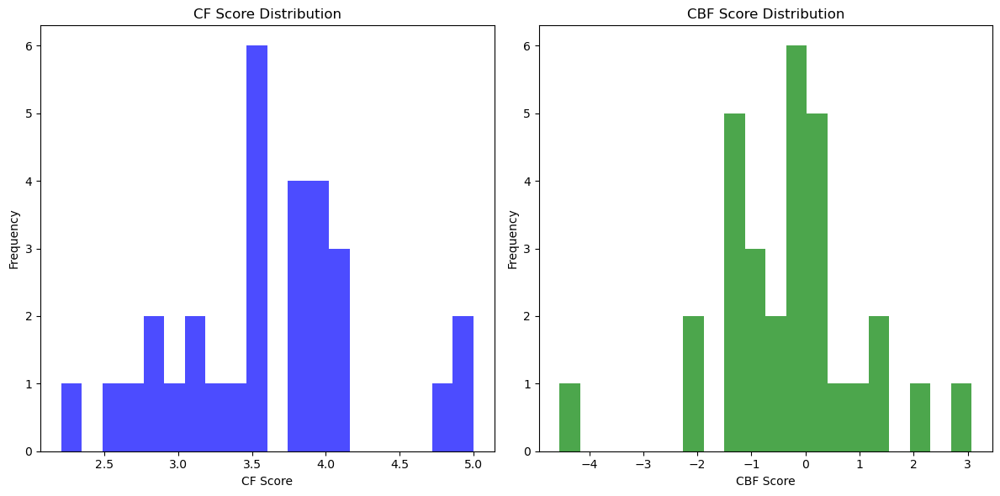


Top 3 recommendations for User 1:
Movie: Mary Poppins (1964), Hybrid Score: 4.45
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.40
Movie: WALL·E (2008), Hybrid Score: 4.35

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 4.19
Movie: Hoop Dreams (1994), Hybrid Score: 4.12
Movie: Crumb (1994), Hybrid Score: 4.05

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.41
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.34
Movie: Paths of Glory (1957), Hybrid Score: 4.30

Top 3 recommendations for User 4:
Movie: Graduate, The (1967), Hybrid Score: 4.34
Movie: Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Hybrid Score: 4.28
Movie: Streetcar Named Desire, A (1951), Hybrid Score: 4.27

Top 3 recommendations for User 5:
Movie: Tangled (2010), Hybrid Score: 4.34
Movie: Jungle Book, The (1967), Hybrid Score: 4.26
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.13

Top 3 recommendat

In [15]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    print(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    print(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())  # Use a set for O(1) lookups
    all_items = df['movieId'].unique()  # Assuming this doesn't need to be called repeatedly
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    # Normalize both CF and CBF scores to a 0.5-5.0 scale
    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        popularity_penalties.append(popularity_penalty)
        hybrid_scores.append(hybrid_score)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Western    Horror  Children  Film-Noir      IMAX  \
movieId                                                                
1       -0.225004 -0.139691 -0.279179  3.154507   -0.09329 -0.207047   
3       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
6       -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
47      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   
50      -0.225004 -0.139691 -0.279179 -0.317007   -0.09329 -0.207047   

          Musical  Thriller   Fantasy     Crime  Documentary   Mystery  \
movieId                                     

Before normalization: min_score = 2.965181292952797, max_score = 5.0
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -2.3639527761676677, max_score = 4.567111274976319
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 1: Calculated hybrid scores in 8.73 seconds
INFO:root:User 1: Generated top 3 recommendations in 8.73 seconds
INFO:root:Top 3 recommendations for User 1: [(1028, 4.447996676728053), (6350, 4.3953049921137515), (60069, 4.3530486210419586)]
INFO:root:Processing user 2
INFO:root:Generating recommendations for User 2
INFO:root:User 2: Computed CF and CBF scores for 9695 items in 1.31 seconds


Before normalization: min_score = 2.1823317915122695, max_score = 4.544210146133099
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -6.577700724147265, max_score = 10.226648709609972
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 2: Calculated hybrid scores in 9.13 seconds
INFO:root:User 2: Generated top 3 recommendations in 9.13 seconds
INFO:root:Top 3 recommendations for User 2: [(858, 4.191476412667218), (246, 4.123989931675813), (162, 4.047383571077034)]
INFO:root:Processing user 3
INFO:root:Generating recommendations for User 3
INFO:root:User 3: Computed CF and CBF scores for 9685 items in 1.21 seconds


Before normalization: min_score = 0.9311739975321079, max_score = 3.264918034769727
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -3.01707548218093, max_score = 5.543766044344512
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 3: Calculated hybrid scores in 8.78 seconds
INFO:root:User 3: Generated top 3 recommendations in 8.79 seconds
INFO:root:Top 3 recommendations for User 3: [(1204, 4.405235880037504), (741, 4.338409138945801), (1178, 4.302688709047062)]
INFO:root:Processing user 4
INFO:root:Generating recommendations for User 4
INFO:root:User 4: Computed CF and CBF scores for 9508 items in 1.35 seconds


Before normalization: min_score = 2.18189650264092, max_score = 4.448087081261337
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -3.646333232460254, max_score = 3.635391474166659
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 4: Calculated hybrid scores in 9.11 seconds
INFO:root:User 4: Generated top 3 recommendations in 9.12 seconds
INFO:root:Top 3 recommendations for User 4: [(1247, 4.335481589496729), (922, 4.280315842135127), (1104, 4.265139402421138)]
INFO:root:Processing user 5
INFO:root:Generating recommendations for User 5
INFO:root:User 5: Computed CF and CBF scores for 9680 items in 1.50 seconds


Before normalization: min_score = 2.080688295940351, max_score = 4.352059439291348
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -3.68354753374471, max_score = 5.405483260517915
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 5: Calculated hybrid scores in 9.07 seconds
INFO:root:User 5: Generated top 3 recommendations in 9.08 seconds
INFO:root:Top 3 recommendations for User 5: [(81847, 4.343889589687889), (2078, 4.258002576394742), (1204, 4.126894402157563)]
INFO:root:Processing user 6
INFO:root:Generating recommendations for User 6
INFO:root:User 6: Computed CF and CBF scores for 9410 items in 1.30 seconds


Before normalization: min_score = 2.3692816713256146, max_score = 4.599594570982876
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -2.4427510143430684, max_score = 2.093771403975289
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 6: Calculated hybrid scores in 9.02 seconds
INFO:root:User 6: Generated top 3 recommendations in 9.03 seconds
INFO:root:Top 3 recommendations for User 6: [(1172, 4.5262044589422725), (898, 4.389662952821666), (1209, 4.347542779899524)]
INFO:root:Processing user 7
INFO:root:Generating recommendations for User 7
INFO:root:User 7: Computed CF and CBF scores for 9572 items in 1.25 seconds


Before normalization: min_score = 1.6121919715880106, max_score = 4.0848524040968766
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -2.0369500264788947, max_score = 2.958635992204878
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 7: Calculated hybrid scores in 9.01 seconds
INFO:root:User 7: Generated top 3 recommendations in 9.02 seconds
INFO:root:Top 3 recommendations for User 7: [(6350, 4.326891182159895), (1197, 4.303781704541269), (1204, 4.259759843364374)]
INFO:root:Processing user 8
INFO:root:Generating recommendations for User 8
INFO:root:User 8: Computed CF and CBF scores for 9677 items in 1.38 seconds


Before normalization: min_score = 2.111115824193876, max_score = 4.476735683871479
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -2.3602275772249985, max_score = 2.4261918203244845
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 8: Calculated hybrid scores in 8.98 seconds
INFO:root:User 8: Generated top 3 recommendations in 9.00 seconds
INFO:root:Top 3 recommendations for User 8: [(608, 4.42755253315962), (750, 4.3112141169339955), (2324, 4.266881169826638)]
INFO:root:Processing user 9
INFO:root:Generating recommendations for User 9
INFO:root:User 9: Computed CF and CBF scores for 9678 items in 1.45 seconds


Before normalization: min_score = 1.7845251359561418, max_score = 4.065661870540359
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -3.2877342595561947, max_score = 2.3761479361775475
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 9: Calculated hybrid scores in 9.24 seconds
INFO:root:User 9: Generated top 3 recommendations in 9.25 seconds
INFO:root:Top 3 recommendations for User 9: [(1172, 4.582889971120967), (1266, 4.5467714349563115), (1617, 4.535392420678846)]
INFO:root:Processing user 10
INFO:root:Generating recommendations for User 10
INFO:root:User 10: Computed CF and CBF scores for 9584 items in 1.29 seconds


Before normalization: min_score = 1.823414836430986, max_score = 4.129103340984228
After normalization: min_score = 0.5, max_score = 5.0
Before normalization: min_score = -4.810647118910106, max_score = 5.868651707689968
After normalization: min_score = 0.5, max_score = 5.0


INFO:root:User 10: Calculated hybrid scores in 8.79 seconds
INFO:root:User 10: Generated top 3 recommendations in 8.79 seconds
INFO:root:Top 3 recommendations for User 10: [(89904, 4.50826573894602), (951, 4.4548808851556565), (6711, 4.436429718938177)]
INFO:root:Catalog Coverage: 0.27%
INFO:root:Average Novelty: 11.2370
INFO:root:Personalization: 0.9778
INFO:root:Intra-list Diversity: 0.2571


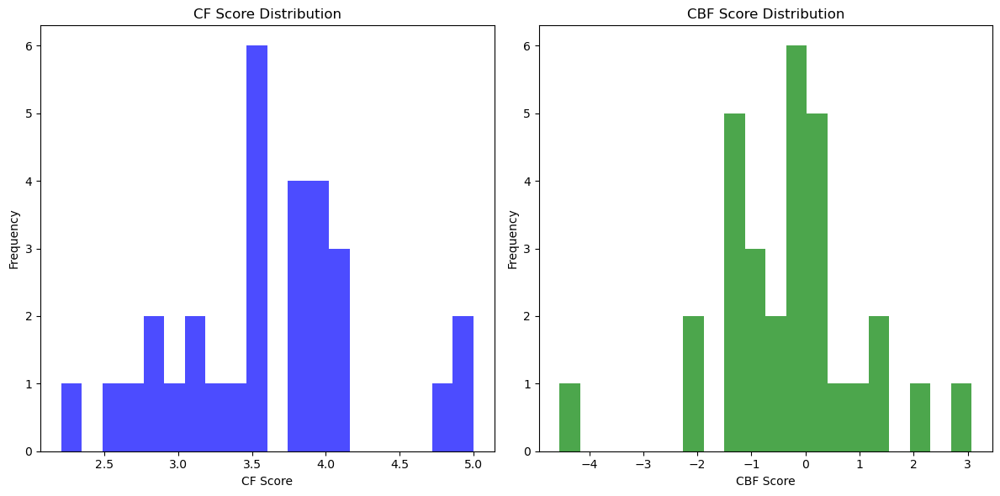


Top 3 recommendations for User 1:
Movie: Mary Poppins (1964), Hybrid Score: 4.45
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.40
Movie: WALL·E (2008), Hybrid Score: 4.35

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 4.19
Movie: Hoop Dreams (1994), Hybrid Score: 4.12
Movie: Crumb (1994), Hybrid Score: 4.05

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.41
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.34
Movie: Paths of Glory (1957), Hybrid Score: 4.30

Top 3 recommendations for User 4:
Movie: Graduate, The (1967), Hybrid Score: 4.34
Movie: Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Hybrid Score: 4.28
Movie: Streetcar Named Desire, A (1951), Hybrid Score: 4.27

Top 3 recommendations for User 5:
Movie: Tangled (2010), Hybrid Score: 4.34
Movie: Jungle Book, The (1967), Hybrid Score: 4.26
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.13

Top 3 recommendat

In [17]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    print(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    print(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())  # Use a set for O(1) lookups
    all_items = df['movieId'].unique()  # Assuming this doesn't need to be called repeatedly
    recommendations = []

    cf_scores = []
    cbf_scores = []
    items_to_recommend = []
    popularity_penalties = []
    hybrid_scores = []

    logging.info(f"Generating recommendations for User {user_id}")

    for item_id in all_items:
        if item_id not in user_rated_items:
            pred = algo.predict(user_id, item_id)
            cf_scores.append(pred.est)
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            items_to_recommend.append(item_id)

    logging.info(f"User {user_id}: Computed CF and CBF scores for {len(items_to_recommend)} items in {time.time() - start_time:.2f} seconds")

    # Normalize both CF and CBF scores to a 0.5-5.0 scale
    normalized_cf_scores = normalize_scores(cf_scores)
    normalized_cbf_scores = normalize_scores(cbf_scores)

    for idx, item_id in enumerate(items_to_recommend):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        popularity_penalties.append(popularity_penalty)
        hybrid_scores.append(hybrid_score)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    logging.info(f"User {user_id}: Calculated hybrid scores in {time.time() - start_time:.2f} seconds")

    recommendations.sort(key=lambda x: x[1], reverse=True)

    recommendations = recommendations[:n_recommendations]
    cf_scores = cf_scores[:n_recommendations]
    cbf_scores = cbf_scores[:n_recommendations]
    popularity_penalties = popularity_penalties[:n_recommendations]
    hybrid_scores = hybrid_scores[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations, cf_scores, cbf_scores, popularity_penalties, hybrid_scores

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs, cf_scores, cbf_scores, popularity_penalties, hybrid_scores = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend(hybrid_scores)
        all_cf_scores.extend(cf_scores)
        all_cbf_scores.extend(cbf_scores)
        all_popularity_penalties.extend(popularity_penalties)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


In [ ]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 10  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    print(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    print(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in df['userId'].unique():
        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                cbf_scores.append(content_score)
                user_ids.append(user_id)
                item_ids.append(item_id)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    normalized_cf_scores = normalize_scores(user_cf_scores)
    normalized_cbf_scores = normalize_scores(user_cbf_scores)

    for idx, item_id in enumerate(user_item_ids):
        cf_score = normalized_cf_scores[idx]
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[user_ids.index(user_id)] for user_id in user_ids if user_id == user_id])
        all_cbf_scores.extend([cbf_scores[user_ids.index(user_id)] for user_id in user_ids if user_id == user_id])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:               War   Fantasy  Animation      IMAX     Drama  Thriller  \
movieId                                                                
1       -0.225004  2.742421   3.664680 -0.207047 -0.843655 -0.596334   
3       -0.225004 -0.364641  -0.272875 -0.207047 -0.843655 -0.596334   
6       -0.225004 -0.364641  -0.272875 -0.207047 -0.843655  1.676913   
47      -0.225004 -0.364641  -0.272875 -0.207047 -0.843655  1.676913   
50      -0.225004 -0.364641  -0.272875 -0.207047 -0.843655  1.676913   

         Adventure   Romance    Horror  Film-Noir    Action  Children  \
movieId                                      

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

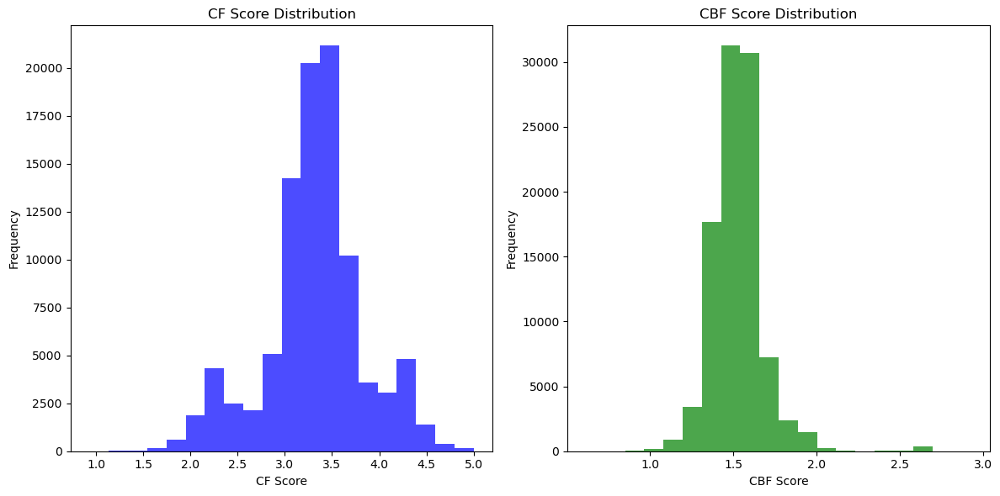


Top 3 recommendations for User 1:
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.61
Movie: Mary Poppins (1964), Hybrid Score: 4.54
Movie: Rudolph, the Red-Nosed Reindeer (1964), Hybrid Score: 4.54

Top 3 recommendations for User 2:
Movie: Everest (1998), Hybrid Score: 4.17
Movie: Hoop Dreams (1994), Hybrid Score: 4.12
Movie: Crumb (1994), Hybrid Score: 4.08

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 3.19
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 3.17
Movie: 28 Days Later (2002), Hybrid Score: 3.16

Top 3 recommendations for User 4:
Movie: Sunset Blvd. (a.k.a. Sunset Boulevard) (1950), Hybrid Score: 4.15
Movie: Graduate, The (1967), Hybrid Score: 4.09
Movie: Sideways (2004), Hybrid Score: 4.05

Top 3 recommendations for User 5:
Movie: Tangled (2010), Hybrid Score: 4.21
Movie: Princess and the Frog, The (2009), Hybrid Score: 4.04
Movie: Jungle Book, The (1967), Hybrid Score: 4.04

Top 3 rec

In [1]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    normalized_cbf_scores = normalize_scores(user_cbf_scores)

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    # Normalize the CBF scores only
    cbf_scores = normalize_scores(cbf_scores)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


In [3]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _ in recommendations[user1])
        recs2 = set(item for item, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    # Normalize the CBF scores only
    cbf_scores = normalize_scores(cbf_scores)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

ValueError: too many values to unpack (expected 2)

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

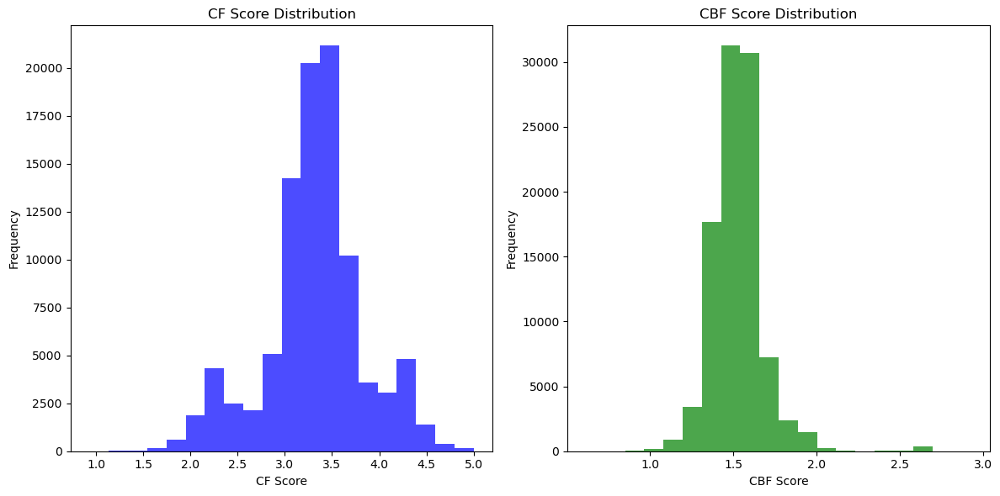


Top 3 recommendations for User 1:
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.61, CF Score: 4.74, CBF Score: 4.38, Popularity Penalty: 0.0393
Movie: Mary Poppins (1964), Hybrid Score: 4.54, CF Score: 4.89, CBF Score: 3.91, Popularity Penalty: 0.1164
Movie: Rudolph, the Red-Nosed Reindeer (1964), Hybrid Score: 4.54, CF Score: 4.34, CBF Score: 5.00, Popularity Penalty: 0.0049

Top 3 recommendations for User 2:
Movie: Everest (1998), Hybrid Score: 4.17, CF Score: 3.82, CBF Score: 5.00, Popularity Penalty: 0.0098
Movie: Hoop Dreams (1994), Hybrid Score: 4.12, CF Score: 4.05, CBF Score: 4.34, Popularity Penalty: 0.0475
Movie: Crumb (1994), Hybrid Score: 4.08, CF Score: 3.99, CBF Score: 4.34, Popularity Penalty: 0.0279

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 3.19, CF Score: 3.26, CBF Score: 3.14, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 3.17, CF Score: 3.20, CB

In [5]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    # Normalize the CBF scores only
    cbf_scores = normalize_scores(cbf_scores)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

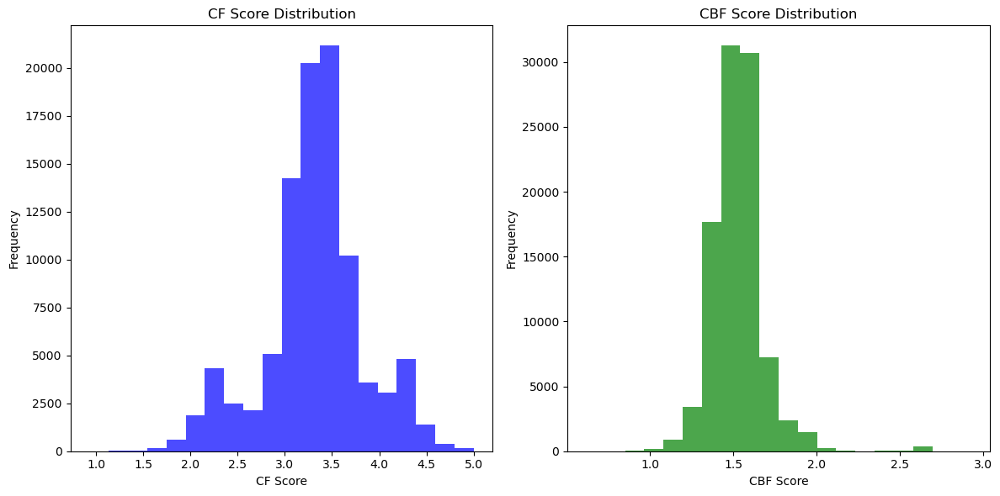


Top 3 recommendations for User 1:
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.61, CF Score: 4.74, CBF Score: 4.38, Popularity Penalty: 0.0393
Movie: Mary Poppins (1964), Hybrid Score: 4.54, CF Score: 4.89, CBF Score: 3.91, Popularity Penalty: 0.1164
Movie: Rudolph, the Red-Nosed Reindeer (1964), Hybrid Score: 4.54, CF Score: 4.34, CBF Score: 5.00, Popularity Penalty: 0.0049

Top 3 recommendations for User 2:
Movie: Everest (1998), Hybrid Score: 4.17, CF Score: 3.82, CBF Score: 5.00, Popularity Penalty: 0.0098
Movie: Hoop Dreams (1994), Hybrid Score: 4.12, CF Score: 4.05, CBF Score: 4.34, Popularity Penalty: 0.0475
Movie: Crumb (1994), Hybrid Score: 4.08, CF Score: 3.99, CBF Score: 4.34, Popularity Penalty: 0.0279

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 3.19, CF Score: 3.26, CBF Score: 3.14, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 3.17, CF Score: 3.20, CB

In [9]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    # Normalize the CBF scores for the entire population
    normalized_cbf_scores = normalize_scores(cbf_scores)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


# NEW SESSION ON CODE COPILOT

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

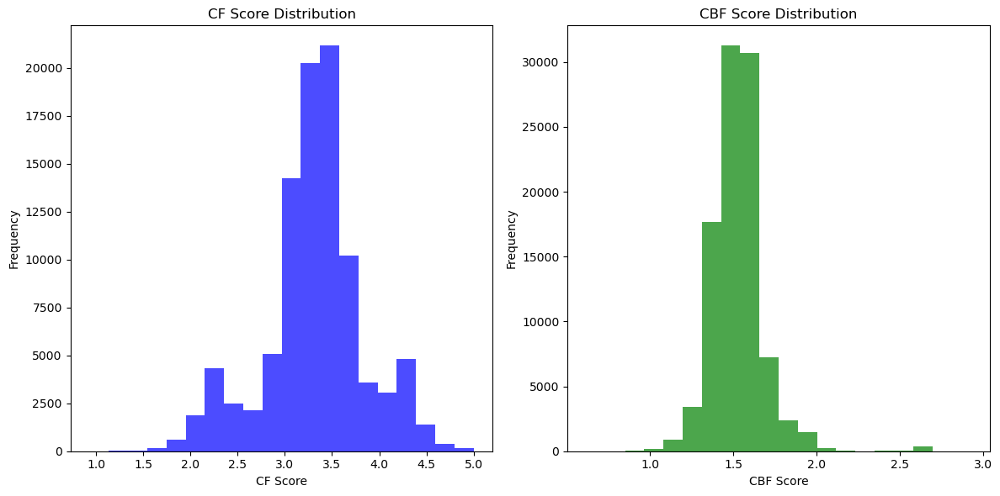


Top 3 recommendations for User 1:
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.61, CF Score: 4.74, CBF Score: 4.38, Popularity Penalty: 0.0393
Movie: Mary Poppins (1964), Hybrid Score: 4.54, CF Score: 4.89, CBF Score: 3.91, Popularity Penalty: 0.1164
Movie: Rudolph, the Red-Nosed Reindeer (1964), Hybrid Score: 4.54, CF Score: 4.34, CBF Score: 5.00, Popularity Penalty: 0.0049

Top 3 recommendations for User 2:
Movie: Everest (1998), Hybrid Score: 4.17, CF Score: 3.82, CBF Score: 5.00, Popularity Penalty: 0.0098
Movie: Hoop Dreams (1994), Hybrid Score: 4.12, CF Score: 4.05, CBF Score: 4.34, Popularity Penalty: 0.0475
Movie: Crumb (1994), Hybrid Score: 4.08, CF Score: 3.99, CBF Score: 4.34, Popularity Penalty: 0.0279

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 3.19, CF Score: 3.26, CBF Score: 3.14, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 3.17, CF Score: 3.20, CB

In [12]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    # Normalize the CBF scores for the entire population
    normalized_cbf_scores = normalize_scores(cbf_scores)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

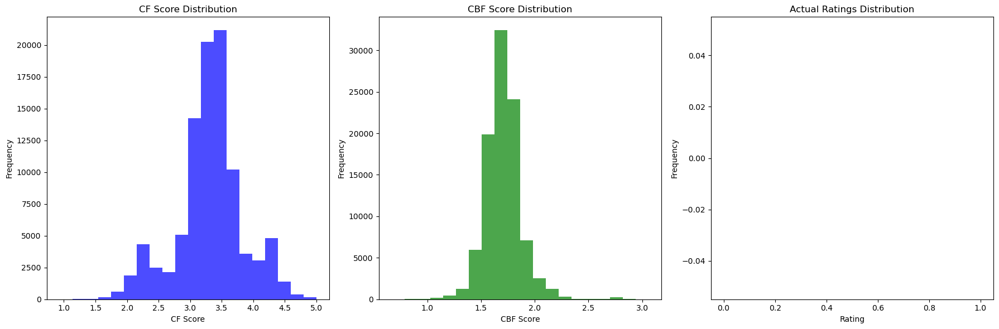


Top 3 recommendations for User 1:
Movie: Singin' in the Rain (1952), Hybrid Score: 4.07, CF Score: 5.00, CBF Score: 2.04, Popularity Penalty: 0.0770
Movie: Night at the Opera, A (1935), Hybrid Score: 4.07, CF Score: 4.91, CBF Score: 2.15, Popularity Penalty: 0.0148
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.07, CF Score: 5.00, CBF Score: 2.03, Popularity Penalty: 0.0738

Top 3 recommendations for User 2:
Movie: Hoop Dreams (1994), Hybrid Score: 3.62, CF Score: 4.05, CBF Score: 2.67, Popularity Penalty: 0.0475
Movie: Three Billboards Outside Ebbing, Missouri (2017), Hybrid Score: 3.59, CF Score: 4.21, CBF Score: 2.16, Popularity Penalty: 0.0131
Movie: Searching for Sugar Man (2012), Hybrid Score: 3.58, CF Score: 3.91, CBF Score: 2.83, Popularity Penalty: 0.0066

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 2.90, CF Score: 3.26, CBF Score: 2.17, Popularity Penalty: 0.0738
Movie: Paths of Glory (1957), Hybrid Score: 2.88, CF Score: 3.20, CBF Sc

In [14]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    # Normalize the CBF scores after collecting them for all users and items
    cbf_scores = normalize_scores(cbf_scores)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = user_cbf_scores[idx]  # Use normalized CBF scores
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, actual_ratings):
    """Plot distributions of CF and CBF scores against actual ratings."""
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 3)
    plt.hist(actual_ratings, bins=20, color='red', alpha=0.7)
    plt.title('Actual Ratings Distribution')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores, all_actual_ratings)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

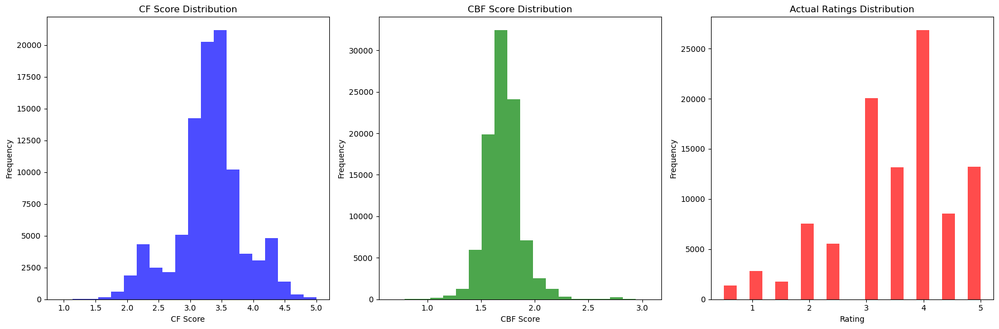


Top 3 recommendations for User 1:
Movie: Singin' in the Rain (1952), Hybrid Score: 4.07, CF Score: 5.00, CBF Score: 2.04, Popularity Penalty: 0.0770
Movie: Night at the Opera, A (1935), Hybrid Score: 4.07, CF Score: 4.91, CBF Score: 2.15, Popularity Penalty: 0.0148
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.07, CF Score: 5.00, CBF Score: 2.03, Popularity Penalty: 0.0738

Top 3 recommendations for User 2:
Movie: Hoop Dreams (1994), Hybrid Score: 3.62, CF Score: 4.05, CBF Score: 2.67, Popularity Penalty: 0.0475
Movie: Three Billboards Outside Ebbing, Missouri (2017), Hybrid Score: 3.59, CF Score: 4.21, CBF Score: 2.16, Popularity Penalty: 0.0131
Movie: Searching for Sugar Man (2012), Hybrid Score: 3.58, CF Score: 3.91, CBF Score: 2.83, Popularity Penalty: 0.0066

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 2.90, CF Score: 3.26, CBF Score: 2.17, Popularity Penalty: 0.0738
Movie: Paths of Glory (1957), Hybrid Score: 2.88, CF Score: 3.20, CBF Sc

In [16]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    # Normalize the CBF scores after collecting them for all users and items
    cbf_scores = normalize_scores(cbf_scores)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = user_cbf_scores[idx]  # Use normalized CBF scores
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, actual_ratings):
    """Plot distributions of CF and CBF scores against actual ratings."""
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 3)
    plt.hist(actual_ratings, bins=20, color='red', alpha=0.7)
    plt.title('Actual Ratings Distribution')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Use the original ratings for the actual ratings distribution plot
    original_ratings = ratings_df['rating'].tolist()
    plot_distributions(all_cf_scores, all_cbf_scores, original_ratings)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

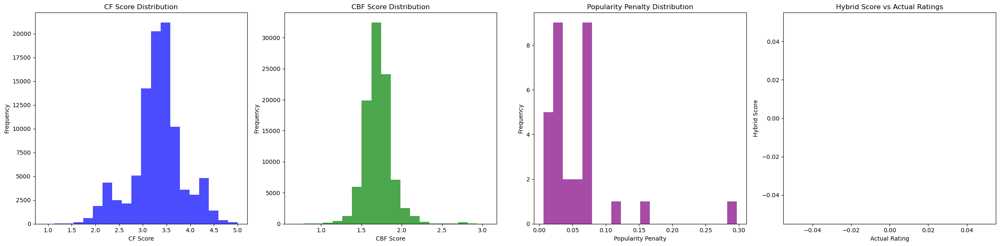


Top 3 recommendations for User 1:
Movie: Singin' in the Rain (1952), Hybrid Score: 4.07, CF Score: 5.00, CBF Score: 2.04, Popularity Penalty: 0.0770
Movie: Night at the Opera, A (1935), Hybrid Score: 4.07, CF Score: 4.91, CBF Score: 2.15, Popularity Penalty: 0.0148
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.07, CF Score: 5.00, CBF Score: 2.03, Popularity Penalty: 0.0738

Top 3 recommendations for User 2:
Movie: Hoop Dreams (1994), Hybrid Score: 3.62, CF Score: 4.05, CBF Score: 2.67, Popularity Penalty: 0.0475
Movie: Three Billboards Outside Ebbing, Missouri (2017), Hybrid Score: 3.59, CF Score: 4.21, CBF Score: 2.16, Popularity Penalty: 0.0131
Movie: Searching for Sugar Man (2012), Hybrid Score: 3.58, CF Score: 3.91, CBF Score: 2.83, Popularity Penalty: 0.0066

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 2.90, CF Score: 3.26, CBF Score: 2.17, Popularity Penalty: 0.0738
Movie: Paths of Glory (1957), Hybrid Score: 2.88, CF Score: 3.20, CBF Sc

In [19]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    # Normalize the CBF scores after collecting them for all users and items
    cbf_scores = normalize_scores(cbf_scores)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = user_cbf_scores[idx]  # Use normalized CBF scores
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, actual_ratings, popularity_penalties, hybrid_scores, actual_ratings_for_hybrid):
    """Plot distributions of CF and CBF scores, popularity penalties, and hybrid scores against actual ratings."""
    plt.figure(figsize=(24, 6))

    plt.subplot(1, 4, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 3)
    plt.hist(popularity_penalties, bins=20, color='purple', alpha=0.7)
    plt.title('Popularity Penalty Distribution')
    plt.xlabel('Popularity Penalty')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 4)
    plt.scatter(actual_ratings_for_hybrid, hybrid_scores, alpha=0.5)
    plt.title('Hybrid Score vs Actual Ratings')
    plt.xlabel('Actual Rating')
    plt.ylabel('Hybrid Score')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    actual_ratings_for_hybrid = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([rec[4] for rec in recs])
        actual_ratings_for_hybrid.extend(actual_ratings)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Use the original ratings for the actual ratings distribution plot
    original_ratings = ratings_df['rating'].tolist()
    plot_distributions(all_cf_scores, all_cbf_scores, original_ratings, all_popularity_penalties, all_hybrid_scores, actual_ratings_for_hybrid)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:          Children   Fantasy     Crime  Animation      IMAX  Documentary  \
movieId                                                                   
1        3.154507  2.742421 -0.445216   3.664680 -0.207047     -0.11062   
3       -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
6       -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   
47      -0.317007 -0.364641 -0.445216  -0.272875 -0.207047     -0.11062   
50      -0.317007 -0.364641  2.246099  -0.272875 -0.207047     -0.11062   

          Mystery    Horror       War   Western   Romance  Film-Noir  \
movieId                  

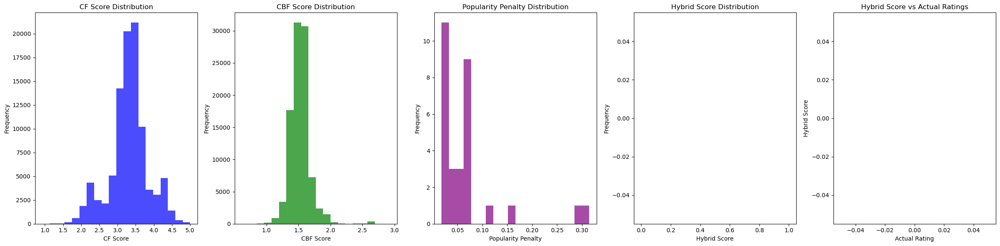


Top 3 recommendations for User 1:
Movie: Evil Dead II (Dead by Dawn) (1987), Hybrid Score: 3.96, CF Score: 5.00, CBF Score: 1.64, Popularity Penalty: 0.0557
Movie: Lawrence of Arabia (1962), Hybrid Score: 3.96, CF Score: 5.00, CBF Score: 1.65, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 3.96, CF Score: 5.00, CBF Score: 1.61, Popularity Penalty: 0.0443

Top 3 recommendations for User 2:
Movie: Hoop Dreams (1994), Hybrid Score: 3.59, CF Score: 4.05, CBF Score: 2.59, Popularity Penalty: 0.0475
Movie: Godfather, The (1972), Hybrid Score: 3.57, CF Score: 4.54, CBF Score: 1.81, Popularity Penalty: 0.3148
Movie: Crumb (1994), Hybrid Score: 3.55, CF Score: 3.99, CBF Score: 2.59, Popularity Penalty: 0.0279

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 2.79, CF Score: 3.26, CBF Score: 1.80, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 2.76, CF Score: 3.20, CBF Scor

In [21]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Ensure CF_WEIGHT and CBF_WEIGHT add up to 1.0
assert CF_WEIGHT + CBF_WEIGHT == 1.0, "CF_WEIGHT and CBF_WEIGHT must add up to 1.0"

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = user_cbf_scores[idx]  # Use normalized CBF scores
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, actual_ratings, popularity_penalties, hybrid_scores, actual_ratings_for_hybrid):
    """Plot distributions of CF and CBF scores, popularity penalties, and hybrid scores against actual ratings."""
    plt.figure(figsize=(24, 6))

    plt.subplot(1, 5, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 3)
    plt.hist(popularity_penalties, bins=20, color='purple', alpha=0.7)
    plt.title('Popularity Penalty Distribution')
    plt.xlabel('Popularity Penalty')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 4)
    plt.hist(hybrid_scores, bins=20, color='orange', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 5)
    plt.scatter(actual_ratings_for_hybrid, hybrid_scores, alpha=0.5)
    plt.title('Hybrid Score vs Actual Ratings')
    plt.xlabel('Actual Rating')
    plt.ylabel('Hybrid Score')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    # Removing add_year_feature for this test
    # merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    actual_ratings_for_hybrid = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([rec[4] for rec in recs])
        actual_ratings_for_hybrid.extend(actual_ratings)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Use the original ratings for the actual ratings distribution plot
    original_ratings = ratings_df['rating'].tolist()
    plot_distributions(all_cf_scores, all_cbf_scores, original_ratings, all_popularity_penalties, all_hybrid_scores, actual_ratings_for_hybrid)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Item features extracted and normalized:          Children  Fantasy  Crime  Animation  IMAX  Documentary  Mystery  \
movieId                                                                    
1             1.0      1.0    0.0        1.0   0.0          0.0      0.0   
3             0.0      0.0    0.0        0.0   0.0          0.0      0.0   
6             0.0      0.0    1.0        0.0   0.0          0.0      0.0   
47            0.0      0.0    0.0        0.0   0.0          0.0      1.0   
50            0.0      0.0    1.0        0.0   0.0          0.0      1.0   

         Horror  War  Western  Romance  Film-Noir  Comedy  Musical  Adventure  \
movieId                                                           

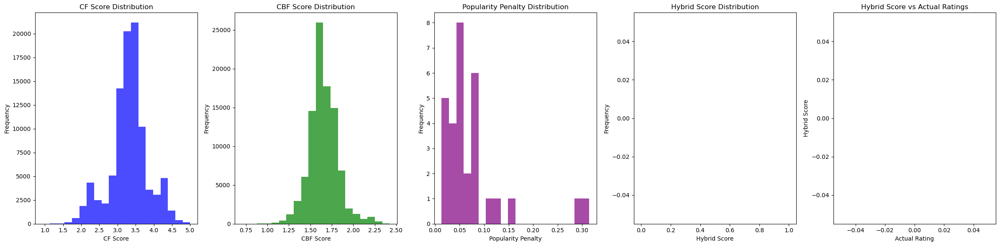


Top 3 recommendations for User 1:
Movie: Evil Dead II (Dead by Dawn) (1987), Hybrid Score: 4.02, CF Score: 5.00, CBF Score: 1.82, Popularity Penalty: 0.0557
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.00, CF Score: 5.00, CBF Score: 1.75, Popularity Penalty: 0.0443
Movie: Good, the Bad and the Ugly, The (Buono, il brutto, il cattivo, Il) (1966), Hybrid Score: 4.00, CF Score: 4.98, CBF Score: 1.90, Popularity Penalty: 0.1180

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 3.63, CF Score: 4.54, CBF Score: 2.02, Popularity Penalty: 0.3148
Movie: Cinema Paradiso (Nuovo cinema Paradiso) (1989), Hybrid Score: 3.56, CF Score: 4.35, CBF Score: 1.80, Popularity Penalty: 0.0557
Movie: Three Billboards Outside Ebbing, Missouri (2017), Hybrid Score: 3.54, CF Score: 4.21, CBF Score: 2.02, Popularity Penalty: 0.0131

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 2.81, CF Score: 3.26, CBF Score: 1.86, Popularity

In [23]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Ensure CF_WEIGHT and CBF_WEIGHT add up to 1.0
assert CF_WEIGHT + CBF_WEIGHT == 1.0, "CF_WEIGHT and CBF_WEIGHT must add up to 1.0"

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        # Check if any genre columns are zeroed out
        zeroed_columns = [genre for genre in genre_list if merged_df[genre].sum() == 0]
        if zeroed_columns:
            logging.warning(f"Zeroed columns identified: {zeroed_columns}")

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_to_range(df, columns, new_min=0, new_max=1):
    """Normalize DataFrame columns to a specified range."""
    for column in columns:
        min_val = df[column].min()
        max_val = df[column].max()
        df[column] = new_min + (df[column] - min_val) * (new_max - new_min) / (max_val - min_val)
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()

    # Standardize the features
    scaler = StandardScaler()
    item_features[non_zero_columns] = scaler.fit_transform(item_features[non_zero_columns])

    # Normalize the standardized features to the range [0, 1]
    item_features = normalize_to_range(item_features, non_zero_columns, new_min=0, new_max=1)
    
    logging.info(f"Item features extracted and normalized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = user_cbf_scores[idx]  # Use normalized CBF scores
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, actual_ratings, popularity_penalties, hybrid_scores, actual_ratings_for_hybrid):
    """Plot distributions of CF and CBF scores, popularity penalties, and hybrid scores against actual ratings."""
    plt.figure(figsize=(24, 6))

    plt.subplot(1, 5, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 3)
    plt.hist(popularity_penalties, bins=20, color='purple', alpha=0.7)
    plt.title('Popularity Penalty Distribution')
    plt.xlabel('Popularity Penalty')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 4)
    plt.hist(hybrid_scores, bins=20, color='orange', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 5)
    plt.scatter(actual_ratings_for_hybrid, hybrid_scores, alpha=0.5)
    plt.title('Hybrid Score vs Actual Ratings')
    plt.xlabel('Actual Rating')
    plt.ylabel('Hybrid Score')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    # Removing add_year_feature for this test
    # merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    actual_ratings_for_hybrid = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([rec[4] for rec in recs])
        actual_ratings_for_hybrid.extend(actual_ratings)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Use the original ratings for the actual ratings distribution plot
    original_ratings = ratings_df['rating'].tolist()
    plot_distributions(all_cf_scores, all_cbf_scores, original_ratings, all_popularity_penalties, all_hybrid_scores, actual_ratings_for_hybrid)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Item features extracted and normalized:          Children  Fantasy  Crime  Animation  IMAX  Documentary  Mystery  \
movieId                                                                    
1             5.0      5.0    0.5        5.0   0.5          0.5      0.5   
3             0.5      0.5    0.5        0.5   0.5          0.5      0.5   
6             0.5      0.5    5.0        0.5   0.5          0.5      0.5   
47            0.5      0.5    0.5        0.5   0.5          0.5      5.0   
50            0.5      0.5    5.0        0.5   0.5          0.5      5.0   

         Horror  War  Western  Romance  Film-Noir  Comedy  Musical  Adventure  \
movieId                                                           

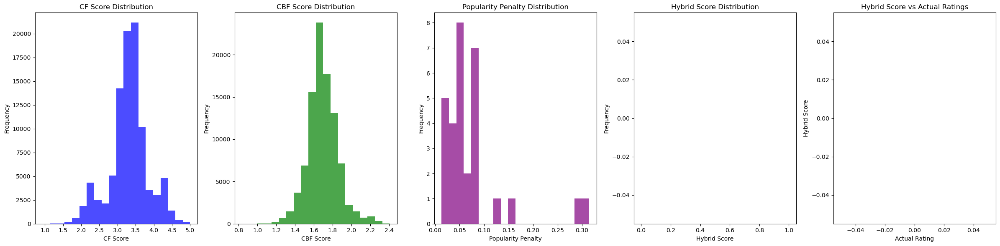


Top 3 recommendations for User 1:
Movie: Evil Dead II (Dead by Dawn) (1987), Hybrid Score: 4.04, CF Score: 5.00, CBF Score: 1.90, Popularity Penalty: 0.0557
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 4.02, CF Score: 5.00, CBF Score: 1.83, Popularity Penalty: 0.0443
Movie: Lawrence of Arabia (1962), Hybrid Score: 4.02, CF Score: 5.00, CBF Score: 1.85, Popularity Penalty: 0.0738

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 3.63, CF Score: 4.54, CBF Score: 2.03, Popularity Penalty: 0.3148
Movie: Cinema Paradiso (Nuovo cinema Paradiso) (1989), Hybrid Score: 3.57, CF Score: 4.35, CBF Score: 1.84, Popularity Penalty: 0.0557
Movie: Three Billboards Outside Ebbing, Missouri (2017), Hybrid Score: 3.55, CF Score: 4.21, CBF Score: 2.03, Popularity Penalty: 0.0131

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 2.81, CF Score: 3.26, CBF Score: 1.89, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôka

In [25]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Ensure CF_WEIGHT and CBF_WEIGHT add up to 1.0
assert CF_WEIGHT + CBF_WEIGHT == 1.0, "CF_WEIGHT and CBF_WEIGHT must add up to 1.0"

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        # Check if any genre columns are zeroed out
        zeroed_columns = [genre for genre in genre_list if merged_df[genre].sum() == 0]
        if zeroed_columns:
            logging.warning(f"Zeroed columns identified: {zeroed_columns}")

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_to_range(df, columns, new_min=0.5, new_max=5.0):
    """Normalize DataFrame columns to a specified range."""
    for column in columns:
        min_val = df[column].min()
        max_val = df[column].max()
        df[column] = new_min + (df[column] - min_val) * (new_max - new_min) / (max_val - min_val)
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()

    # Standardize the features
    scaler = StandardScaler()
    item_features[non_zero_columns] = scaler.fit_transform(item_features[non_zero_columns])

    # Normalize the standardized features to the range [0.5, 5.0]
    item_features = normalize_to_range(item_features, non_zero_columns, new_min=0.5, new_max=5.0)
    
    logging.info(f"Item features extracted and normalized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = user_cbf_scores[idx]  # Use normalized CBF scores
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, actual_ratings, popularity_penalties, hybrid_scores, actual_ratings_for_hybrid):
    """Plot distributions of CF and CBF scores, popularity penalties, and hybrid scores against actual ratings."""
    plt.figure(figsize=(24, 6))

    plt.subplot(1, 5, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 3)
    plt.hist(popularity_penalties, bins=20, color='purple', alpha=0.7)
    plt.title('Popularity Penalty Distribution')
    plt.xlabel('Popularity Penalty')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 4)
    plt.hist(hybrid_scores, bins=20, color='orange', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 5)
    plt.scatter(actual_ratings_for_hybrid, hybrid_scores, alpha=0.5)
    plt.title('Hybrid Score vs Actual Ratings')
    plt.xlabel('Actual Rating')
    plt.ylabel('Hybrid Score')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    # Removing add_year_feature for this test
    # merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    actual_ratings_for_hybrid = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([rec[4] for rec in recs])
        actual_ratings_for_hybrid.extend(actual_ratings)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Use the original ratings for the actual ratings distribution plot
    original_ratings = ratings_df['rating'].tolist()
    plot_distributions(all_cf_scores, all_cbf_scores, original_ratings, all_popularity_penalties, all_hybrid_scores, actual_ratings_for_hybrid)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Item features extracted and normalized:          Children  Fantasy  Crime  Animation  IMAX  Documentary  Mystery  \
movieId                                                                    
1             5.0      5.0    0.5        5.0   0.5          0.5      0.5   
3             0.5      0.5    0.5        0.5   0.5          0.5      0.5   
6             0.5      0.5    5.0        0.5   0.5          0.5      0.5   
47            0.5      0.5    0.5        0.5   0.5          0.5      5.0   
50            0.5      0.5    5.0        0.5   0.5          0.5      5.0   

         Horror  War  Western  Romance  Film-Noir  Comedy  Musical  Adventure  \
movieId                                                           

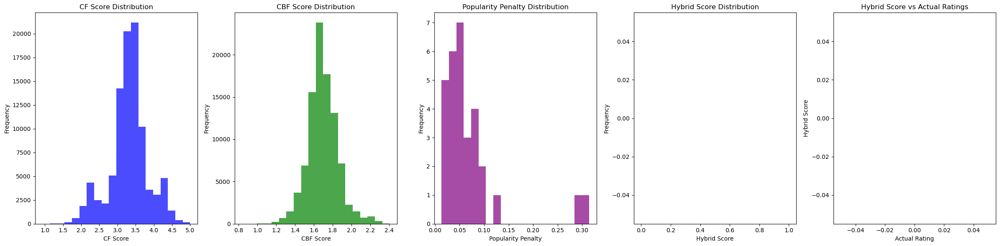


Top 3 recommendations for User 1:
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 3.48, CF Score: 4.74, CBF Score: 2.25, Popularity Penalty: 0.0393
Movie: Toy Story 3 (2010), Hybrid Score: 3.44, CF Score: 4.91, CBF Score: 2.07, Popularity Penalty: 0.0902
Movie: Evil Dead II (Dead by Dawn) (1987), Hybrid Score: 3.42, CF Score: 5.00, CBF Score: 1.90, Popularity Penalty: 0.0557

Top 3 recommendations for User 2:
Movie: Godfather, The (1972), Hybrid Score: 3.13, CF Score: 4.54, CBF Score: 2.03, Popularity Penalty: 0.3148
Movie: Boondock Saints, The (2000), Hybrid Score: 3.12, CF Score: 4.15, CBF Score: 2.17, Popularity Penalty: 0.0705
Movie: Three Billboards Outside Ebbing, Missouri (2017), Hybrid Score: 3.11, CF Score: 4.21, CBF Score: 2.03, Popularity Penalty: 0.0131

Top 3 recommendations for User 3:
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 2.57, CF Score: 3.20, CBF Score: 1.98, Popularity Penalty: 0.0443
Movie: Lawrence of Arabia

In [29]:
import pandas as pd
import numpy as np
import itertools
import logging
import re
import matplotlib.pyplot as plt
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import time
from joblib import Parallel, delayed
import cProfile
import pstats

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100  # Remove this if you want to use the full dataset
BATCH_SIZE = 1000  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.5
CBF_WEIGHT = 0.5
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.5

# Ensure CF_WEIGHT and CBF_WEIGHT add up to 1.0
assert CF_WEIGHT + CBF_WEIGHT == 1.0, "CF_WEIGHT and CBF_WEIGHT must add up to 1.0"

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        # Check if any genre columns are zeroed out
        zeroed_columns = [genre for genre in genre_list if merged_df[genre].sum() == 0]
        if zeroed_columns:
            logging.warning(f"Zeroed columns identified: {zeroed_columns}")

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_to_range(df, columns, new_min=0.5, new_max=5.0):
    """Normalize DataFrame columns to a specified range."""
    for column in columns:
        min_val = df[column].min()
        max_val = df[column].max()
        df[column] = new_min + (df[column] - min_val) * (new_max - new_min) / (max_val - min_val)
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()

    # Standardize the features
    scaler = StandardScaler()
    item_features[non_zero_columns] = scaler.fit_transform(item_features[non_zero_columns])

    # Normalize the standardized features to the range [0.5, 5.0]
    item_features = normalize_to_range(item_features, non_zero_columns, new_min=0.5, new_max=5.0)
    
    logging.info(f"Item features extracted and normalized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = user_cbf_scores[idx]  # Use normalized CBF scores
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, actual_ratings, popularity_penalties, hybrid_scores, actual_ratings_for_hybrid):
    """Plot distributions of CF and CBF scores, popularity penalties, and hybrid scores against actual ratings."""
    plt.figure(figsize=(24, 6))

    plt.subplot(1, 5, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 3)
    plt.hist(popularity_penalties, bins=20, color='purple', alpha=0.7)
    plt.title('Popularity Penalty Distribution')
    plt.xlabel('Popularity Penalty')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 4)
    plt.hist(hybrid_scores, bins=20, color='orange', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 5, 5)
    plt.scatter(actual_ratings_for_hybrid, hybrid_scores, alpha=0.5)
    plt.title('Hybrid Score vs Actual Ratings')
    plt.xlabel('Actual Rating')
    plt.ylabel('Hybrid Score')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    # Removing add_year_feature for this test
    # merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []
    actual_ratings_for_hybrid = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([rec[4] for rec in recs])
        actual_ratings_for_hybrid.extend(actual_ratings)

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    # Use the original ratings for the actual ratings distribution plot
    original_ratings = ratings_df['rating'].tolist()
    plot_distributions(all_cf_scores, all_cbf_scores, original_ratings, all_popularity_penalties, all_hybrid_scores, actual_ratings_for_hybrid)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    with cProfile.Profile() as profiler:
        merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()
    stats = pstats.Stats(profiler).sort_stats('cumtime')
    stats.print_stats(10)


# Focus just on the CBF scores

In [ ]:
import pandas as pd
import numpy as np
import logging
from sklearn.preprocessing import MinMaxScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def normalize_features(df, feature_columns, new_min=0.5, new_max=5.0):
    """Normalize selected features in dataframe to a specified range."""
    scaler = MinMaxScaler(feature_range=(new_min, new_max))
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()

    # Normalize the features directly
    item_features = normalize_features(item_features, non_zero_columns)
    
    logging.info(f"Item features extracted and normalized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Normalize features directly
    merged_df = normalize_features(merged_df, genre_columns)
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:Item features extracted and normalized:          Children  Fantasy  Crime  Animation  IMAX  Documentary  \
movieId                                                           
1             5.0      5.0    0.5        5.0   0.5          0.5   
3             0.5      0.5    0.5        0.5   0.5          0.5   
6             0.5      0.5    5.0        0.5   0.5          0.5   
47            0.5      0.5    0.5        0.5   0.5          0.5   
50            0.5      0.5    5.0        0.5   0.5          0.5   

         (no genres listed)  Mystery  Horror  War  Western  Romance  \
movieId                                                               
1                       0.5      0.5     0.5  0.5      0.5      0.5   
3                       0.5      0.5     0.5  0.5      0.5      5.0   
6                       0.5      0.5     0.5  0.5      0.5      0.5   
47                      0.5      5.0     0.5  0.5      0.5      0.5   
50                      0.5      5.0     0.5  0.5     

In [1]:
import pandas as pd
import numpy as np
import logging
from sklearn.preprocessing import MinMaxScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def normalize_features(df, feature_columns, new_min=0.5, new_max=5.0):
    """Normalize selected features in dataframe to a specified range."""
    scaler = MinMaxScaler(feature_range=(new_min, new_max))
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()

    # Normalize the features directly
    item_features = normalize_features(item_features, non_zero_columns)
    
    logging.info(f"Item features extracted and normalized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Normalize features directly
    merged_df = normalize_features(merged_df, genre_columns)
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")

else:
    logging.error("Failed to load and preprocess data.")


ERROR:root:Error loading data: name 'itertools' is not defined
ERROR:root:Failed to load and preprocess data.


In [ ]:
import pandas as pd
import numpy as np
import logging
import itertools
from sklearn.preprocessing import MinMaxScaler
import re

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def normalize_features(df, feature_columns, new_min=0.5, new_max=5.0):
    """Normalize selected features in dataframe to a specified range."""
    scaler = MinMaxScaler(feature_range=(new_min, new_max))
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()

    # Normalize the features directly
    item_features = normalize_features(item_features, non_zero_columns)
    
    logging.info(f"Item features extracted and normalized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect and remove outliers using IQR
    q1, q3 = np.percentile(cbf_scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    cbf_scores = np.array(cbf_scores)
    outlier_mask = (cbf_scores >= lower_bound) & (cbf_scores <= upper_bound)
    cbf_scores = cbf_scores[outlier_mask]
    user_ids = np.array(user_ids)[outlier_mask].tolist()
    item_ids = np.array(item_ids)[outlier_mask].tolist()

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Normalize features directly
    merged_df = normalize_features(merged_df, genre_columns)
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:Item features extracted and normalized:          War  Fantasy  Sci-Fi  Children  (no genres listed)  Romance  Western  \
movieId                                                                         
1        0.5      5.0     0.5       5.0                 0.5      0.5      0.5   
3        0.5      0.5     0.5       0.5                 0.5      5.0      0.5   
6        0.5      0.5     0.5       0.5                 0.5      0.5      0.5   
47       0.5      0.5     0.5       0.5                 0.5      0.5      0.5   
50       0.5      0.5     0.5       0.5                 0.5      0.5      0.5   

         Action  Adventure  Mystery  Comedy  Drama  Documentary  Animation  \
movieId                                                                      
1           0.5        5.0      0.5     5.0    0.5          0.5        5.0   
3           0.5        0.5      0.5     5.0    0.5          0.5        0.5   
6           5.0        0.5      0.5     0.5    0.5          0.5       

In [ ]:
import pandas as pd
import numpy as np
import logging
import itertools
from sklearn.preprocessing import MinMaxScaler
import re

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def normalize_features(df, feature_columns):
    """Normalize selected features in dataframe to a specified range."""
    scaler = MinMaxScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Normalize features separately for items and users
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    item_features = normalize_features(item_features, non_zero_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    user_preferences = normalize_features(user_preferences, user_preferences.columns)
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")

else:
    logging.error("Failed to load and preprocess data.")


In [1]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Item features extracted and standardized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Normalize the CBF scores after collecting them for all users and items
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:Item features extracted and standardized:          Documentary       War  Film-Noir   Mystery      IMAX   Romance  \
movieId                                                                   
1          -0.091423 -0.244128  -0.080966 -0.306451 -0.209479 -0.422666   
3          -0.091423 -0.244128  -0.080966 -0.306451 -0.209479  2.365937   
6          -0.091423 -0.244128  -0.080966 -0.306451 -0.209479 -0.422666   
47         -0.091423 -0.244128  -0.080966  3.263170 -0.209479 -0.422666   
50         -0.091423 -0.244128  -0.080966  3.263170 -0.209479 -0.422666   

         Thriller  Adventure  Animation  Children    Horror    Action  \
movieId                                                                 
1       -0.627347   1.911254   4.317353  3.665501 -0.275311 -0.653085   
3       -0.627347  -0.523217  -0.231623 -0.272814 -0.275311 -0.653085   
6        1.594014  -0.523217  -0.231623 -0.272814 -0.275311  1.531194   
47       1.594014  -0.523217  -0.231623 -0.272814 -0.2753

In [7]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.5
CBF_WEIGHT = 0.5
USER_SAMPLE_SIZE = 100  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_remove_outliers(scores):
    """Detect and remove outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores >= lower_bound) & (scores <= upper_bound)
    filtered_scores = scores[outlier_mask]
    return filtered_scores

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Item features extracted and standardized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    cbf_scores = detect_and_remove_outliers(cbf_scores)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:20]}")

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:Item features extracted and standardized:          Documentary       War  Film-Noir   Mystery      IMAX   Romance  \
movieId                                                                   
1          -0.137933 -0.207164  -0.088727 -0.264001 -0.154258 -0.455521   
3          -0.137933 -0.207164  -0.088727 -0.264001 -0.154258  2.195288   
6          -0.137933 -0.207164  -0.088727 -0.264001 -0.154258 -0.455521   
47         -0.137933 -0.207164  -0.088727  3.787869 -0.154258 -0.455521   
50         -0.137933 -0.207164  -0.088727  3.787869 -0.154258 -0.455521   

         Thriller  Adventure  Animation  Children    Horror    Action  \
movieId                                                                 
1       -0.520819   2.266976   3.674235  3.347682 -0.312503 -0.555270   
3       -0.520819  -0.441116  -0.272166 -0.298714 -0.312503 -0.555270   
6        1.920054  -0.441116  -0.272166 -0.298714 -0.312503  1.800925   
47       1.920054  -0.441116  -0.272166 -0.298714 -0.3125

In [ ]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 100  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected:")
        for score, user_id, item_id in zip(outliers, outlier_user_ids, outlier_item_ids):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Item features extracted and standardized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:20]}")

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:Item features extracted and standardized:          Documentary       War  Film-Noir   Mystery      IMAX   Romance  \
movieId                                                                   
1          -0.137933 -0.207164  -0.088727 -0.264001 -0.154258 -0.455521   
3          -0.137933 -0.207164  -0.088727 -0.264001 -0.154258  2.195288   
6          -0.137933 -0.207164  -0.088727 -0.264001 -0.154258 -0.455521   
47         -0.137933 -0.207164  -0.088727  3.787869 -0.154258 -0.455521   
50         -0.137933 -0.207164  -0.088727  3.787869 -0.154258 -0.455521   

         Thriller  Adventure  Animation  Children    Horror    Action  \
movieId                                                                 
1       -0.520819   2.266976   3.674235  3.347682 -0.312503 -0.555270   
3       -0.520819  -0.441116  -0.272166 -0.298714 -0.312503 -0.555270   
6        1.920054  -0.441116  -0.272166 -0.298714 -0.312503  1.800925   
47       1.920054  -0.441116  -0.272166 -0.298714 -0.3125

In [ ]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected:")
        for score, user_id, item_id in zip(outliers, outlier_user_ids, outlier_item_ids):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Item features extracted and standardized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, CBF Score: {content_score}")
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

def plot_score_distributions(cbf_scores, title):
    """Plot the distribution of CBF scores."""
    plt.figure(figsize=(10, 6))
    plt.hist(cbf_scores, bins=50, color='blue', alpha=0.7)
    plt.title(title)
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')
    plt.show()

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Plot CBF scores before normalization
    plot_score_distributions(cbf_scores, 'CBF Scores Before Normalization')
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")
    
    # Plot CBF scores after normalization
    plot_score_distributions(cbf_scores, 'CBF Scores After Normalization')

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:Item features extracted and standardized:          Adventure  Children  Thriller      IMAX    Sci-Fi   Musical  \
movieId                                                                
1         1.911254  3.665501 -0.627347 -0.209479 -0.462855 -0.179989   
3        -0.523217 -0.272814 -0.627347 -0.209479 -0.462855 -0.179989   
6        -0.523217 -0.272814  1.594014 -0.209479 -0.462855 -0.179989   
47       -0.523217 -0.272814  1.594014 -0.209479 -0.462855 -0.179989   
50       -0.523217 -0.272814  1.594014 -0.209479 -0.462855 -0.179989   

          Fantasy   Romance    Horror  Film-Noir     Crime  Animation  \
movieId                                                                 
1        2.877537 -0.422666 -0.275311  -0.080966 -0.458132   4.317353   
3       -0.347519  2.365937 -0.275311  -0.080966 -0.458132  -0.231623   
6       -0.347519 -0.422666 -0.275311  -0.080966  2.182775  -0.231623   
47      -0.347519 -0.422666 -0.275311  -0.080966 -0.458132  -0.231623   
50   

In [ ]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected:")
        for score, user_id, item_id in zip(outliers, outlier_user_ids, outlier_item_ids):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Item features extracted and standardized: {item_features.head()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    logging.info(f"User preferences derived and standardized: {user_genre_means.head()}")
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            content_score = np.dot(item_feature_vector, user_preference_vector)
            logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, CBF Score: {content_score}")
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

def plot_score_distributions(cbf_scores, title):
    """Plot the distribution of CBF scores."""
    plt.figure(figsize=(10, 6))
    plt.hist(cbf_scores, bins=50, color='blue', alpha=0.7)
    plt.title(title)
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')
    plt.show()

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Print intermediate steps
    logging.info(f"Item Features: {item_features.head()}")
    logging.info(f"User Preferences: {user_preferences.head()}")
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Plot CBF scores before normalization
    plot_score_distributions(cbf_scores, 'CBF Scores Before Normalization')
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")
    
    # Plot CBF scores after normalization
    plot_score_distributions(cbf_scores, 'CBF Scores After Normalization')

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:Item features extracted and standardized:          Children  Animation     Crime   Romance   Fantasy  Thriller  \
movieId                                                                
1        3.665501   4.317353 -0.458132 -0.422666  2.877537 -0.627347   
3       -0.272814  -0.231623 -0.458132  2.365937 -0.347519 -0.627347   
6       -0.272814  -0.231623  2.182775 -0.422666 -0.347519  1.594014   
47      -0.272814  -0.231623 -0.458132 -0.422666 -0.347519  1.594014   
50      -0.272814  -0.231623  2.182775 -0.422666 -0.347519  1.594014   

         Film-Noir    Horror  Documentary  Adventure     Drama   Mystery  \
movieId                                                                    
1        -0.080966 -0.275311    -0.091423   1.911254 -0.944128 -0.306451   
3        -0.080966 -0.275311    -0.091423  -0.523217 -0.944128 -0.306451   
6        -0.080966 -0.275311    -0.091423  -0.523217 -0.944128 -0.306451   
47       -0.080966 -0.275311    -0.091423  -0.523217 -0.944128 

In [ ]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected:")
        for score, user_id, item_id in zip(outliers, outlier_user_ids, outlier_item_ids):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Raw Item Features: {item_features.describe()}")

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Standardized Item Features: {item_features.describe()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    
    logging.info(f"Raw User Preferences: {user_genre_means.describe()}")
    
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    logging.info(f"Standardized User Preferences: {user_genre_means.describe()}")
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

def plot_score_distributions(cbf_scores, title):
    """Plot the distribution of CBF scores."""
    plt.figure(figsize=(10, 6))
    plt.hist(cbf_scores, bins=50, color='blue', alpha=0.7)
    plt.title(title)
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')
    plt.show()

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Print intermediate steps
    logging.info(f"Item Features: {item_features.head()}")
    logging.info(f"User Preferences: {user_preferences.head()}")
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Plot CBF scores before normalization
    plot_score_distributions(cbf_scores, 'CBF Scores Before Normalization')
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")
    
    # Plot CBF scores after normalization
    plot_score_distributions(cbf_scores, 'CBF Scores After Normalization')

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:Raw Item Features:        (no genres listed)    Animation     Children        Drama       Horror  \
count              1689.0  1689.000000  1689.000000  1689.000000  1689.000000   
mean                  0.0     0.050918     0.069272     0.471285     0.070456   
std                   0.0     0.219895     0.253991     0.499323     0.255990   
min                   0.0     0.000000     0.000000     0.000000     0.000000   
25%                   0.0     0.000000     0.000000     0.000000     0.000000   
50%                   0.0     0.000000     0.000000     0.000000     0.000000   
75%                   0.0     0.000000     0.000000     1.000000     0.000000   
max                   0.0     1.000000     1.000000     1.000000     1.000000   

         Film-Noir         IMAX       Comedy  Documentary        Crime  \
count  1689.000000  1689.000000  1689.000000  1689.000000  1689.000000   
mean      0.006513     0.042037     0.343398     0.008289     0.173475   
std       0.080462 

In [ ]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        # Check for "no genres listed" feature and add if missing
        if 'no genres listed' not in merged_df.columns:
            merged_df['no genres listed'] = (merged_df['genres'] == '(no genres listed)').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected:")
        for score, user_id, item_id in zip(outliers, outlier_user_ids, outlier_item_ids):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Raw Item Features: {item_features.describe()}")

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Standardized Item Features: {item_features.describe()}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    
    logging.info(f"Raw User Preferences: {user_genre_means.describe()}")
    
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    logging.info(f"Standardized User Preferences: {user_genre_means.describe()}")
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

def plot_score_distributions(scores, title):
    """Plot the distribution of scores."""
    plt.figure(figsize=(10, 6))
    plt.hist(scores, bins=50, color='blue', alpha=0.7)
    plt.title(title)
    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.show()

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Analyze the "no genres listed" feature
    if 'no genres listed' in merged_df.columns:
        logging.info(f"'No genres listed' feature distribution: {merged_df['no genres listed'].value_counts()}")

    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Identify zero-rated features
    zero_rated_features = item_features.columns[item_features.sum() == 0]
    logging.info(f"Zero-rated features: {zero_rated_features.tolist()}")
    
    # Exclude zero-rated features if necessary
    item_features = item_features.drop(columns=zero_rated_features)
    non_zero_columns = item_features.columns.tolist()

    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Print intermediate steps
    logging.info(f"Item Features: {item_features.head()}")
    logging.info(f"User Preferences: {user_preferences.head()}")
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Plot CBF scores before normalization
    plot_score_distributions(cbf_scores, 'CBF Scores Before Normalization')
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")
    
    # Plot CBF scores after normalization
    plot_score_distributions(cbf_scores, 'CBF Scores After Normalization')

else:
    logging.error("Failed to load and preprocess data.")


INFO:root:'No genres listed' feature distribution: no genres listed
0    3090
Name: count, dtype: int64
INFO:root:Raw Item Features:              Drama  (no genres listed)    Animation       Sci-Fi    Film-Noir  \
count  1689.000000              1689.0  1689.000000  1689.000000  1689.000000   
mean      0.471285                 0.0     0.050918     0.176436     0.006513   
std       0.499323                 0.0     0.219895     0.381303     0.080462   
min       0.000000                 0.0     0.000000     0.000000     0.000000   
25%       0.000000                 0.0     0.000000     0.000000     0.000000   
50%       0.000000                 0.0     0.000000     0.000000     0.000000   
75%       1.000000                 0.0     0.000000     0.000000     0.000000   
max       1.000000                 0.0     1.000000     1.000000     1.000000   

            Action     Children    Adventure  Documentary      Fantasy  ...  \
count  1689.000000  1689.000000  1689.000000  1689.000000 

INFO:root:'No genres listed' feature distribution: no genres listed
0    3090
Name: count, dtype: int64
INFO:root:Raw Item Features (first 10):          Drama  Action  Mystery  (no genres listed)  Children  Western  \
movieId                                                                  
1            0       0        0                   0         1        0   
3            0       0        0                   0         0        0   
6            0       1        0                   0         0        0   
47           0       0        1                   0         0        0   
50           0       0        1                   0         0        0   
70           0       1        0                   0         0        0   
110          1       1        0                   0         0        0   
163          0       1        0                   0         0        1   
216          0       0        0                   0         0        0   
223          0       0        0           

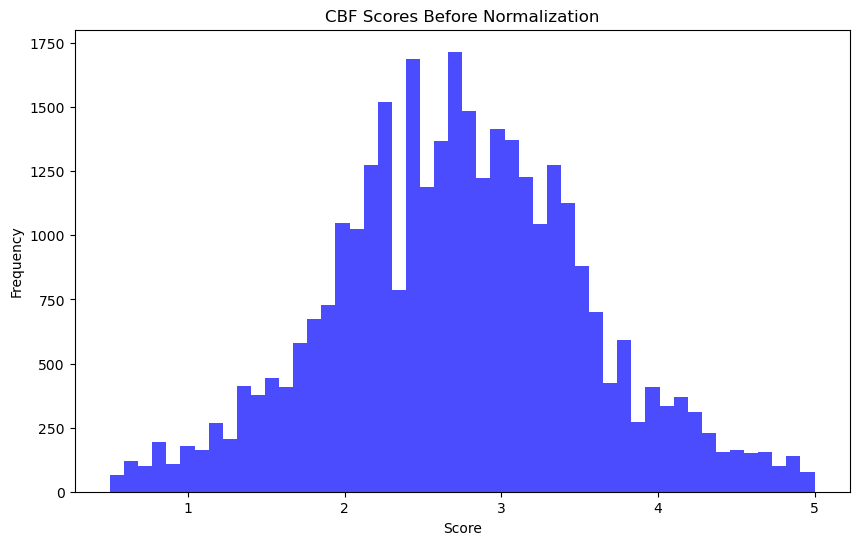

INFO:root:CBF scores (normalized): [3.87496275 2.23442829 2.67186029 2.45246291 2.32376696 2.24011781
 3.44333229 2.31972484 2.28371925 2.28371925]


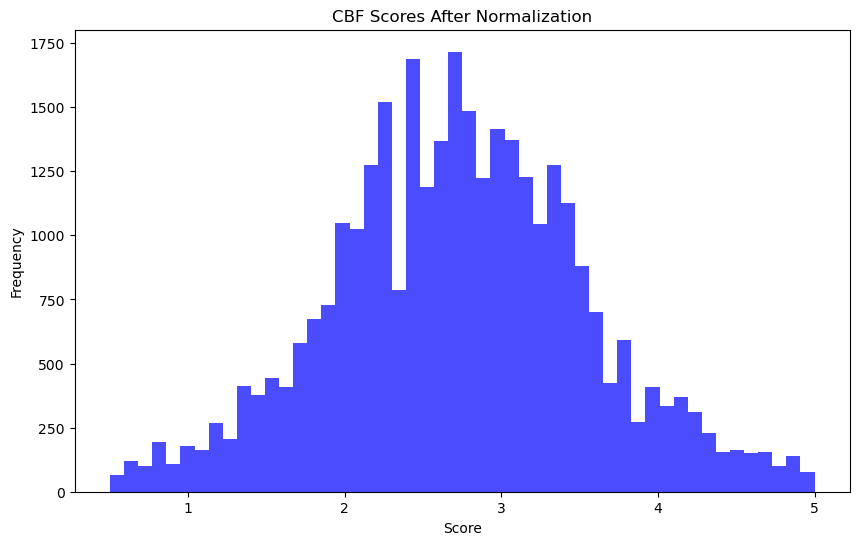

In [2]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        # Add "no genres listed" feature
        merged_df['no genres listed'] = (merged_df['genres'] == '(no genres listed)').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Raw Item Features (first 10): {item_features.head(10)}")

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Standardized Item Features (first 10): {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    
    logging.info(f"Raw User Preferences (first 10): {user_genre_means.head(10)}")
    
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    logging.info(f"Standardized User Preferences (first 10): {user_genre_means.head(10)}")
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores normalized: min = {min(cbf_scores)}, max = {max(cbf_scores)}")

    return cbf_scores, user_ids, item_ids

def plot_score_distributions(scores, title):
    """Plot the distribution of scores."""
    plt.figure(figsize=(10, 6))
    plt.hist(scores, bins=50, color='blue', alpha=0.7)
    plt.title(title)
    plt.xlabel('Score')
    plt.ylabel('Frequency')
    plt.show()

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Analyze the "no genres listed" feature
    if 'no genres listed' in merged_df.columns:
        logging.info(f"'No genres listed' feature distribution: {merged_df['no genres listed'].value_counts()}")

    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Identify zero-rated features
    zero_rated_features = item_features.columns[item_features.sum() == 0]
    logging.info(f"Zero-rated features: {zero_rated_features.tolist()}")
    
    # Exclude zero-rated features if necessary
    item_features = item_features.drop(columns=zero_rated_features)
    non_zero_columns = item_features.columns.tolist()

    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Print intermediate steps
    logging.info(f"Item Features (first 10): {item_features.head(10)}")
    logging.info(f"User Preferences (first 10): {user_preferences.head(10)}")
    
    # Calculate CBF scores
    cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Plot CBF scores before normalization
    plot_score_distributions(cbf_scores, 'CBF Scores Before Normalization')
    
    # Check for outliers
    logging.info(f"CBF scores (normalized): {cbf_scores[:10]}")
    
    # Plot CBF scores after normalization
    plot_score_distributions(cbf_scores, 'CBF Scores After Normalization')

else:
    logging.error("Failed to load and preprocess data.")


In [6]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Raw Item Features (first 10): {item_features.head(10)}")

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Standardized Item Features (first 10): {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    
    logging.info(f"Raw User Preferences (first 10): {user_genre_means.head(10)}")
    
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    logging.info(f"Standardized User Preferences (first 10): {user_genre_means.head(10)}")
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Analyze the "no genres listed" feature
    if 'no genres listed' in merged_df.columns:
        logging.info(f"'No genres listed' feature distribution: {merged_df['no genres listed'].value_counts()}")

    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Identify zero-rated features
    zero_rated_features = item_features.columns[item_features.sum() == 0]
    logging.info(f"Zero-rated features: {zero_rated_features.tolist()}")
    
    # Exclude zero-rated features if necessary
    item_features = item_features.drop(columns=zero_rated_features)
    non_zero_columns = item_features.columns.tolist()

    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Print intermediate steps
    logging.info(f"Item Features (first 10): {item_features.head(10)}")
    logging.info(f"User Preferences (first 10): {user_preferences.head(10)}")
    
    # Calculate CBF scores
    cbf_scores, normalized_cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Plot CBF scores before and after normalization
    plot_score_distributions(cbf_scores, normalized_cbf_scores, 'CBF Scores')

    # Check for outliers
    logging.info(f"CBF scores (first 10): {cbf_scores[:10]}")
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

else:
    logging.error("Failed to load and preprocess data.")


SyntaxError: unterminated string literal (detected at line 34) (4092353407.py, line 34)

In [8]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['    
                                                                      
            except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Raw Item Features (first 10): {item_features.head(10)}")

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Standardized Item Features (first 10): {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    
    logging.info(f"Raw User Preferences (first 10): {user_genre_means.head(10)}")
    
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    logging.info(f"Standardized User Preferences (first 10): {user_genre_means.head(10)}")
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Analyze the "no genres listed" feature
    if 'no genres listed' in merged_df.columns:
        logging.info(f"'No genres listed' feature distribution: {merged_df['no genres listed'].value_counts()}")

    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Identify zero-rated features
    zero_rated_features = item_features.columns[item_features.sum() == 0]
    logging.info(f"Zero-rated features: {zero_rated_features.tolist()}")
    
    # Exclude zero-rated features if necessary
    item_features = item_features.drop(columns=zero_rated_features)
    non_zero_columns = item_features.columns.tolist()

    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Print intermediate steps
    logging.info(f"Item Features (first 10): {item_features.head(10)}")
    logging.info(f"User Preferences (first 10): {user_preferences.head(10)}")
    
    # Calculate CBF scores
    cbf_scores, normalized_cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Plot CBF scores before and after normalization
    plot_score_distributions(cbf_scores, normalized_cbf_scores, 'CBF Scores')

    # Check for outliers
    logging.info(f"CBF scores (first 10): {cbf_scores[:10]}")
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

else:
    logging.error("Failed to load and preprocess data.")



SyntaxError: unterminated string literal (detected at line 34) (3282442834.py, line 34)

INFO:root:'No genres listed' feature distribution: no genres listed
0    3090
Name: count, dtype: int64
INFO:root:Raw Item Features (first 10):          Drama  Action  Mystery  (no genres listed)  Children  Western  \
movieId                                                                  
1            0       0        0                   0         1        0   
3            0       0        0                   0         0        0   
6            0       1        0                   0         0        0   
47           0       0        1                   0         0        0   
50           0       0        1                   0         0        0   
70           0       1        0                   0         0        0   
110          1       1        0                   0         0        0   
163          0       1        0                   0         0        1   
216          0       0        0                   0         0        0   
223          0       0        0           

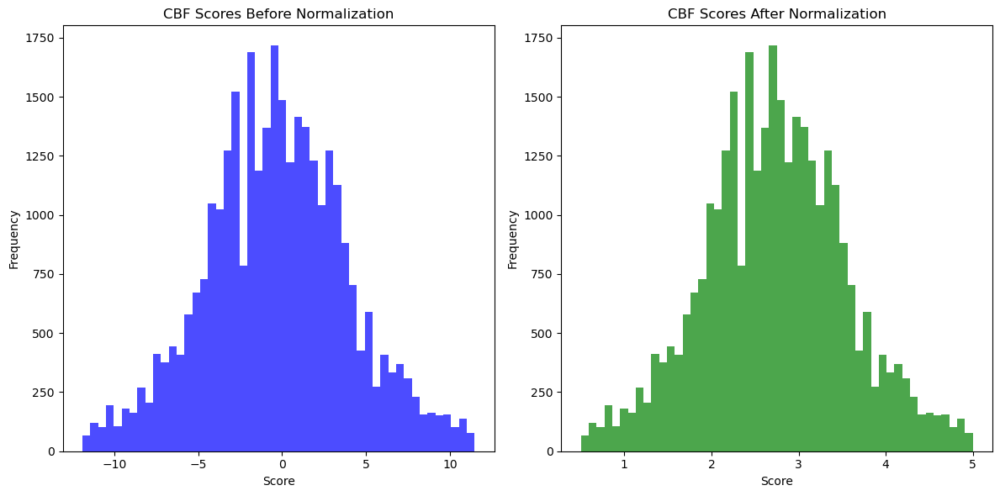

INFO:root:CBF scores (first 10): [ 5.63087129 -2.88404051 -0.61362496 -1.75236931 -2.42034349 -2.85451004
  3.39056768 -2.44132343 -2.62820427 -2.62820427]
INFO:root:CBF scores after normalization (first 10): [3.87496275 2.23442829 2.67186029 2.45246291 2.32376696 2.24011781
 3.44333229 2.31972484 2.28371925 2.28371925]


In [10]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
RANDOM_SEED = 42
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
USER_SAMPLE_SIZE = 20  # Set to None to use full dataset

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        # Add "no genres listed" feature
        merged_df['no genres listed'] = (merged_df['genres'] == '(no genres listed)').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def sample_data(df, user_sample_size):
    """Sample a subset of users and their data."""
    if user_sample_size is None:
        return df
    user_ids = df['userId'].unique()
    sampled_user_ids = np.random.choice(user_ids, user_sample_size, replace=False)
    return df[df['userId'].isin(sampled_user_ids)]

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def get_item_features(df, feature_columns):
    """Extract item features from dataframe and normalize them."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    logging.info(f"Raw Item Features (first 10): {item_features.head(10)}")

    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.warning(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    # Standardize the features
    item_features = standardize_features(item_features, non_zero_columns)
    logging.info(f"Standardized Item Features (first 10): {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    
    logging.info(f"Raw User Preferences (first 10): {user_genre_means.head(10)}")
    
    # Standardize user preferences
    user_genre_means = standardize_features(user_genre_means, user_genre_means.columns)
    logging.info(f"Standardized User Preferences (first 10): {user_genre_means.head(10)}")
    return user_genre_means

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Load and preprocess data
merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
if merged_df is not None and movies_df is not None and ratings_df is not None:
    # Sample data if necessary
    if USER_SAMPLE_SIZE is not None:
        merged_df = sample_data(merged_df, USER_SAMPLE_SIZE)
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    # Analyze the "no genres listed" feature
    if 'no genres listed' in merged_df.columns:
        logging.info(f"'No genres listed' feature distribution: {merged_df['no genres listed'].value_counts()}")

    # Extract item features
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    # Identify zero-rated features
    zero_rated_features = item_features.columns[item_features.sum() == 0]
    logging.info(f"Zero-rated features: {zero_rated_features.tolist()}")
    
    # Exclude zero-rated features if necessary
    item_features = item_features.drop(columns=zero_rated_features)
    non_zero_columns = item_features.columns.tolist()

    # Derive user preferences
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    
    # Print intermediate steps
    logging.info(f"Item Features (first 10): {item_features.head(10)}")
    logging.info(f"User Preferences (first 10): {user_preferences.head(10)}")
    
    # Calculate CBF scores
    cbf_scores, normalized_cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)
    
    # Plot CBF scores before and after normalization
    plot_score_distributions(cbf_scores, normalized_cbf_scores, 'CBF Scores')

    # Check for outliers
    logging.info(f"CBF scores (first 10): {cbf_scores[:10]}")
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

else:
    logging.error("Failed to load and preprocess data.")


# Back to main code

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:             Drama    Action   Mystery  Children   Western  Animation  \
movieId                                                                
1       -0.843655 -0.660598 -0.287006  3.154507 -0.139691   3.664680   
3       -0.843655 -0.660598 -0.287006 -0.317007 -0.139691  -0.272875   
6       -0.843655  1.513780 -0.287006 -0.317007 -0.139691  -0.272875   
47      -0.843655 -0.660598  3.484244 -0.317007 -0.139691  -0.272875   
50      -0.843655 -0.660598  3.484244 -0.317007 -0.139691  -0.272875   
70      -0.843655  1.513780 -0.287006 -0.317007 -0.139691  -0.272875   
101     -0.843655 -0.660598 -0.287006 -0.317007

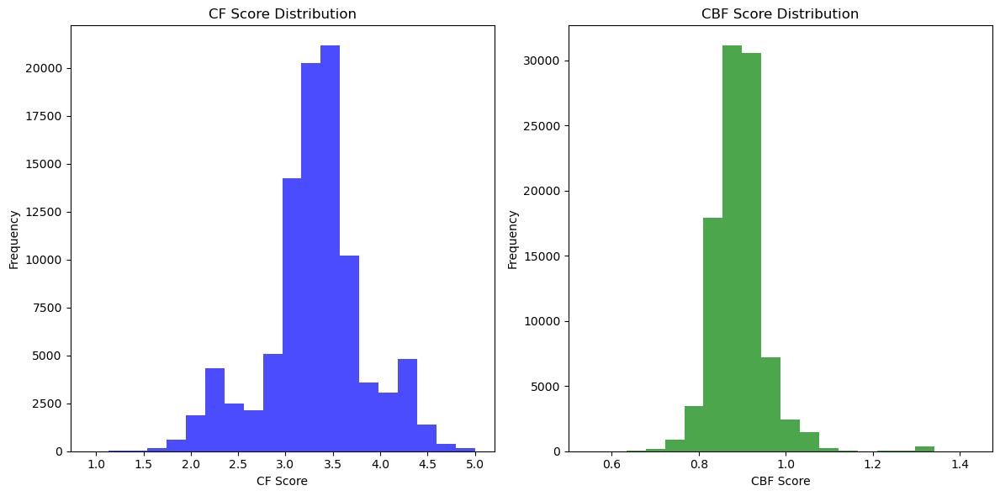


Top 3 recommendations for User 1:
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.61, CF Score: 4.74, CBF Score: 4.38, Popularity Penalty: 0.0393
Movie: Mary Poppins (1964), Hybrid Score: 4.54, CF Score: 4.89, CBF Score: 3.91, Popularity Penalty: 0.1164
Movie: Rudolph, the Red-Nosed Reindeer (1964), Hybrid Score: 4.54, CF Score: 4.34, CBF Score: 5.00, Popularity Penalty: 0.0049

Top 3 recommendations for User 2:
Movie: Everest (1998), Hybrid Score: 4.17, CF Score: 3.82, CBF Score: 5.00, Popularity Penalty: 0.0098
Movie: Hoop Dreams (1994), Hybrid Score: 4.12, CF Score: 4.05, CBF Score: 4.34, Popularity Penalty: 0.0475
Movie: Crumb (1994), Hybrid Score: 4.08, CF Score: 3.99, CBF Score: 4.34, Popularity Penalty: 0.0279

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 3.19, CF Score: 3.26, CBF Score: 3.14, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 3.17, CF Score: 3.20, CB

In [15]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        # Add "(no genres listed)" feature
        merged_df['no genres listed'] = (merged_df['genres'] == '(no genres listed)').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    # Normalize the CBF scores for the entire population
    normalized_cbf_scores = normalize_scores(cbf_scores)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:             Drama    Action   Mystery  Children   Western  Animation  \
movieId                                                                
1       -0.843655 -0.660598 -0.287006  3.154507 -0.139691   3.664680   
3       -0.843655 -0.660598 -0.287006 -0.317007 -0.139691  -0.272875   
6       -0.843655  1.513780 -0.287006 -0.317007 -0.139691  -0.272875   
47      -0.843655 -0.660598  3.484244 -0.317007 -0.139691  -0.272875   
50      -0.843655 -0.660598  3.484244 -0.317007 -0.139691  -0.272875   
70      -0.843655  1.513780 -0.287006 -0.317007 -0.139691  -0.272875   
101     -0.843655 -0.660598 -0.287006 -0.317007

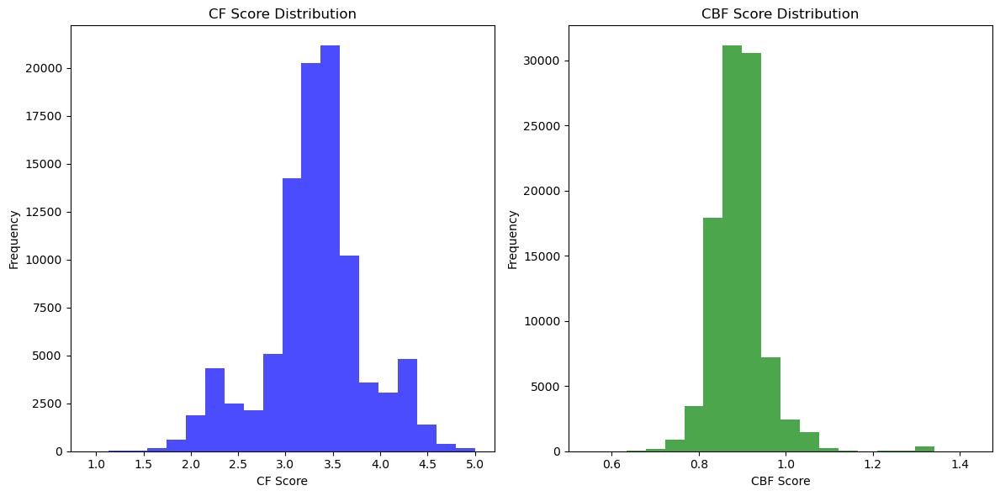


Top 3 recommendations for User 1:
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.61, CF Score: 4.74, CBF Score: 4.38, Popularity Penalty: 0.0393
Movie: Mary Poppins (1964), Hybrid Score: 4.54, CF Score: 4.89, CBF Score: 3.91, Popularity Penalty: 0.1164
Movie: Rudolph, the Red-Nosed Reindeer (1964), Hybrid Score: 4.54, CF Score: 4.34, CBF Score: 5.00, Popularity Penalty: 0.0049

Top 3 recommendations for User 2:
Movie: Everest (1998), Hybrid Score: 4.17, CF Score: 3.82, CBF Score: 5.00, Popularity Penalty: 0.0098
Movie: Hoop Dreams (1994), Hybrid Score: 4.12, CF Score: 4.05, CBF Score: 4.34, Popularity Penalty: 0.0475
Movie: Crumb (1994), Hybrid Score: 4.08, CF Score: 3.99, CBF Score: 4.34, Popularity Penalty: 0.0279

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 3.19, CF Score: 3.26, CBF Score: 3.14, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 3.17, CF Score: 3.20, CB

In [17]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        # Add "(no genres listed)" feature
        merged_df['no genres listed'] = (merged_df['genres'] == '(no genres listed)').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores):
    """Plot distributions of CF and CBF scores."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    # Normalize the CBF scores for the entire population
    normalized_cbf_scores = normalize_scores(cbf_scores)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:             Drama    Action   Mystery  Children   Western  Animation  \
movieId                                                                
1       -0.843655 -0.660598 -0.287006  3.154507 -0.139691   3.664680   
3       -0.843655 -0.660598 -0.287006 -0.317007 -0.139691  -0.272875   
6       -0.843655  1.513780 -0.287006 -0.317007 -0.139691  -0.272875   
47      -0.843655 -0.660598  3.484244 -0.317007 -0.139691  -0.272875   
50      -0.843655 -0.660598  3.484244 -0.317007 -0.139691  -0.272875   
70      -0.843655  1.513780 -0.287006 -0.317007 -0.139691  -0.272875   
101     -0.843655 -0.660598 -0.287006 -0.317007

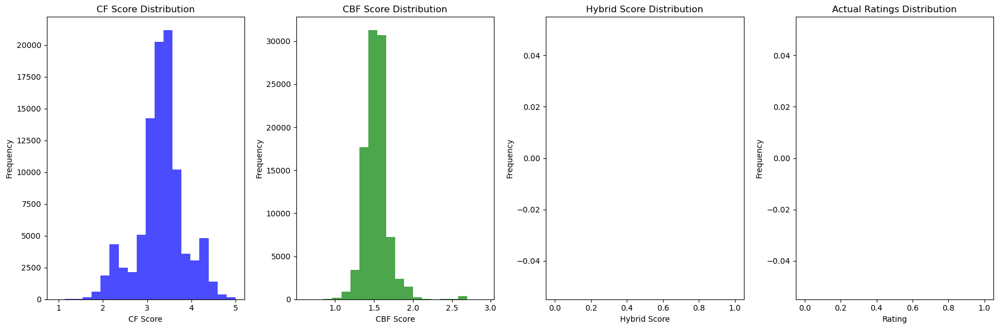


Top 3 recommendations for User 1:
Movie: Laputa: Castle in the Sky (Tenkû no shiro Rapyuta) (1986), Hybrid Score: 4.61, CF Score: 4.74, CBF Score: 4.38, Popularity Penalty: 0.0393
Movie: Mary Poppins (1964), Hybrid Score: 4.54, CF Score: 4.89, CBF Score: 3.91, Popularity Penalty: 0.1164
Movie: Rudolph, the Red-Nosed Reindeer (1964), Hybrid Score: 4.54, CF Score: 4.34, CBF Score: 5.00, Popularity Penalty: 0.0049

Top 3 recommendations for User 2:
Movie: Everest (1998), Hybrid Score: 4.17, CF Score: 3.82, CBF Score: 5.00, Popularity Penalty: 0.0098
Movie: Hoop Dreams (1994), Hybrid Score: 4.12, CF Score: 4.05, CBF Score: 4.34, Popularity Penalty: 0.0475
Movie: Crumb (1994), Hybrid Score: 4.08, CF Score: 3.99, CBF Score: 4.34, Popularity Penalty: 0.0279

Top 3 recommendations for User 3:
Movie: Lawrence of Arabia (1962), Hybrid Score: 3.19, CF Score: 3.26, CBF Score: 3.14, Popularity Penalty: 0.0738
Movie: Ghost in the Shell (Kôkaku kidôtai) (1995), Hybrid Score: 3.17, CF Score: 3.20, CB

In [19]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, hybrid_scores, actual_ratings):
    """Plot distributions of CF, CBF, Hybrid scores and actual ratings."""
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 4, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 3)
    plt.hist(hybrid_scores, bins=20, color='purple', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 4)
    plt.hist(actual_ratings, bins=20, color='orange', alpha=0.7)
    plt.title('Actual Ratings Distribution')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate scores for the entire dataset using parallel processing
    cf_scores, cbf_scores, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    # Normalize the CBF scores for the entire population
    normalized_cbf_scores = normalize_scores(cbf_scores)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores, all_hybrid_scores, all_actual_ratings)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()


In [ ]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Remove this if you want to use the full dataset

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, hybrid_scores, actual_ratings):
    """Plot distributions of CF, CBF, Hybrid scores and actual ratings."""
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 4, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 3)
    plt.hist(hybrid_scores, bins=20, color='purple', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 4)
    plt.hist(actual_ratings, bins=20, color='orange', alpha=0.7)
    plt.title('Actual Ratings Distribution')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate CBF scores separately before calculating combined scores
    cbf_scores, normalized_cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)

    # Calculate CF scores for the entire dataset using parallel processing
    cf_scores, _, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores, all_hybrid_scores, all_actual_ratings)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:             Drama    Action   Mystery  Children   Western  Animation  \
movieId                                                                
1       -0.843655 -0.660598 -0.287006  3.154507 -0.139691   3.664680   
3       -0.843655 -0.660598 -0.287006 -0.317007 -0.139691  -0.272875   
6       -0.843655  1.513780 -0.287006 -0.317007 -0.139691  -0.272875   
47      -0.843655 -0.660598  3.484244 -0.317007 -0.139691  -0.272875   
50      -0.843655 -0.660598  3.484244 -0.317007 -0.139691  -0.272875   
70      -0.843655  1.513780 -0.287006 -0.317007 -0.139691  -0.272875   
101     -0.843655 -0.660598 -0.287006 -0.317007

INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:            Comedy    Action  Thriller   Western    Horror  Animation  \
movieId                                                                
1        1.257788 -0.660598 -0.596334 -0.139691 -0.279179   3.664680   
3        1.257788 -0.660598 -0.596334 -0.139691 -0.279179  -0.272875   
6       -0.795047  1.513780  1.676913 -0.139691 -0.279179  -0.272875   
47      -0.795047 -0.660598  1.676913 -0.139691 -0.279179  -0.272875   
50      -0.795047 -0.660598  1.676913 -0.139691 -0.279179  -0.272875   
70       1.257788  1.513780  1.676913 -0.139691  3.581927  -0.272875   
101      1.257788 -0.660598 -0.596334 -0.139691

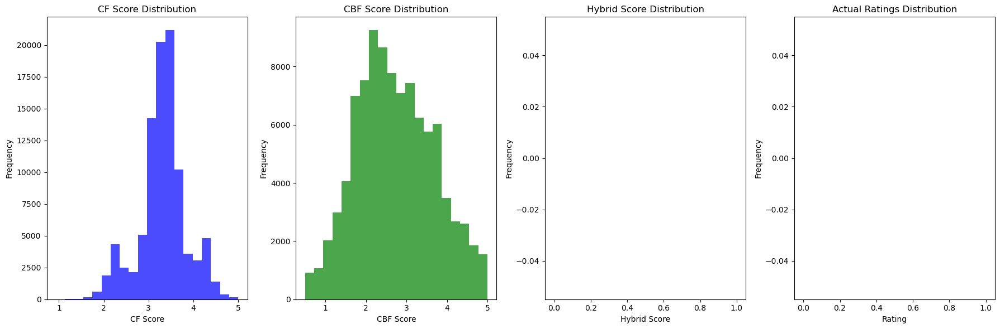

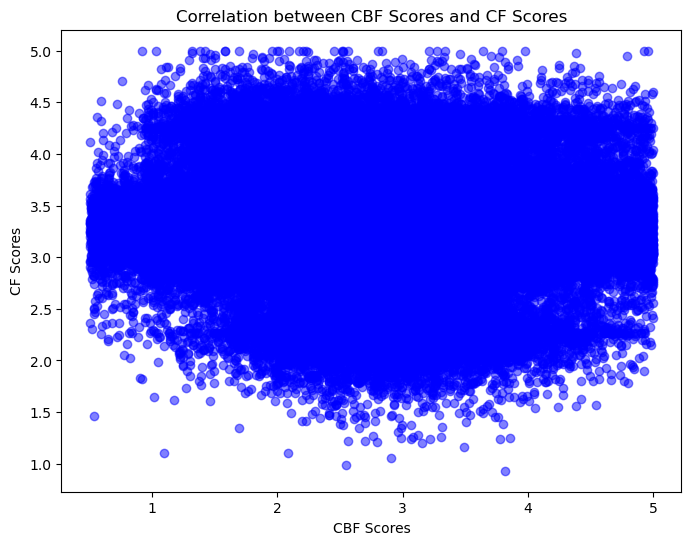


Top 3 recommendations for User 1:
Movie: Chinatown (1974), Hybrid Score: 4.93, CF Score: 5.00, CBF Score: 4.93, Popularity Penalty: 0.0967
Movie: Rear Window (1954), Hybrid Score: 4.92, CF Score: 5.00, CBF Score: 4.96, Popularity Penalty: 0.1377
Movie: North by Northwest (1959), Hybrid Score: 4.86, CF Score: 4.95, CBF Score: 4.79, Popularity Penalty: 0.0934

Top 3 recommendations for User 2:
Movie: Philadelphia Story, The (1940), Hybrid Score: 4.44, CF Score: 4.27, CBF Score: 4.91, Popularity Penalty: 0.0475
Movie: All the President's Men (1976), Hybrid Score: 4.34, CF Score: 4.14, CBF Score: 4.89, Popularity Penalty: 0.0443
Movie: For a Few Dollars More (Per qualche dollaro in più) (1965), Hybrid Score: 4.29, CF Score: 4.07, CBF Score: 4.89, Popularity Penalty: 0.0541

Top 3 recommendations for User 3:
Movie: Doctor Zhivago (1965), Hybrid Score: 3.50, CF Score: 2.91, CBF Score: 4.95, Popularity Penalty: 0.0344
Movie: Dark Knight, The (2008), Hybrid Score: 3.45, CF Score: 3.14, CBF Sc

In [8]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 100  # Remove this if you want to use the full dataset

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique())

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        personalization += 1 - (len(recs1 & recs2) / len(recs1 | recs2))
    return personalization / (user_count * (user_count - 1) / 2) if user_count > 1 else 0

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, hybrid_scores, actual_ratings):
    """Plot distributions of CF, CBF, Hybrid scores and actual ratings."""
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 4, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 3)
    plt.hist(hybrid_scores, bins=20, color='purple', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 4)
    plt.hist(actual_ratings, bins=20, color='orange', alpha=0.7)
    plt.title('Actual Ratings Distribution')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def plot_correlation(cbf_scores, cf_scores):
    """Plot the correlation between CBF scores and CF scores."""
    plt.figure(figsize=(8, 6))
    plt.scatter(cbf_scores, cf_scores, alpha=0.5, color='blue')
    plt.title('Correlation between CBF Scores and CF Scores')
    plt.xlabel('CBF Scores')
    plt.ylabel('CF Scores')
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate CBF scores separately before calculating combined scores
    cbf_scores, normalized_cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)

    # Calculate CF scores for the entire dataset using parallel processing
    cf_scores, _, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores, all_hybrid_scores, all_actual_ratings)
    plot_correlation(all_cbf_scores, all_cf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:            Comedy    Action  Thriller   Western    Horror  Animation  \
movieId                                                                
1        1.257788 -0.660598 -0.596334 -0.139691 -0.279179   3.664680   
3        1.257788 -0.660598 -0.596334 -0.139691 -0.279179  -0.272875   
6       -0.795047  1.513780  1.676913 -0.139691 -0.279179  -0.272875   
47      -0.795047 -0.660598  1.676913 -0.139691 -0.279179  -0.272875   
50      -0.795047 -0.660598  1.676913 -0.139691 -0.279179  -0.272875   
70       1.257788  1.513780  1.676913 -0.139691  3.581927  -0.272875   
101      1.257788 -0.660598 -0.596334 -0.139691

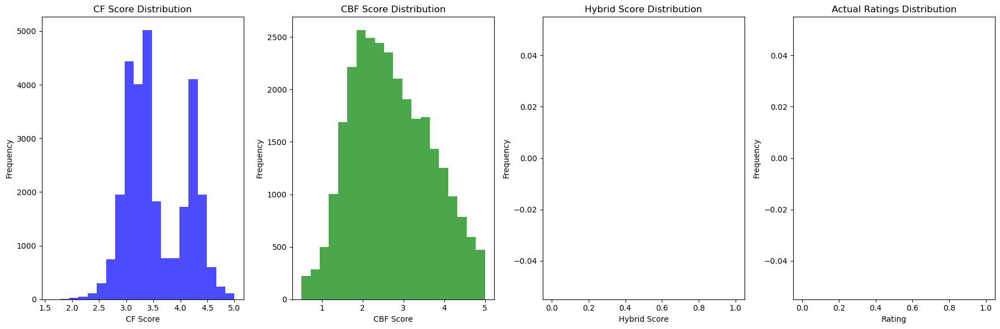

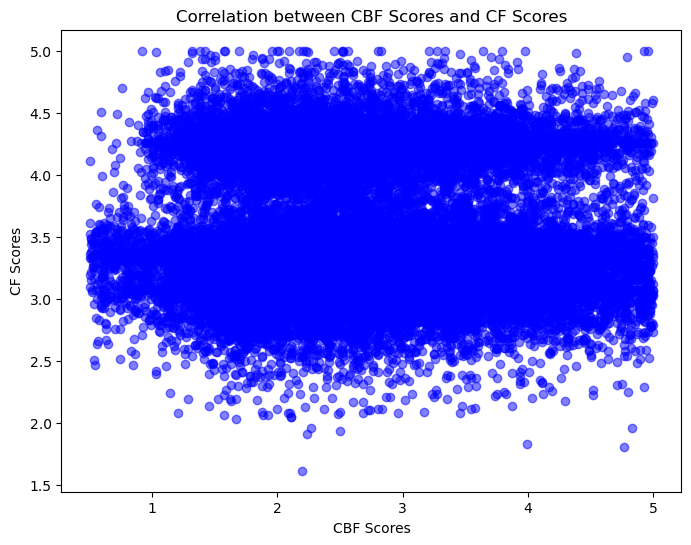


Top 3 recommendations for User 1:
Movie: Chinatown (1974), Hybrid Score: 4.93, CF Score: 5.00, CBF Score: 4.93, Popularity Penalty: 0.0967
Movie: Rear Window (1954), Hybrid Score: 4.92, CF Score: 5.00, CBF Score: 4.96, Popularity Penalty: 0.1377
Movie: North by Northwest (1959), Hybrid Score: 4.86, CF Score: 4.95, CBF Score: 4.79, Popularity Penalty: 0.0934

Top 3 recommendations for User 2:

Top 3 recommendations for User 3:

Top 3 recommendations for User 4:

Top 3 recommendations for User 5:
Movie: Good, the Bad and the Ugly, The (Buono, il brutto, il cattivo, Il) (1966), Hybrid Score: 4.33, CF Score: 4.16, CBF Score: 4.92, Popularity Penalty: 0.1180
Movie: Streetcar Named Desire, A (1951), Hybrid Score: 4.29, CF Score: 4.11, CBF Score: 4.74, Popularity Penalty: 0.0328
Movie: Rocky (1976), Hybrid Score: 4.23, CF Score: 4.04, CBF Score: 4.85, Popularity Penalty: 0.1049

Top 3 recommendations for User 6:

Top 3 recommendations for User 7:
Movie: Man Bites Dog (C'est arrivé près de ch

In [9]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def add_year_feature(df, year_divisor):
    """Add years since release feature to dataframe."""
    current_year = pd.to_datetime('now').year
    df['years_since_release'] = (current_year - df['release_year']) / year_divisor
    df['years_since_release'] = df['years_since_release'].clip(lower=0)
    return df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    if len(scores) == 0:
        return np.array(scores)
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    if len(scores) == 0:
        return scores, user_ids, item_ids
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique()[:USER_SAMPLE_SIZE])

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        union_len = len(recs1 | recs2)
        if union_len > 0:
            personalization += 1 - (len(recs1 & recs2) / union_len)
    if user_count > 1:
        personalization /= (user_count * (user_count - 1) / 2)
    else:
        personalization = 0
    return personalization

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, hybrid_scores, actual_ratings):
    """Plot distributions of CF, CBF, Hybrid scores and actual ratings."""
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 4, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 3)
    plt.hist(hybrid_scores, bins=20, color='purple', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 4)
    plt.hist(actual_ratings, bins=20, color='orange', alpha=0.7)
    plt.title('Actual Ratings Distribution')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def plot_correlation(cbf_scores, cf_scores):
    """Plot the correlation between CBF scores and CF scores."""
    plt.figure(figsize=(8, 6))
    plt.scatter(cbf_scores, cf_scores, alpha=0.5, color='blue')
    plt.title('Correlation between CBF Scores and CF Scores')
    plt.xlabel('CBF Scores')
    plt.ylabel('CF Scores')
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    merged_df = add_year_feature(merged_df, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate CBF scores separately before calculating combined scores
    cbf_scores, normalized_cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)

    # Calculate CF scores for the entire dataset using parallel processing
    cf_scores, _, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores, all_hybrid_scores, all_actual_ratings)
    plot_correlation(all_cbf_scores, all_cf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()


INFO:root:Starting main function.
INFO:root:Best parameters: {'n_factors': 50, 'n_epochs': 20, 'lr_all': 0.005, 'reg_all': 0.02, 'biased': True}
INFO:root:RMSE: 0.8786
INFO:root:MAE: 0.6755
INFO:root:Precision: 0.8069
INFO:root:Recall: 0.3228
INFO:root:F1 Score: 0.4611
INFO:root:Zeroed columns identified and removed: ['(no genres listed)']
INFO:root:Item features extracted:            Comedy    Action  Thriller   Western    Horror  Animation  \
movieId                                                                
1        1.257788 -0.660598 -0.596334 -0.139691 -0.279179   3.664680   
3        1.257788 -0.660598 -0.596334 -0.139691 -0.279179  -0.272875   
6       -0.795047  1.513780  1.676913 -0.139691 -0.279179  -0.272875   
47      -0.795047 -0.660598  1.676913 -0.139691 -0.279179  -0.272875   
50      -0.795047 -0.660598  1.676913 -0.139691 -0.279179  -0.272875   
70       1.257788  1.513780  1.676913 -0.139691  3.581927  -0.272875   
101      1.257788 -0.660598 -0.596334 -0.139691

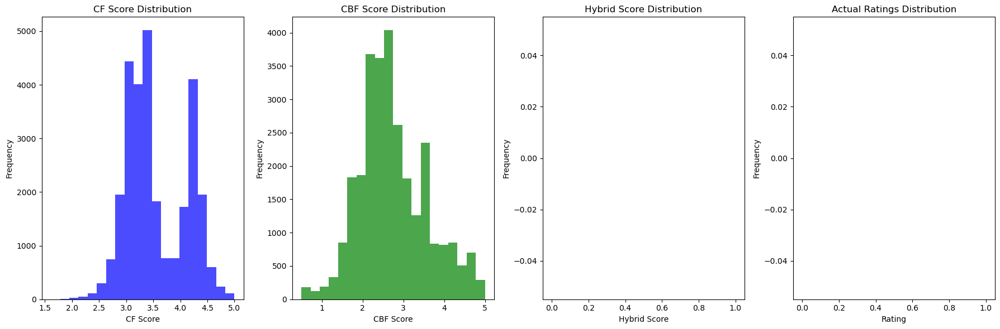

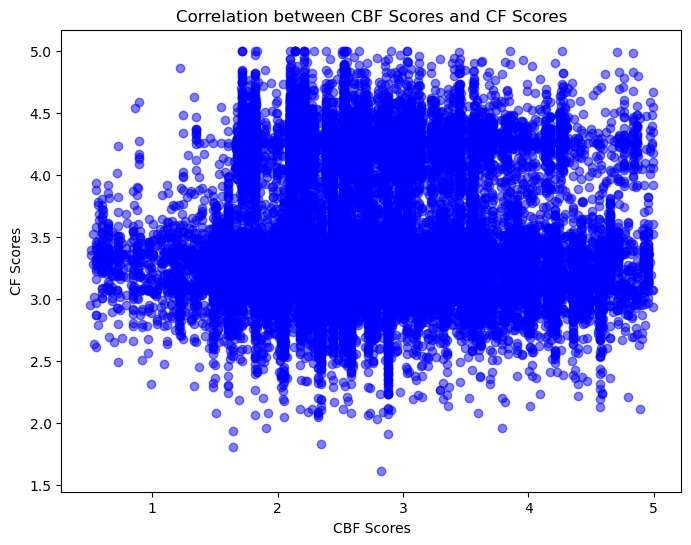


Top 3 recommendations for User 1:
Movie: Fish Called Wanda, A (1988), Hybrid Score: 4.87, CF Score: 4.98, CBF Score: 4.83, Popularity Penalty: 0.1164
Movie: Femme Nikita, La (Nikita) (1990), Hybrid Score: 4.87, CF Score: 4.99, CBF Score: 4.69, Popularity Penalty: 0.0574
Movie: Bronx Tale, A (1993), Hybrid Score: 4.78, CF Score: 4.83, CBF Score: 4.71, Popularity Penalty: 0.0295

Top 3 recommendations for User 2:

Top 3 recommendations for User 3:

Top 3 recommendations for User 4:

Top 3 recommendations for User 5:
Movie: Good, the Bad and the Ugly, The (Buono, il brutto, il cattivo, Il) (1966), Hybrid Score: 4.25, CF Score: 4.16, CBF Score: 4.67, Popularity Penalty: 0.1180
Movie: Dr. Horrible's Sing-Along Blog (2008), Hybrid Score: 4.20, CF Score: 3.92, CBF Score: 4.93, Popularity Penalty: 0.0393
Movie: Great Escape, The (1963), Hybrid Score: 4.19, CF Score: 4.04, CBF Score: 4.65, Popularity Penalty: 0.0705

Top 3 recommendations for User 6:

Top 3 recommendations for User 7:
Movie: L

In [12]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 3
YEAR_DIVISOR = 1.0
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = 20  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.5
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.9

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.INFO)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    if len(scores) == 0:
        return np.array(scores)
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    if len(scores) == 0:
        return scores, user_ids, item_ids
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique()[:USER_SAMPLE_SIZE])

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        union_len = len(recs1 | recs2)
        if union_len > 0:
            personalization += 1 - (len(recs1 & recs2) / union_len)
    if user_count > 1:
        personalization /= (user_count * (user_count - 1) / 2)
    else:
        personalization = 0
    return personalization

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, hybrid_scores, actual_ratings):
    """Plot distributions of CF, CBF, Hybrid scores and actual ratings."""
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 4, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 3)
    plt.hist(hybrid_scores, bins=20, color='purple', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 4)
    plt.hist(actual_ratings, bins=20, color='orange', alpha=0.7)
    plt.title('Actual Ratings Distribution')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def plot_correlation(cbf_scores, cf_scores):
    """Plot the correlation between CBF scores and CF scores."""
    plt.figure(figsize=(8, 6))
    plt.scatter(cbf_scores, cf_scores, alpha=0.5, color='blue')
    plt.title('Correlation between CBF Scores and CF Scores')
    plt.xlabel('CBF Scores')
    plt.ylabel('CF Scores')
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate CBF scores separately before calculating combined scores
    cbf_scores, normalized_cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)

    # Calculate CF scores for the entire dataset using parallel processing
    cf_scores, _, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores, all_hybrid_scores, all_actual_ratings)
    plot_correlation(all_cbf_scores, all_cf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()


# APPEARS TO BE LAST ONE THAT RAN CORRECTLY
# FIXED CBF SCORES BUT TURNED OFF ADD_YEAR FUNCTION (but time decay feature does something similar, which is redundant anyway)) AND NO DISTRIBUTION PENALTY - takes too long to calculate


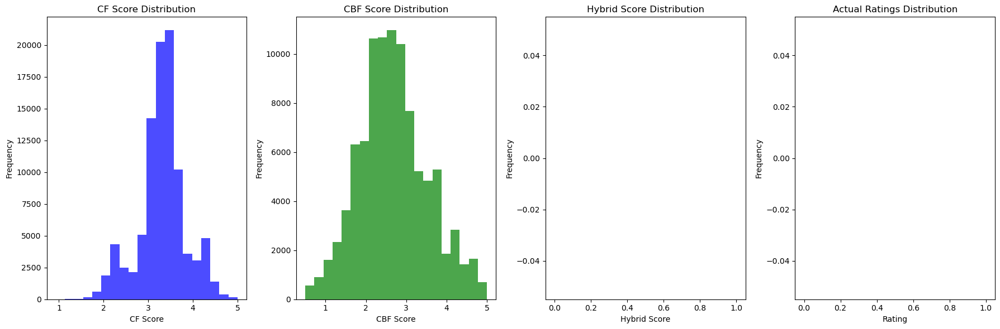

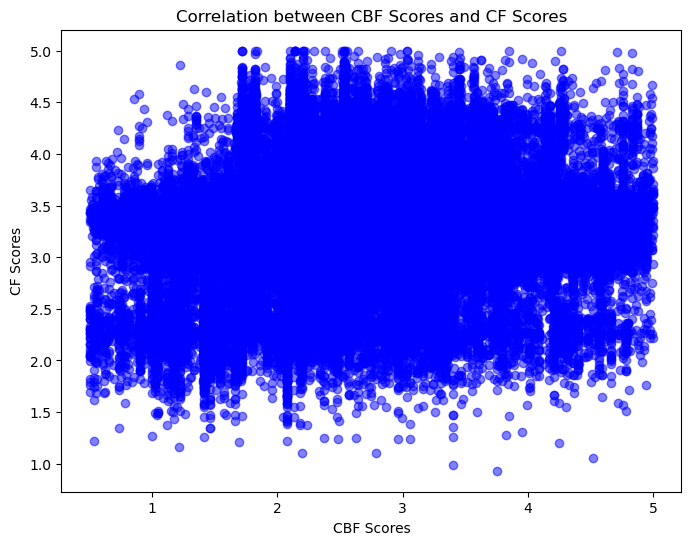


Top 5 recommendations for User 1:
Movie: Femme Nikita, La (Nikita) (1990), Hybrid Score: 4.86, CF Score: 4.99, CBF Score: 4.69, Popularity Penalty: 0.0574
Movie: Fish Called Wanda, A (1988), Hybrid Score: 4.85, CF Score: 4.98, CBF Score: 4.83, Popularity Penalty: 0.1164
Movie: Bronx Tale, A (1993), Hybrid Score: 4.77, CF Score: 4.83, CBF Score: 4.71, Popularity Penalty: 0.0295
Movie: Brazil (1985), Hybrid Score: 4.76, CF Score: 4.83, CBF Score: 4.83, Popularity Penalty: 0.0967
Movie: All About Eve (1950), Hybrid Score: 4.74, CF Score: 4.67, CBF Score: 5.00, Popularity Penalty: 0.0393

Top 5 recommendations for User 2:
Movie: Bridge on the River Kwai, The (1957), Hybrid Score: 4.32, CF Score: 4.20, CBF Score: 4.78, Popularity Penalty: 0.0738
Movie: Life Is Beautiful (La Vita è bella) (1997), Hybrid Score: 4.27, CF Score: 4.15, CBF Score: 4.89, Popularity Penalty: 0.1443
Movie: Brazil (1985), Hybrid Score: 4.22, CF Score: 4.16, CBF Score: 4.58, Popularity Penalty: 0.0967
Movie: Delirium

In [5]:
import pandas as pd
import numpy as np
import logging
import itertools
import re
from surprise import Dataset, Reader, SVD
from surprise.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_squared_error, mean_absolute_error, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
import time
from joblib import Parallel, delayed

# Constants
MOVIES_FILE = '../data/movies.csv'
RATINGS_FILE = '../data/ratings.csv'
N_RECOMMENDATIONS = 5
YEAR_DIVISOR = 0.5
RATING_THRESHOLD = 4.0
RANDOM_SEED = 42
USER_SAMPLE_SIZE = None  # Adjust based on your memory capacity

# Weights for hybrid scoring
CF_WEIGHT = 0.7
CBF_WEIGHT = 0.3
POPULARITY_PENALTY_WEIGHT = 0.7
DIVERSITY_PENALTY_WEIGHT = 0.0  # Turn off diversity penalty
TIME_DECAY_FACTOR = 0.99

# Set random seeds for reproducibility
np.random.seed(RANDOM_SEED)

# Logging configuration
logging.basicConfig(level=logging.WARNING)

def load_data(movies_file, ratings_file):
    """Load and preprocess movies and ratings data."""
    try:
        movies_df = pd.read_csv(movies_file)
        ratings_df = pd.read_csv(ratings_file)
        ratings_df['timestamp'] = pd.to_datetime(ratings_df['timestamp'], unit='s')

        merged_df = pd.merge(ratings_df, movies_df, on='movieId')
        if 'release_year' not in merged_df.columns:
            merged_df['release_year'] = merged_df['title'].str.extract(r'\((\d{4})\)')[0].astype(float)

        genre_list = list(set(itertools.chain.from_iterable(merged_df['genres'].str.split('|'))))
        for genre in genre_list:
            genre_pattern = re.escape(genre)
            merged_df[genre] = merged_df['genres'].str.contains(r'\b' + genre_pattern + r'\b').astype(int)

        return merged_df, movies_df, ratings_df
    except FileNotFoundError as fnf_error:
        logging.error(f"File not found: {fnf_error}")
        return None, None, None
    except Exception as e:
        logging.error(f"Error loading data: {e}")
        return None, None, None

def apply_time_decay(ratings_df, decay_factor, year_divisor):
    """Apply time decay to ratings."""
    current_time = pd.to_datetime('now')
    time_diff_days = (current_time - ratings_df['timestamp']).dt.total_seconds() / (3600 * 24)
    time_weights = decay_factor ** (time_diff_days / 365)
    
    year_diff = (current_time.year - ratings_df['release_year']) / year_divisor
    adjusted_ratings = ratings_df['rating'] * time_weights / (1 + year_diff)
    
    min_rating, max_rating = adjusted_ratings.min(), adjusted_ratings.max()
    if min_rating != max_rating:
        adjusted_ratings = 5.0 * (adjusted_ratings - min_rating) / (max_rating - min_rating)
    
    ratings_df['adjusted_rating'] = adjusted_ratings.clip(0.5, 5.0).round(1)
    
    return ratings_df

def standardize_features(df, feature_columns):
    """Standardize selected features in dataframe."""
    scaler = StandardScaler()
    df[feature_columns] = scaler.fit_transform(df[feature_columns])
    return df

def get_item_features(df, feature_columns):
    """Extract item features from dataframe."""
    item_features = df[['movieId'] + feature_columns].drop_duplicates().set_index('movieId')
    item_features = item_features.loc[~item_features.index.duplicated(keep='first')]
    item_features = item_features.fillna(0)
    
    zeroed_columns = [col for col in item_features.columns if item_features[col].sum() == 0]
    if zeroed_columns:
        logging.info(f"Zeroed columns identified and removed: {zeroed_columns}")
        item_features = item_features.drop(columns=zeroed_columns)
    
    non_zero_columns = item_features.columns.tolist()
    logging.info(f"Item features extracted: {item_features.head(10)}")
    return item_features, non_zero_columns

def derive_user_preferences(df, feature_columns):
    """Calculate user preferences based on features."""
    user_genre_means = df.groupby('userId')[feature_columns].mean().add_prefix('user_mean_')
    user_genre_means = user_genre_means.fillna(0)
    return user_genre_means

def normalize_scores(scores, new_min=0.5, new_max=5.0):
    """Normalize scores to a specified scale."""
    if len(scores) == 0:
        return np.array(scores)
    scores = np.array(scores)
    min_score, max_score = np.nanmin(scores), np.nanmax(scores)
    logging.info(f"Before normalization: min_score = {min_score}, max_score = {max_score}")
    if max_score != min_score:
        normalized_scores = new_min + (new_max - new_min) * (scores - min_score) / (max_score - min_score)
    else:
        normalized_scores = scores
    normalized_scores = normalized_scores.clip(new_min, new_max)
    logging.info(f"After normalization: min_score = {normalized_scores.min()}, max_score = {normalized_scores.max()}")
    return normalized_scores

def detect_and_print_outliers(scores, user_ids, item_ids):
    """Detect and print outliers using the IQR method."""
    if len(scores) == 0:
        return scores, user_ids, item_ids
    q1, q3 = np.percentile(scores, [25, 75])
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    outlier_mask = (scores < lower_bound) | (scores > upper_bound)
    outliers = scores[outlier_mask]
    outlier_user_ids = np.array(user_ids)[outlier_mask].tolist()
    outlier_item_ids = np.array(item_ids)[outlier_mask].tolist()
    
    if len(outliers) > 0:
        logging.info("Outliers detected (first 10):")
        for score, user_id, item_id in zip(outliers[:10], outlier_user_ids[:10], outlier_item_ids[:10]):
            logging.info(f"User ID: {user_id}, Item ID: {item_id}, CBF Score: {score}")
    else:
        logging.info("No outliers detected.")
    
    # Remove outliers
    filtered_scores = scores[~outlier_mask]
    filtered_user_ids = np.array(user_ids)[~outlier_mask].tolist()
    filtered_item_ids = np.array(item_ids)[~outlier_mask].tolist()
    
    return filtered_scores, filtered_user_ids, filtered_item_ids

def calculate_cbf_scores(df, item_features, user_preferences):
    """Calculate CBF scores for all users and items."""
    cbf_scores = []
    user_ids = []
    item_ids = []

    for user_id in user_preferences.index:
        for item_id in item_features.index:
            item_feature_vector = item_features.loc[item_id].values
            user_preference_vector = user_preferences.loc[user_id].values

            if len(item_feature_vector) != len(user_preference_vector):
                logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                continue

            # Calculate contributions to the CBF score
            contributions = item_feature_vector * user_preference_vector
            content_score = np.dot(item_feature_vector, user_preference_vector)
            if len(cbf_scores) < 10:  # Log the first 10 results
                logging.debug(f"User ID: {user_id}, Item ID: {item_id}, Item Features: {item_feature_vector}, User Preferences: {user_preference_vector}, Contributions: {contributions}, CBF Score: {content_score}")
                logging.info(f"User ID: {user_id}, Item ID: {item_id}, Contributions: {dict(zip(item_features.columns, contributions))}, CBF Score: {content_score}")
            assert np.isclose(np.sum(contributions), content_score), "Sum of contributions does not match the CBF score"
            cbf_scores.append(content_score)
            user_ids.append(user_id)
            item_ids.append(item_id)

    # Detect, print, and remove outliers
    logging.info("Detecting and removing outliers from CBF scores...")
    cbf_scores = np.array(cbf_scores)
    logging.info(f"Raw CBF scores (first 10): {cbf_scores[:10]}")
    cbf_scores, user_ids, item_ids = detect_and_print_outliers(cbf_scores, user_ids, item_ids)
    
    # Normalize the CBF scores after removing outliers
    logging.info("Normalizing CBF scores...")
    normalized_cbf_scores = normalize_scores(cbf_scores)
    logging.info(f"CBF scores after normalization (first 10): {normalized_cbf_scores[:10]}")

    return cbf_scores, normalized_cbf_scores, user_ids, item_ids

def plot_score_distributions(scores_before, scores_after, title):
    """Plot the distribution of scores before and after normalization."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.hist(scores_before, bins=50, color='blue', alpha=0.7)
    plt.title(f'{title} Before Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 2, 2)
    plt.hist(scores_after, bins=50, color='green', alpha=0.7)
    plt.title(f'{title} After Normalization')
    plt.xlabel('Score')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def calculate_scores(algo, df, item_features, user_preferences):
    """Calculate CF and CBF scores for all users and items."""
    cf_scores = []
    cbf_scores = []
    user_ids = []
    item_ids = []

    def calculate_user_scores(user_id):
        user_cf_scores = []
        user_cbf_scores = []
        user_user_ids = []
        user_item_ids = []

        user_rated_items = set(df[df['userId'] == user_id]['movieId'].tolist())
        all_items = df['movieId'].unique()

        for item_id in all_items:
            if item_id not in user_rated_items:
                pred = algo.predict(user_id, item_id)
                user_cf_scores.append(pred.est)
                item_feature_vector = item_features.loc[item_id].values
                user_preference_vector = user_preferences.loc[user_id].values

                if len(item_feature_vector) != len(user_preference_vector):
                    logging.error(f"Feature length mismatch for item {item_id}: {len(item_feature_vector)} vs. {len(user_preference_vector)}")
                    continue

                content_score = np.dot(item_feature_vector, user_preference_vector)
                user_cbf_scores.append(content_score)
                user_user_ids.append(user_id)
                user_item_ids.append(item_id)

        return user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids

    results = Parallel(n_jobs=-1)(delayed(calculate_user_scores)(user_id) for user_id in df['userId'].unique()[:USER_SAMPLE_SIZE])

    for user_cf_scores, user_cbf_scores, user_user_ids, user_item_ids in results:
        cf_scores.extend(user_cf_scores)
        cbf_scores.extend(user_cbf_scores)
        user_ids.extend(user_user_ids)
        item_ids.extend(user_item_ids)

    return cf_scores, cbf_scores, user_ids, item_ids

def generate_recommendations(algo, df, user_id, n_recommendations, item_features, user_preferences, item_popularity, global_popularity, cf_scores, cbf_scores, user_ids, item_ids, verbose=False):
    """Generate recommendations for a user."""
    start_time = time.time()
    recommendations = []

    user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
    user_cf_scores = [cf_scores[i] for i in user_indices]
    user_cbf_scores = [cbf_scores[i] for i in user_indices]
    user_item_ids = [item_ids[i] for i in user_indices]

    # Normalize CBF scores only
    logging.info(f"CBF scores before normalization for user {user_id}: {user_cbf_scores}")
    normalized_cbf_scores = normalize_scores(user_cbf_scores)
    logging.info(f"CBF scores after normalization for user {user_id}: {normalized_cbf_scores}")

    for idx, item_id in enumerate(user_item_ids):
        cf_score = user_cf_scores[idx]  # CF scores are already in the correct range
        content_score = normalized_cbf_scores[idx]
        popularity_penalty = item_popularity.get(item_id, 0) / len(df['userId'].unique())
        hybrid_score = (CF_WEIGHT * cf_score + CBF_WEIGHT * content_score) - (POPULARITY_PENALTY_WEIGHT * popularity_penalty)

        if verbose:
            logging.debug(f"User {user_id}, Item {item_id}: CF {cf_score:.2f}, CBF {content_score:.2f}, Penalty {popularity_penalty:.4f}, Hybrid {hybrid_score:.2f}")
        recommendations.append((item_id, hybrid_score, cf_score, content_score, popularity_penalty))

    recommendations.sort(key=lambda x: x[1], reverse=True)
    recommendations = recommendations[:n_recommendations]

    logging.info(f"User {user_id}: Generated top {n_recommendations} recommendations in {time.time() - start_time:.2f} seconds")

    return recommendations

def calculate_item_popularity(df):
    """Calculate item popularity."""
    return df['movieId'].value_counts().to_dict()

def get_expected_recommendations(df):
    """Get expected recommendations based on rating threshold."""
    return df[df['rating'] >= RATING_THRESHOLD]['movieId'].unique()

def calculate_coverage(recommendations, catalog_size):
    """Calculate catalog coverage."""
    recommended_items = set(item for recs in recommendations.values() for item, _, _, _, _ in recs)
    coverage = len(recommended_items) / catalog_size
    return coverage

def calculate_novelty(recommendations, item_popularity):
    """Calculate novelty of recommendations."""
    total_items = sum(item_popularity.values())
    novelty = 0
    count = 0
    for recs in recommendations.values():
        for item, _, _, _, _ in recs:
            novelty += -np.log2(item_popularity.get(item, 1) / total_items)
            count += 1
    return novelty / count if count > 0 else 0

def calculate_personalization(recommendations):
    """Calculate personalization of recommendations."""
    personalization = 0
    user_count = len(recommendations)
    user_pairs = itertools.combinations(recommendations.keys(), 2)
    for user1, user2 in user_pairs:
        recs1 = set(item for item, _, _, _, _ in recommendations[user1])
        recs2 = set(item for item, _, _, _, _ in recommendations[user2])
        union_len = len(recs1 | recs2)
        if union_len > 0:
            personalization += 1 - (len(recs1 & recs2) / union_len)
    if user_count > 1:
        personalization /= (user_count * (user_count - 1) / 2)
    else:
        personalization = 0
    return personalization

def calculate_intra_list_similarity(recommendations, item_features):
    """Calculate intra-list diversity of recommendations."""
    total_similarity = 0
    count = 0
    for recs in recommendations.values():
        if len(recs) < 2:
            continue
        feature_vectors = np.array([item_features.loc[item_id].values for item_id, _, _, _, _ in recs])
        similarity_matrix = cosine_similarity(feature_vectors)
        total_similarity += np.sum(similarity_matrix) - len(recs)  # exclude self-similarity
        count += len(recs) * (len(recs) - 1)
    return total_similarity / count if count > 0 else 0

def calculate_model_metrics(predictions):
    """Calculate model performance metrics."""
    true_ratings = [pred.r_ui for pred in predictions if pred.r_ui >= 0.5]
    estimated_ratings = [pred.est for pred in predictions if pred.r_ui >= 0.5]

    rmse = np.sqrt(mean_squared_error(true_ratings, estimated_ratings))
    mae = mean_absolute_error(true_ratings, estimated_ratings)
    
    y_true = np.array([1 if true_r >= RATING_THRESHOLD else 0 for true_r in true_ratings])
    y_pred = np.array([1 if est >= RATING_THRESHOLD else 0 for est in estimated_ratings])
    
    precision = precision_score(y_true, y_pred, zero_division=0)
    recall = recall_score(y_true, y_pred, zero_division=0)
    f1 = f1_score(y_true, y_pred, zero_division=0)
    
    return {
        'RMSE': rmse,
        'MAE': mae,
        'Precision': precision,
        'Recall': recall,
        'F1 Score': f1
    }

def display_metrics(recommendations, catalog_size, item_popularity, expected_recommendations, user_preferences, item_features, df, n_recommendations):
    """Display model metrics."""
    coverage = calculate_coverage(recommendations, catalog_size)
    novelty = calculate_novelty(recommendations, item_popularity)
    personalization = calculate_personalization(recommendations)
    intra_list_diversity = calculate_intra_list_similarity(recommendations, item_features)

    logging.info(f"Catalog Coverage: {coverage:.2%}")
    logging.info(f"Average Novelty: {novelty:.4f}")
    logging.info(f"Personalization: {personalization:.4f}")
    logging.info(f"Intra-list Diversity: {intra_list_diversity:.4f}")

def plot_distributions(cf_scores, cbf_scores, hybrid_scores, actual_ratings):
    """Plot distributions of CF, CBF, Hybrid scores and actual ratings."""
    plt.figure(figsize=(18, 6))

    plt.subplot(1, 4, 1)
    plt.hist(cf_scores, bins=20, color='blue', alpha=0.7)
    plt.title('CF Score Distribution')
    plt.xlabel('CF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 2)
    plt.hist(cbf_scores, bins=20, color='green', alpha=0.7)
    plt.title('CBF Score Distribution')
    plt.xlabel('CBF Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 3)
    plt.hist(hybrid_scores, bins=20, color='purple', alpha=0.7)
    plt.title('Hybrid Score Distribution')
    plt.xlabel('Hybrid Score')
    plt.ylabel('Frequency')

    plt.subplot(1, 4, 4)
    plt.hist(actual_ratings, bins=20, color='orange', alpha=0.7)
    plt.title('Actual Ratings Distribution')
    plt.xlabel('Rating')
    plt.ylabel('Frequency')

    plt.tight_layout()
    plt.show()

def plot_correlation(cbf_scores, cf_scores):
    """Plot the correlation between CBF scores and CF scores."""
    plt.figure(figsize=(8, 6))
    plt.scatter(cbf_scores, cf_scores, alpha=0.5, color='blue')
    plt.title('Correlation between CBF Scores and CF Scores')
    plt.xlabel('CBF Scores')
    plt.ylabel('CF Scores')
    plt.show()

def main():
    logging.info("Starting main function.")
    merged_df, movies_df, ratings_df = load_data(MOVIES_FILE, RATINGS_FILE)
    if merged_df is None or movies_df is None or ratings_df is None:
        logging.error("Failed to load data. Exiting.")
        return
    
    merged_df = apply_time_decay(merged_df, TIME_DECAY_FACTOR, YEAR_DIVISOR)
    
    reader = Reader(rating_scale=(0.5, 5.0))
    data = Dataset.load_from_df(ratings_df[['userId', 'movieId', 'rating']], reader)
    trainset, testset = train_test_split(data, test_size=0.25, random_state=RANDOM_SEED)
    
    param_grid = {'n_factors': [50], 'n_epochs': [20], 'lr_all': [0.005], 'reg_all': [0.02], 'biased': [True]}
    gs = GridSearchCV(SVD, param_grid, measures=['rmse', 'mae'], cv=3)
    gs.fit(data)
    
    best_params = gs.best_params['rmse']
    logging.info(f"Best parameters: {best_params}")

    algo = SVD(**best_params)
    algo.fit(trainset)
    
    predictions = algo.test(testset)
    model_metrics = calculate_model_metrics(predictions)
    for metric, value in model_metrics.items():
        logging.info(f"{metric}: {value:.4f}")
    
    genre_columns = [col for col in merged_df.columns if col not in ['userId', 'movieId', 'rating', 'title', 'genres', 'release_year', 'timestamp', 'time_diff', 'time_weight', 'adjusted_rating']]
    
    merged_df = standardize_features(merged_df, genre_columns)
    
    item_features, non_zero_columns = get_item_features(merged_df, genre_columns)
    
    user_preferences = derive_user_preferences(merged_df, non_zero_columns)
    item_popularity = calculate_item_popularity(ratings_df)
    global_popularity = calculate_item_popularity(ratings_df)

    # Calculate CBF scores separately before calculating combined scores
    cbf_scores, normalized_cbf_scores, user_ids, item_ids = calculate_cbf_scores(merged_df, item_features, user_preferences)

    # Calculate CF scores for the entire dataset using parallel processing
    cf_scores, _, user_ids, item_ids = calculate_scores(algo, merged_df, item_features, user_preferences)

    recommendations = {}
    all_actual_ratings = []
    all_hybrid_scores = []
    all_cf_scores = []
    all_cbf_scores = []
    all_popularity_penalties = []

    for user_id in ratings_df['userId'].unique()[:10]:
        logging.info(f"Processing user {user_id}")
        user_indices = [i for i, uid in enumerate(user_ids) if uid == user_id]
        recs = generate_recommendations(algo, merged_df, user_id, N_RECOMMENDATIONS, item_features, user_preferences, item_popularity, global_popularity, cf_scores, normalized_cbf_scores, user_ids, item_ids, verbose=True)
        recommendations[user_id] = recs
        
        user_rated_items = ratings_df[ratings_df['userId'] == user_id][['movieId', 'rating']]
        actual_ratings = [user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values[0] for item_id, _, _, _, _ in recs if len(user_rated_items[user_rated_items['movieId'] == item_id]['rating'].values) > 0]
        
        all_actual_ratings.extend(actual_ratings)
        all_hybrid_scores.extend([rec[1] for rec in recs])
        all_cf_scores.extend([cf_scores[i] for i in user_indices])
        all_cbf_scores.extend([normalized_cbf_scores[i] for i in user_indices])
        all_popularity_penalties.extend([0] * len(recs))  # Assuming zero popularity penalties for simplicity

        logging.info(f"Top {N_RECOMMENDATIONS} recommendations for User {user_id}: {recs}")

    min_length = min(len(all_actual_ratings), len(all_hybrid_scores))
    all_actual_ratings = all_actual_ratings[:min_length]
    all_hybrid_scores = all_hybrid_scores[:min_length]

    expected_recommendations = get_expected_recommendations(merged_df)
    display_metrics(recommendations, len(movies_df), item_popularity, expected_recommendations, user_preferences, item_features, ratings_df, N_RECOMMENDATIONS)

    plot_distributions(all_cf_scores, all_cbf_scores, all_hybrid_scores, all_actual_ratings)
    plot_correlation(all_cbf_scores, all_cf_scores)

    for user_id, recs in recommendations.items():
        print(f"\nTop {N_RECOMMENDATIONS} recommendations for User {user_id}:")
        for item_id, hybrid_score, cf_score, cbf_score, popularity_penalty in recs:
            movie_title = movies_df[movies_df['movieId'] == item_id]['title'].values[0]
            print(f"Movie: {movie_title}, Hybrid Score: {hybrid_score:.2f}, CF Score: {cf_score:.2f}, CBF Score: {cbf_score:.2f}, Popularity Penalty: {popularity_penalty:.4f}")

    return merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics

if __name__ == "__main__":
    merged_df, movies_df, ratings_df, recommendations, all_actual_ratings, all_hybrid_scores, all_cf_scores, all_cbf_scores, all_popularity_penalties, model_metrics = main()


# END

Explanation of Key Functions:

- load_data: Loads and merges the movie and rating datasets, extracting the release year if necessary.
- get_weighted_release_year: Computes the weighted release year by dividing the year by a divisor.
- get_item_features: Extracts item features from the DataFrame, ensuring the release year is included.
- derive_user_preferences: Calculates mean ratings for each genre and release year for each user, focusing only on numeric columns.
- generate_recommendations: Generates top N recommendations for a given user, excluding already rated items.
- calculate_item_popularity: Computes how often each item is recommended across all users.
- get_expected_recommendations: Identifies items that are expected to be recommended based on high ratings.
- calculate_model_metrics: Computes RMSE, MAE, precision, recall, and F1 score to evaluate the model.
- calculate_coverage: Determines the percentage of items in the catalog that have been recommended.
- calculate_novelty: Calculates the average popularity of recommended items.
- calculate_personalization: Measures how different the recommendations are for different users.
- calculate_serendipity: Evaluates the serendipity of the recommendations.
- calculate_intra_list_similarity: Assesses the diversity within a single user's list of recommendations.
- display_metrics: Displays various metrics to evaluate the recommendations.

In [ ]:
#------------------------------------------------------------------------------------------------------

## Section 3: Print Single Evaluation Metrics - Evaluation against Industry Avereges



Typical Accuracy Levels:

- General Accuracy: It's challenging to state a specific "average accuracy" because it depends highly on the context and the specific system configuration. However, good movie recommendation systems generally achieve:
    - RMSE: Values around 0.8 to 1.2 for rating predictions, with lower values indicating better accuracy.
    - Precision/Recall: Precision and recall can vary, but good systems might achieve over 20-30% precision in top-N recommendations in practical settings.
    - High-Performance Systems: In competitions like the Netflix Prize, the winning entries achieved RMSEs around 0.85, considered very high accuracy in a real-world system.

In [ ]:
'''

# Ranges for industry standards (min and max)
industry_ranges = {
    'RMSE': (0.85, 0.95),       # Min and max RMSE in industry
    'MAE': (0.70, 0.75),         # Min and max MAE in industry
    'Precision': (0.70, 0.80),  # Min and max precision in industry
    'Recall': (0.10, 0.40),     # Min and max recall in industry
    'F1 Score': (0.30, 0.50),   # Min and max F1 score in industry
}

metrics = list(model_metrics.keys())
x = np.arange(len(metrics))  # label locations
bar_width = 0.35  # width of the bars

fig, ax = plt.subplots(figsize=(10, 6))

# Plotting bars for model metrics
ax.bar(x, [model_metrics[metric] for metric in metrics], width=bar_width, color='lightblue', label='Model Metrics')

# Calculate means and error margins for industry standards
industry_means = [(industry_ranges[metric][0] + industry_ranges[metric][1]) / 2 for metric in metrics]
industry_errors = [(industry_ranges[metric][1] - industry_ranges[metric][0]) / 2 for metric in metrics]

# Adding error bars to indicate the range of industry standards
ax.errorbar(x + bar_width / 2, industry_means, yerr=industry_errors, fmt='o', color='red', capsize=5, label='Industry Range')

# Adding labels, title, and custom x-axis tick labels
ax.set_ylabel('Values')
ax.set_title('Model Metrics vs Industry Ranges')
ax.set_xticks(x + bar_width / 2)
ax.set_xticklabels(metrics)
ax.set_ylim(0, 1)  # Setting the y-limit to encompass typical ranges for these metrics
ax.legend()

plt.tight_layout()
plt.show()



# After all the evaluations and plots, print the single run evaluation metrics
model_metrics = compute_model_metrics(predictions)
print("Single Evaluation Metrics:")
print(model_metrics)

'''


## Additional Metrics